In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as ss
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from sklearn.metrics import auc

import os
import glob
import pickle as pkl

In [2]:
# Experiment Mar18 with 4 feature selection methods
# with grid search, only 12 months time points

df = pd.read_csv("results/Exp_Mar18_grid_search/model_performance.csv")
choices = ["BL, CT", "BL+followup, CT", "BL, CT+CA","BL+followup, CT+CA"]
sns.set(font_scale=2.5)

# Reformat the obtained results
new_df = pd.DataFrame()
for index, row in df.iterrows():
    if row["Method"] != "LSN" and not row["NoThickness"]:
        if row["NoClinical"] and row["NoFollowup"]:
            condition = "BL, CT"
        elif row["NoClinical"]:
            condition = "BL+followup, CT"
        elif row["NoFollowup"]:
            condition = "BL, CT+CA"
        else:
            condition = "BL+followup, CT+CA"
        method = row["Method"]
        featuretype = row["FeatureType"]
        trajectory = row["Trajectory"]
        
        for i in range(10):
            accuracy = row["acc_{}".format(i)]
            balanced_accuracy = row["bacc_{}".format(i)]
            my_auc = row["auc_{}".format(i)]
            new_row = {"Method": method, "Input Type": condition,
                       "FeatureType": featuretype, "Trajectory": trajectory,
                       "Accuracy": accuracy, "Balanced accuracy": balanced_accuracy, "AUC": my_auc}
            for sg in ["BE", "FE", "CC"]:
                new_row['Accuracy ({})'.format(sg)] = row['acc_{}_{}'.format(sg, i)]
                new_row['Balanced accuracy ({})'.format(sg)] = row['bacc_{}_{}'.format(sg, i)]
                new_row['AUC ({})'.format(sg)] = row['auc_{}_{}'.format(sg, i)]
            new_df = new_df.append(new_row, ignore_index=True)

# Append the results with the LSN method
for index, row in df.iterrows():
    if row["Method"] == "LSN":
        condition = "BL+followup, CT+CA"
        method = row["Method"]
        featuretype = row["FeatureType"]
        trajectory = row["Trajectory"]
        
        for i in range(10):
            accuracy = row["acc_{}".format(i)]
            balanced_accuracy = row["bacc_{}".format(i)]
            my_auc = row["auc_{}".format(i)]
            new_row = {"Method": method, "Input Type": condition,
                       "FeatureType": featuretype, "Trajectory": trajectory,
                       "Accuracy": accuracy, "Balanced accuracy": balanced_accuracy, "AUC": my_auc}
            for sg in ["BE", "FE", "CC"]:
                new_row['Accuracy ({})'.format(sg)] = row['acc_{}_{}'.format(sg, i)]
                new_row['Balanced accuracy ({})'.format(sg)] = row['bacc_{}_{}'.format(sg, i)]
                new_row['AUC ({})'.format(sg)] = row['auc_{}_{}'.format(sg, i)]
            new_df = new_df.append(new_row, ignore_index=True)
            
# Append the results with clinical attributes only
for index, row in df.iterrows():
    if row["NoThickness"]:
        if row["NoFollowup"]:
            condition = "BL, CA"
        else:
            condition = "BL+followup, CA"
        method = row["Method"]
        featuretype = row["FeatureType"]
        trajectory = row["Trajectory"]
        
        for i in range(10):
            accuracy = row["acc_{}".format(i)]
            balanced_accuracy = row["bacc_{}".format(i)]
            my_auc = row["auc_{}".format(i)]
            new_row = {"Method": method, "Input Type": condition,
                       "FeatureType": featuretype, "Trajectory": trajectory,
                       "Accuracy": accuracy, "Balanced accuracy": balanced_accuracy, "AUC": my_auc}
            for sg in ["BE", "FE", "CC"]:
                new_row['Accuracy ({})'.format(sg)] = row['acc_{}_{}'.format(sg, i)]
                new_row['Balanced accuracy ({})'.format(sg)] = row['bacc_{}_{}'.format(sg, i)]
                new_row['AUC ({})'.format(sg)] = row['auc_{}_{}'.format(sg, i)]
            new_df = new_df.append(new_row, ignore_index=True)

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


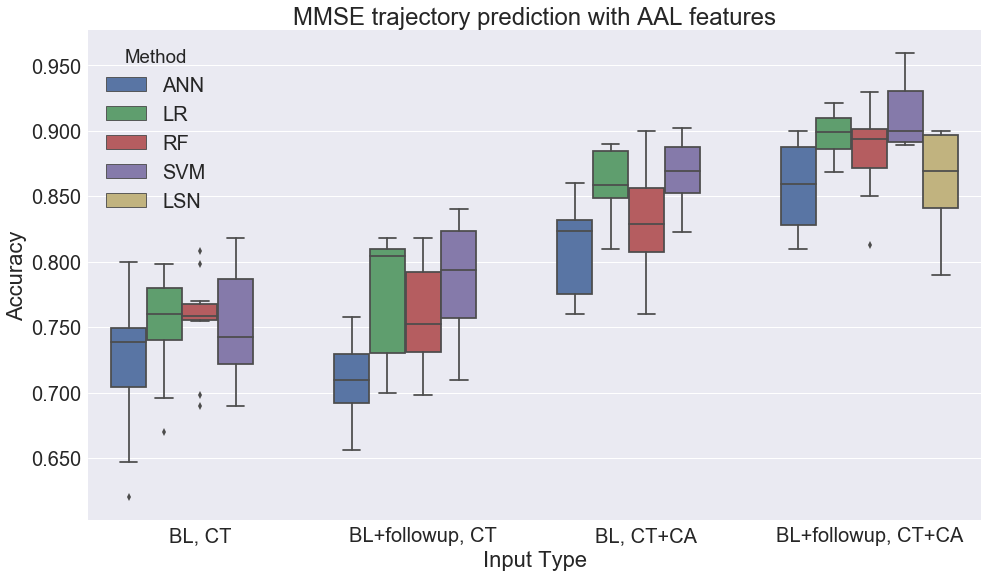

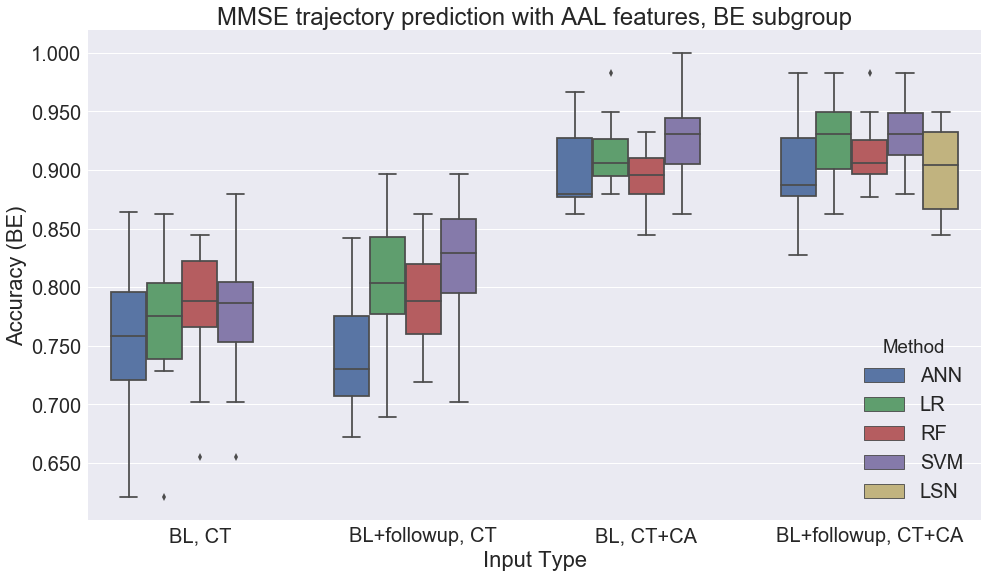

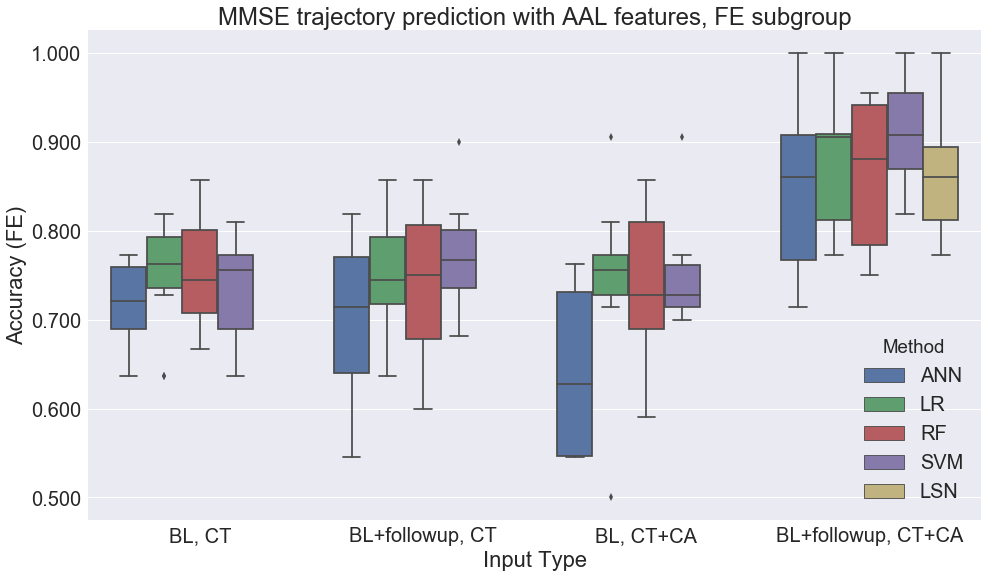

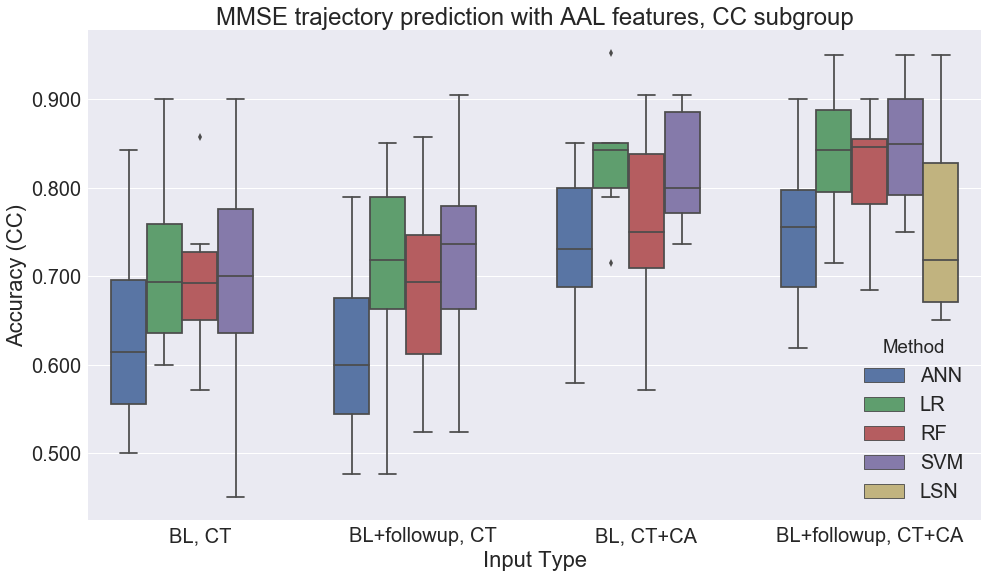

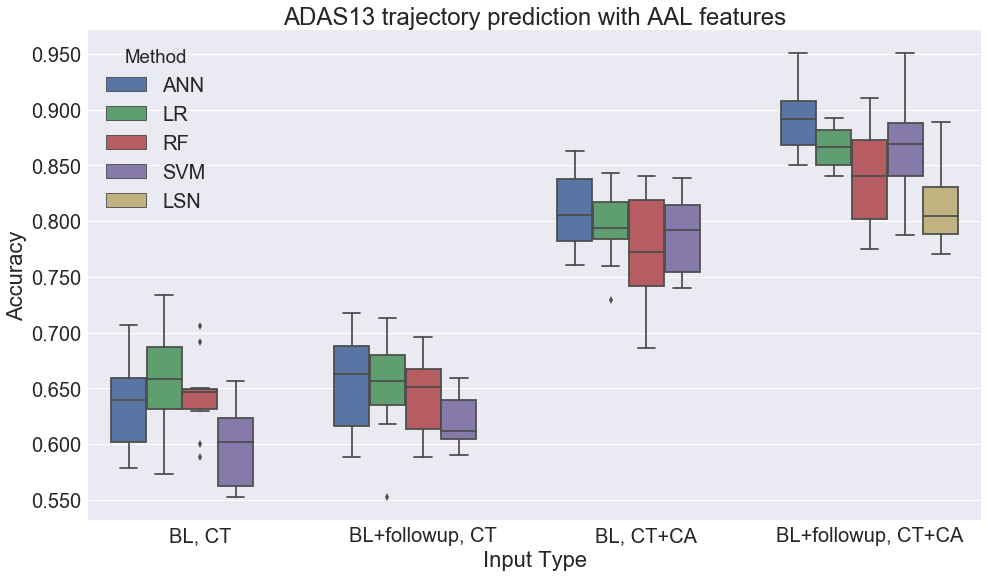

...

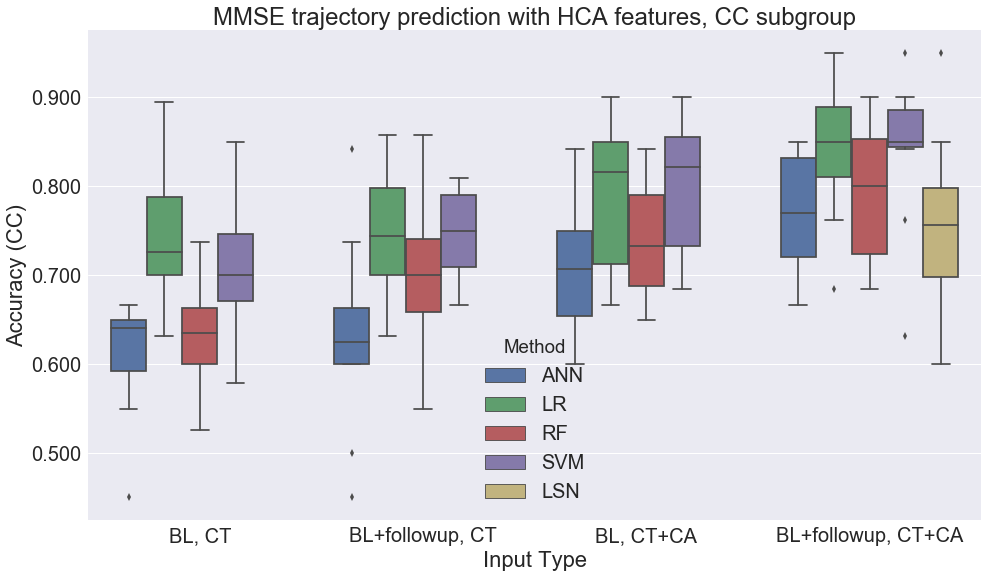

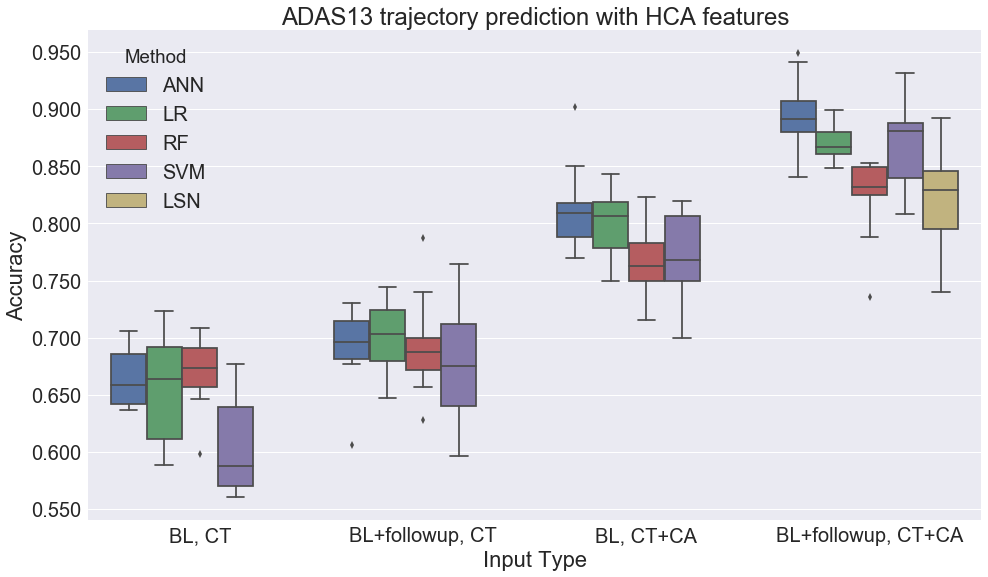

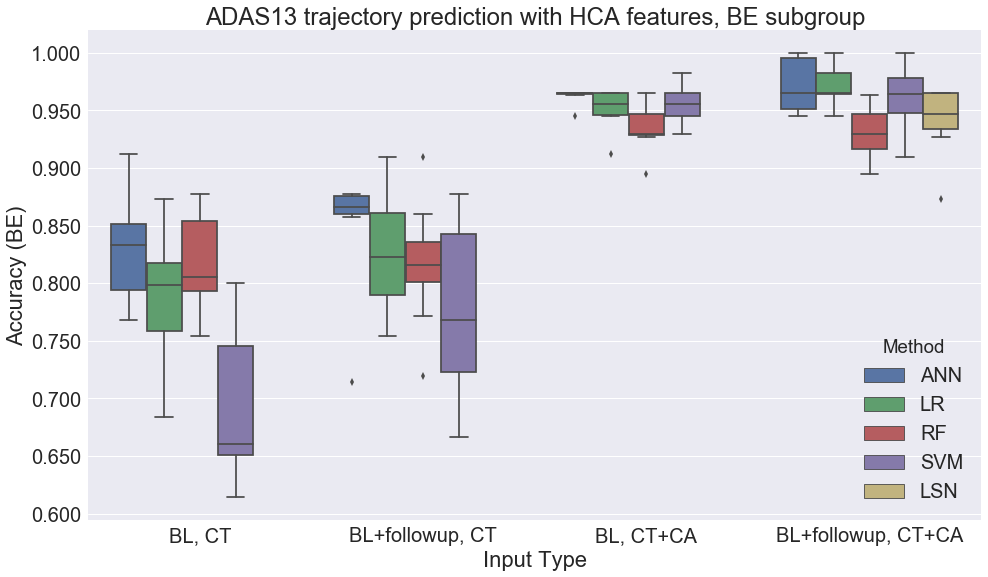

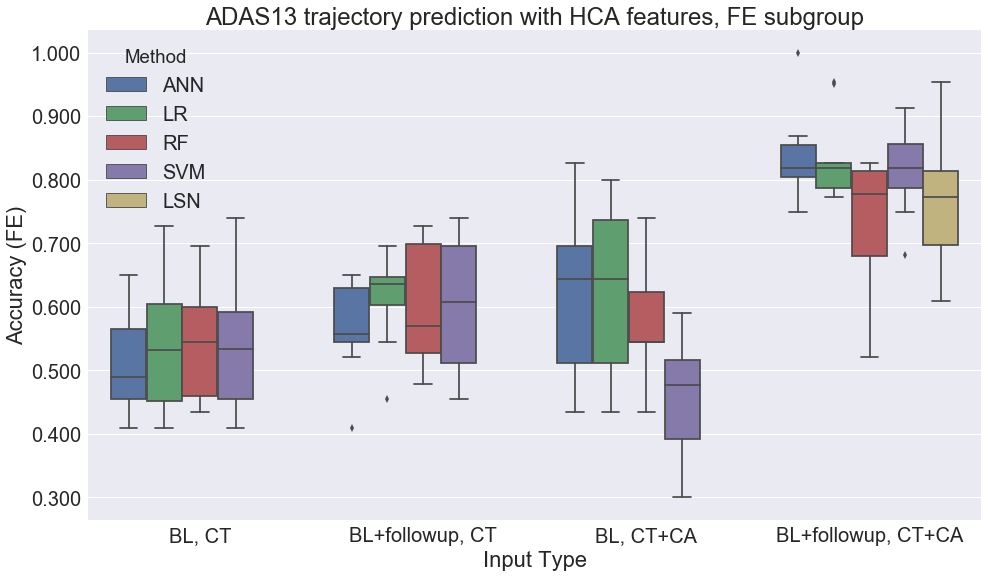

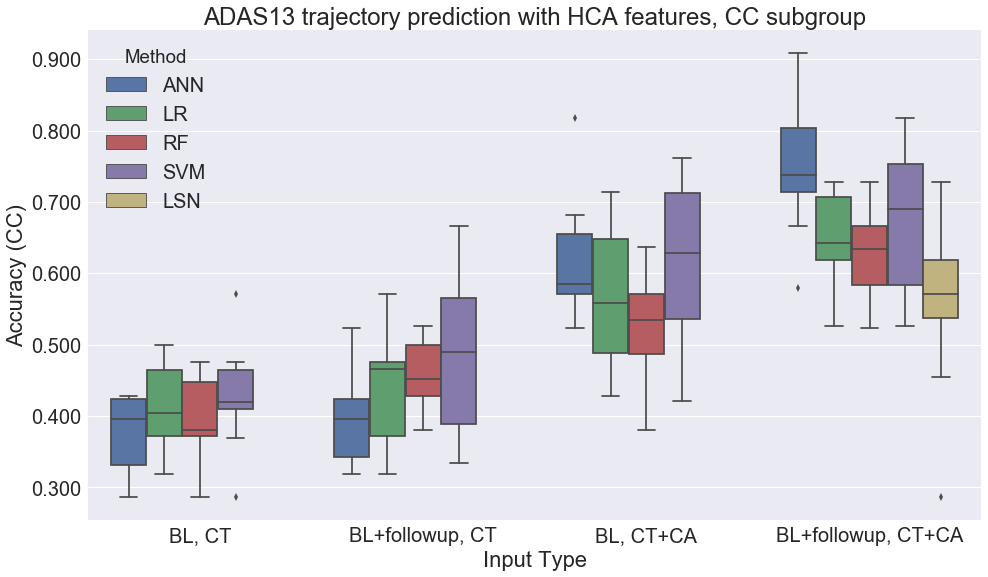

In [6]:
# Look through the experimental conditions (accuracy), by feature type
for f in ["AAL", "PCA", "RFE", "RLR", "HCA"]:
    for t in ["MMSE", "ADAS13"]:
        plt.figure(figsize=(16,9))
        cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["FeatureType"] == f)]
        ax = sns.boxplot(x="Input Type", y="Accuracy", hue="Method", data=cur_df, order=choices)
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with {} features".format(t, f))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_acc_boxplot.png".format(t, f))
        
        for sg in ["BE", "FE", "CC"]:
            plt.figure(figsize=(16,9))
            ax = sns.boxplot(x="Input Type", y="Accuracy ({})".format(sg), 
                             hue="Method", data=cur_df, order=choices)
            ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
            plt.title("{} trajectory prediction with {} features, {} subgroup".format(t, f, sg))
            plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_acc_boxplot.png".format(t, f, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


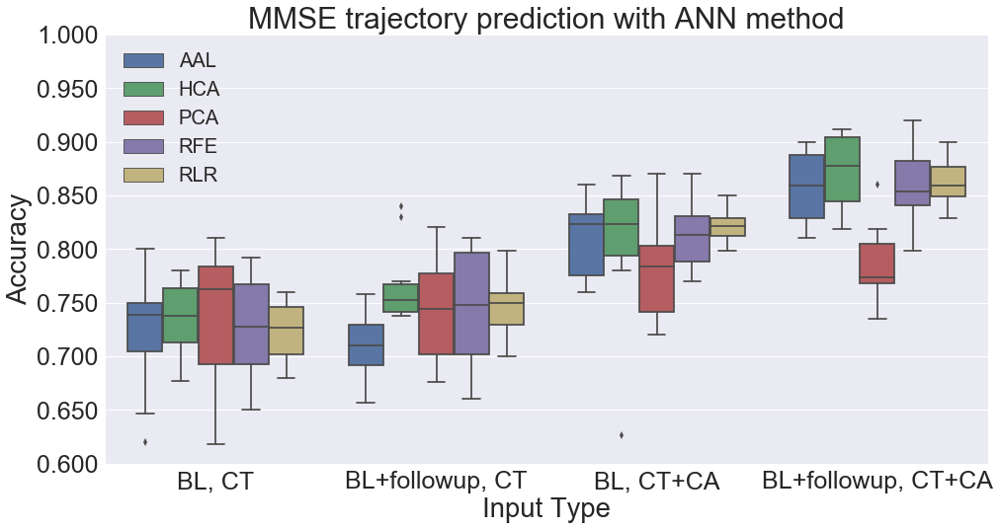

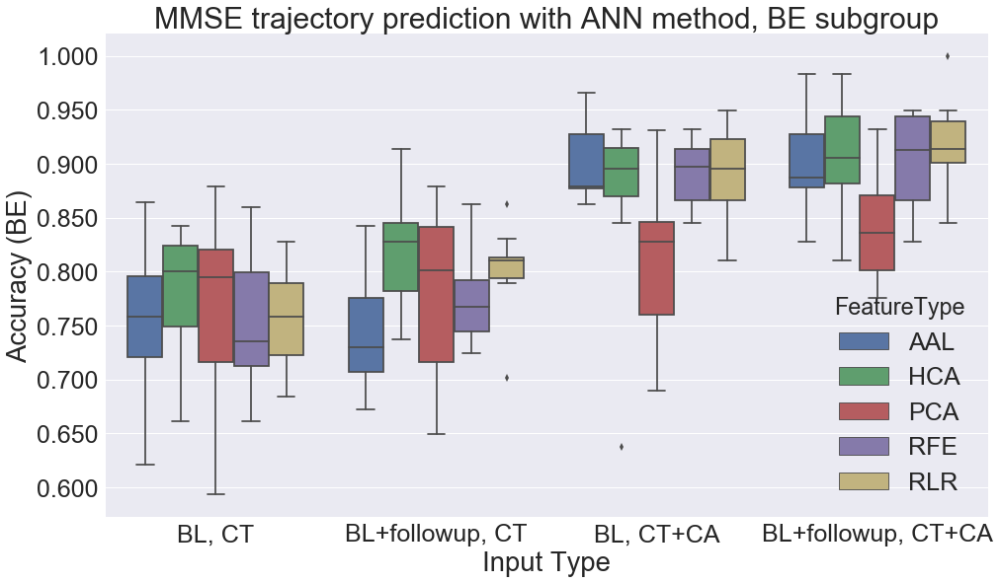

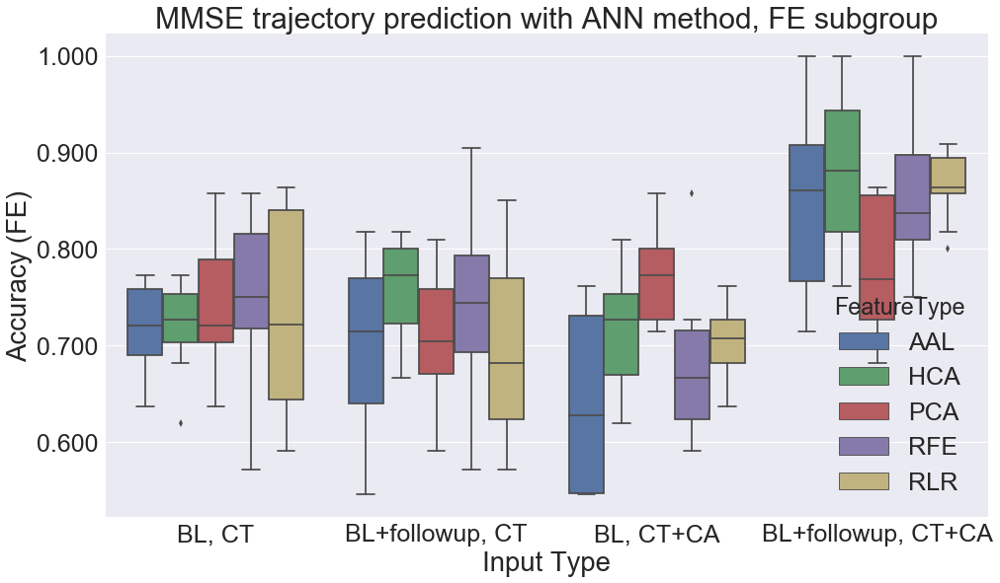

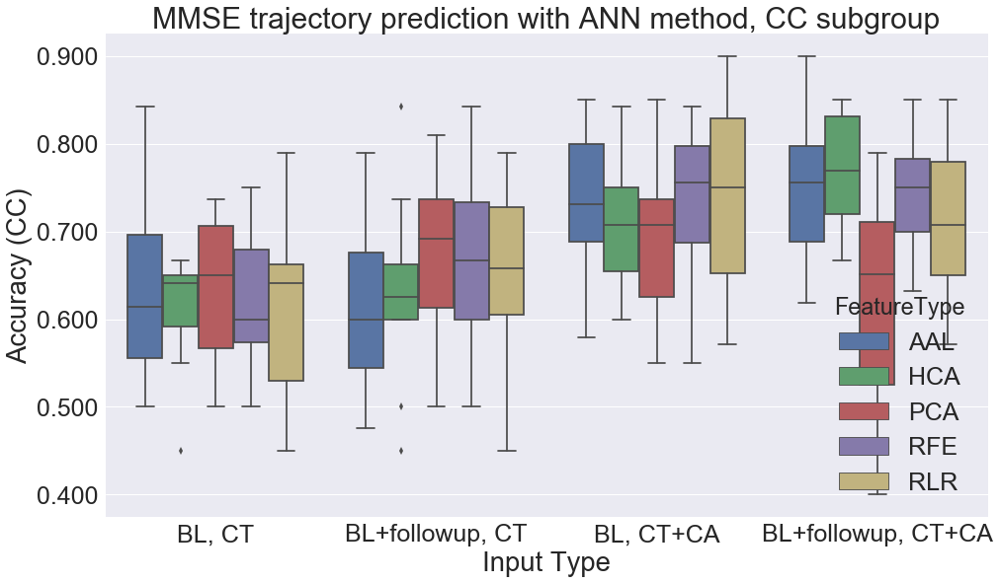

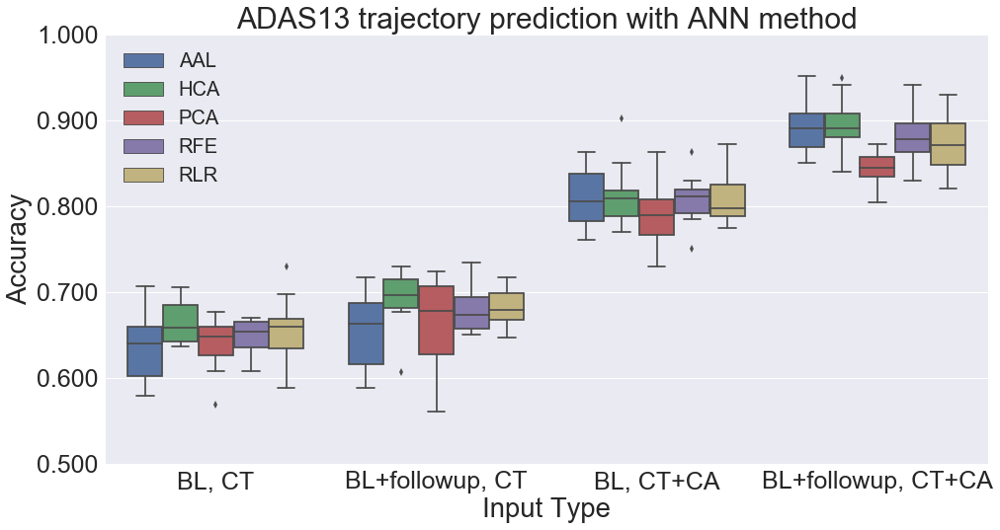

...

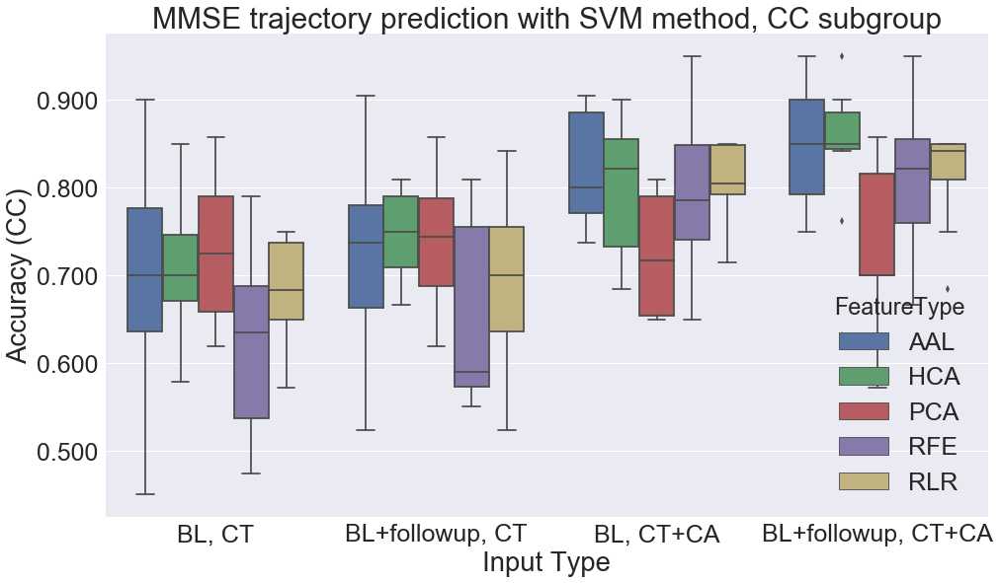

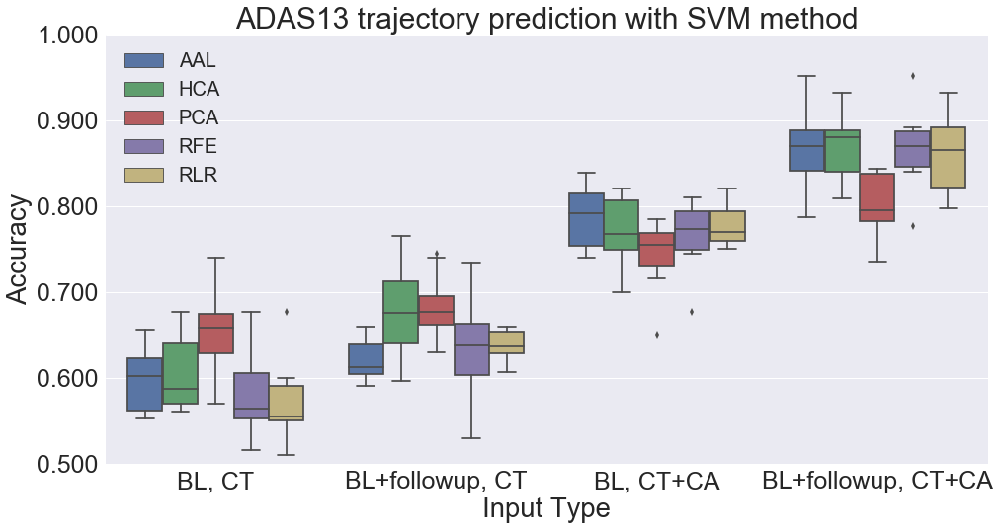

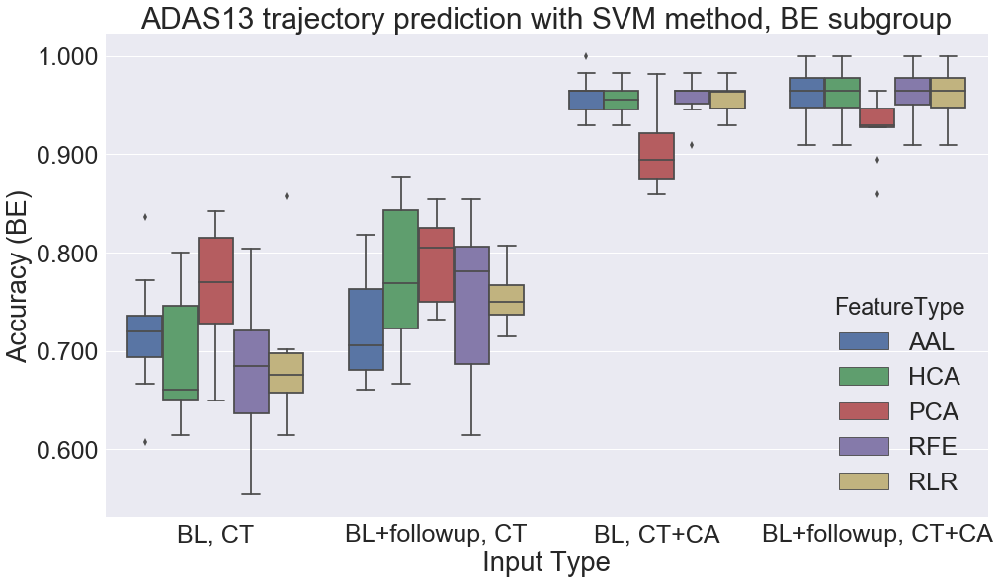

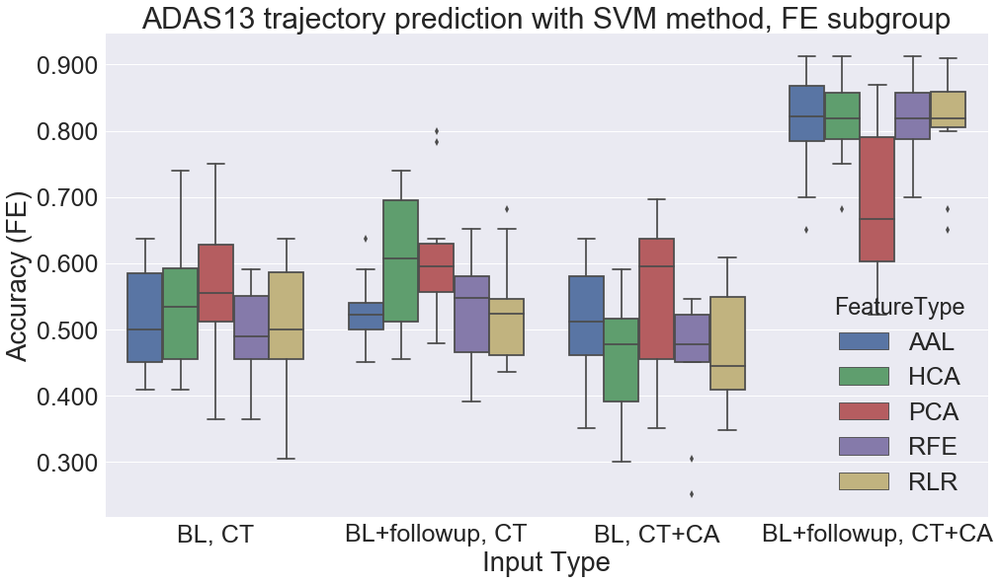

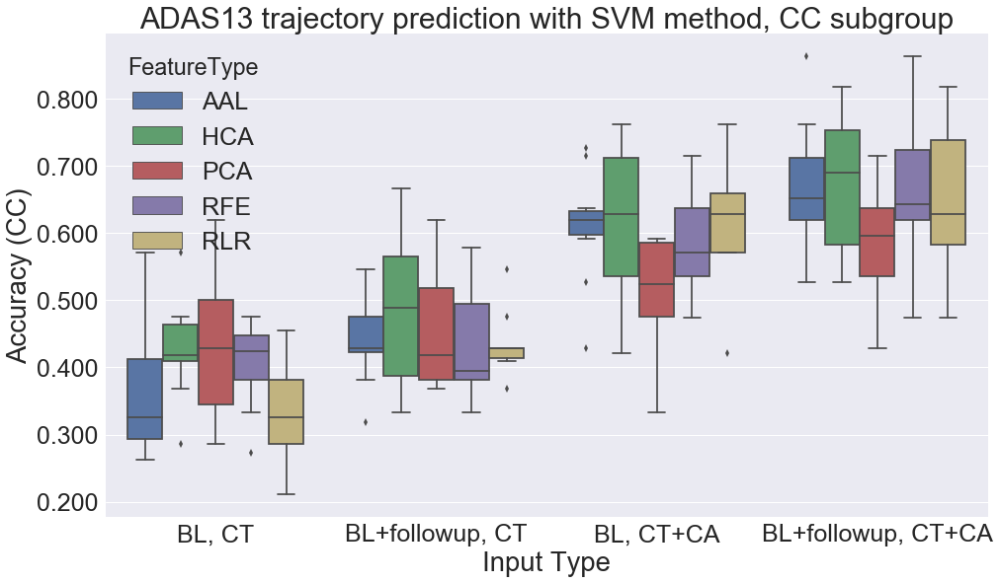

In [23]:
# Accuracy boxplots by method, at feature type
for m in ["ANN", "LR", "LSN", "RF", "SVM"]:
    for t in ["MMSE", "ADAS13"]:
        plt.figure(figsize=(16,8))
        cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["Method"] == m) & 
                            (new_df["FeatureType"] != "None")]
        if m == "LSN":
            ax = sns.boxplot(x="Input Type", hue="FeatureType", y="Accuracy", data=cur_df)
            if t == 'MMSE':
                plt.ylim(0.700, 0.950)
            else:
                plt.ylim(0.700, 0.950)
            plt.legend(loc='lower right', fontsize=20)
        else:
            ax = sns.boxplot(x="Input Type", y="Accuracy", hue="FeatureType", data=cur_df, order=choices)
            if t == 'MMSE':
                plt.ylim(0.600, 1.000)
            if t == 'ADAS13':
                plt.ylim(0.500, 1.000)
            plt.legend(fontsize=20)
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with {} method".format(t, m))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_acc_boxplot.png".format(t, m))
        
        for sg in ["BE", "FE", "CC"]:
            plt.figure(figsize=(16,9))
            if m == "LSN":
                ax = sns.boxplot(x="Input Type", hue="FeatureType", y="Accuracy", data=cur_df)
            else:
                ax = sns.boxplot(x="Input Type", y="Accuracy ({})".format(sg), 
                                 hue="FeatureType", data=cur_df, order=choices)
            ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
            plt.title("{} trajectory prediction with {} method, {} subgroup".format(t, m, sg))
            plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_acc_boxplot.png".format(t, m, sg))

In [34]:
# Do statistical testing of the differences between method
for t in ['MMSE', 'ADAS13']:
    for m in ['ANN', 'LR', 'LSN', 'RF', 'SVM']:
        cur_df = new_df.loc[(new_df['Trajectory'] == t) & (new_df['Method'] == m) & 
                            (new_df['Input Type'] == 'BL+followup, CT+CA')]
        ftypes = ['AAL', 'HCA', 'PCA', 'RLR', 'RFE']
        for index, f1 in enumerate(ftypes):
            for f2 in ftypes[index+1:]:
                d1 = cur_df.loc[cur_df['FeatureType'] == f1]['Accuracy'].values
                d2 = cur_df.loc[cur_df['FeatureType'] == f2]['Accuracy'].values
                stat, pvalue = ss.mannwhitneyu(d1, d2)
                print(t, m, f1, f2, np.mean(d1) > np.mean(d2), pvalue)

MMSE ANN AAL HCA False 0.15347164132338348
MMSE ANN AAL PCA True 0.0007402258157459122
MMSE ANN AAL RLR False 0.3520910379930105
MMSE ANN AAL RFE False 0.4101317169549247
MMSE ANN HCA PCA True 0.0003317411793835479
MMSE ANN HCA RLR True 0.27244787233428047
MMSE ANN HCA RFE True 0.27229618885787615
MMSE ANN PCA RLR False 0.0004908257849789461
MMSE ANN PCA RFE False 0.0008462787843324666
MMSE ANN RLR RFE True 0.33833298717632176
MMSE LR AAL HCA False 0.284720574084564
MMSE LR AAL PCA True 0.0035875494681272837
MMSE LR AAL RLR False 0.3109975407743625
MMSE LR AAL RFE True 0.28486656013661105
MMSE LR HCA PCA True 0.006901889729060753
MMSE LR HCA RLR True 0.43964375687067536
MMSE LR HCA RFE True 0.20168556530863974
MMSE LR PCA RLR False 0.004997887079527249
MMSE LR PCA RFE False 0.009330379662243806
MMSE LR RLR RFE True 0.297517575814569
MMSE LSN AAL HCA True 0.4101650314376629
MMSE LSN AAL PCA True 0.09921341264165767
MMSE LSN AAL RLR True 0.35262282221604296
MMSE LSN AAL RFE True 0.213416

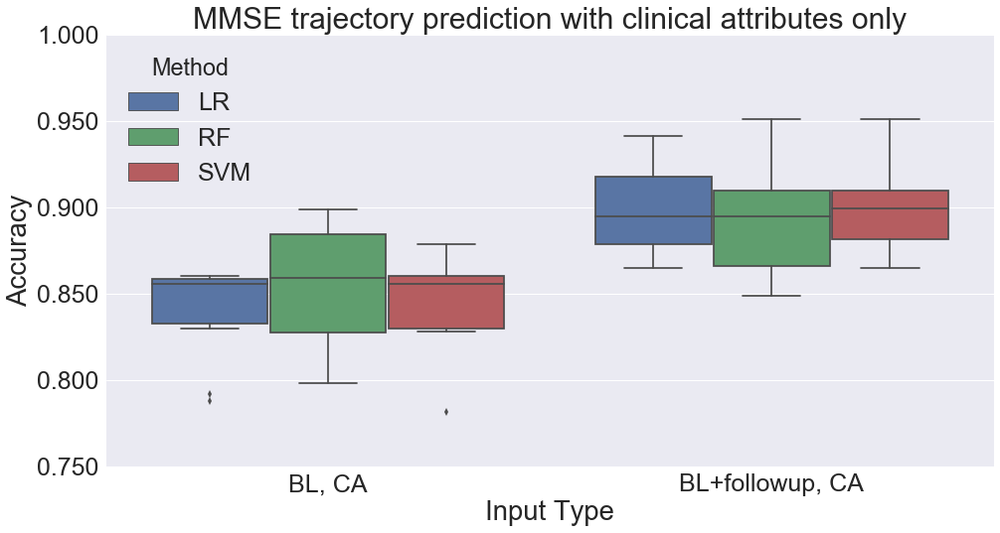

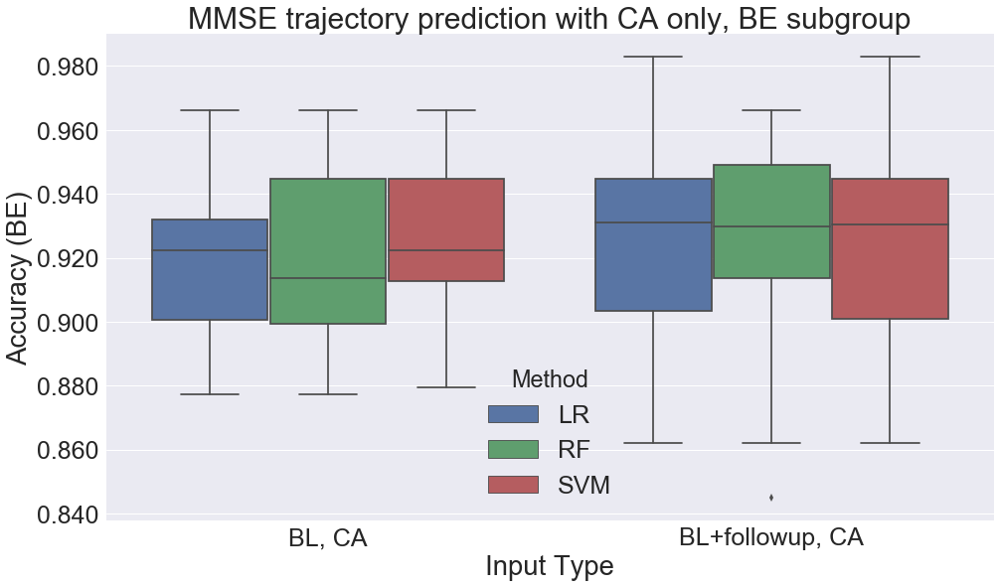

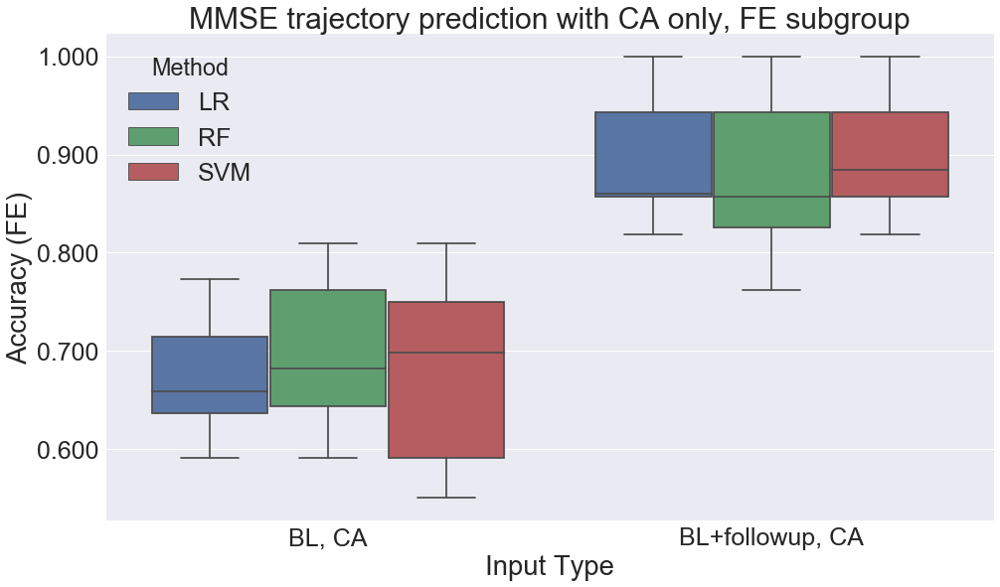

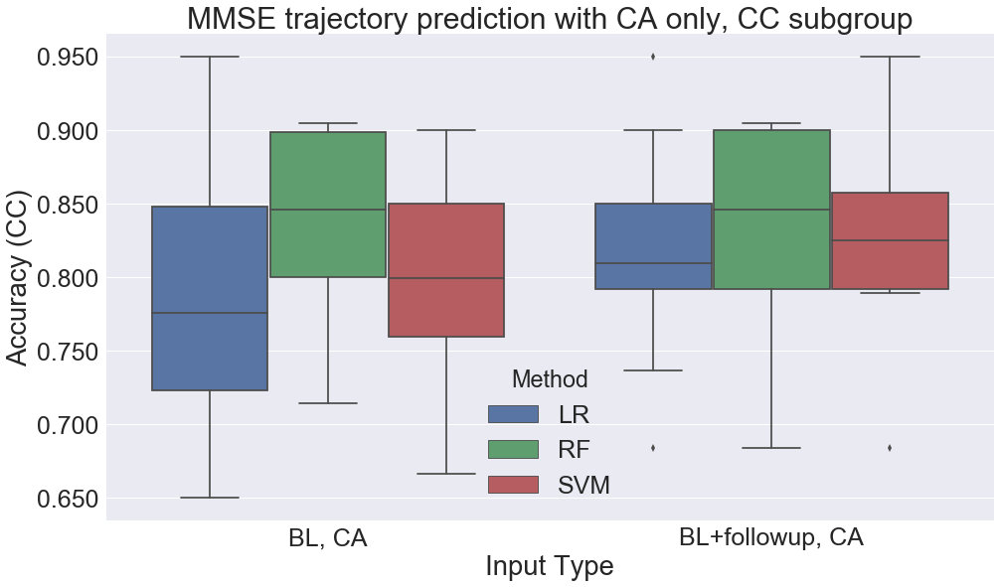

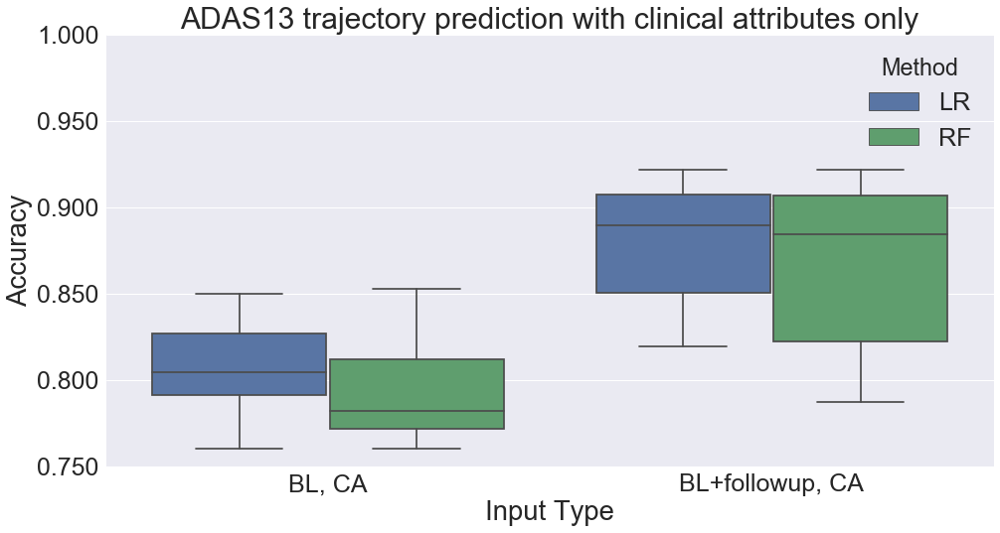

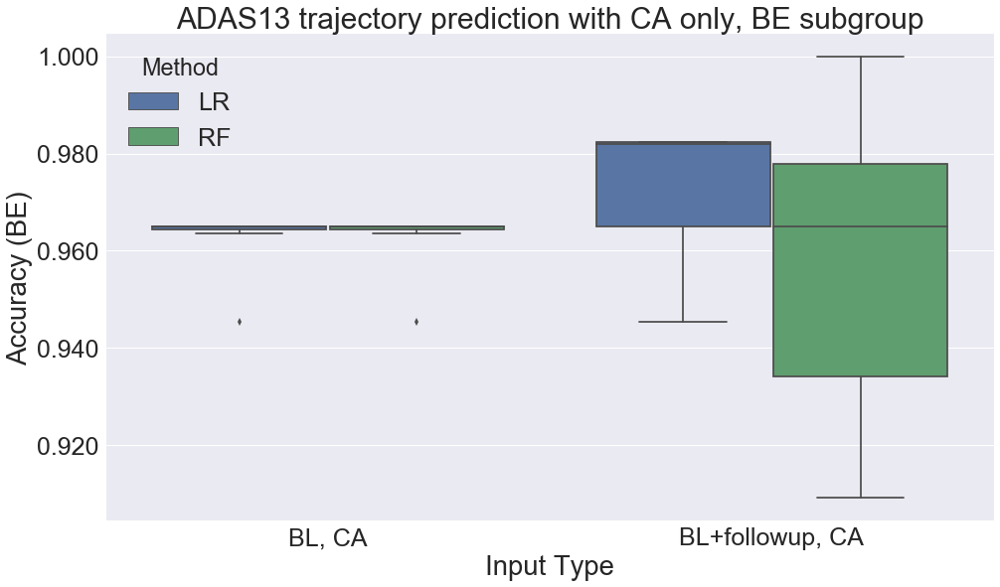

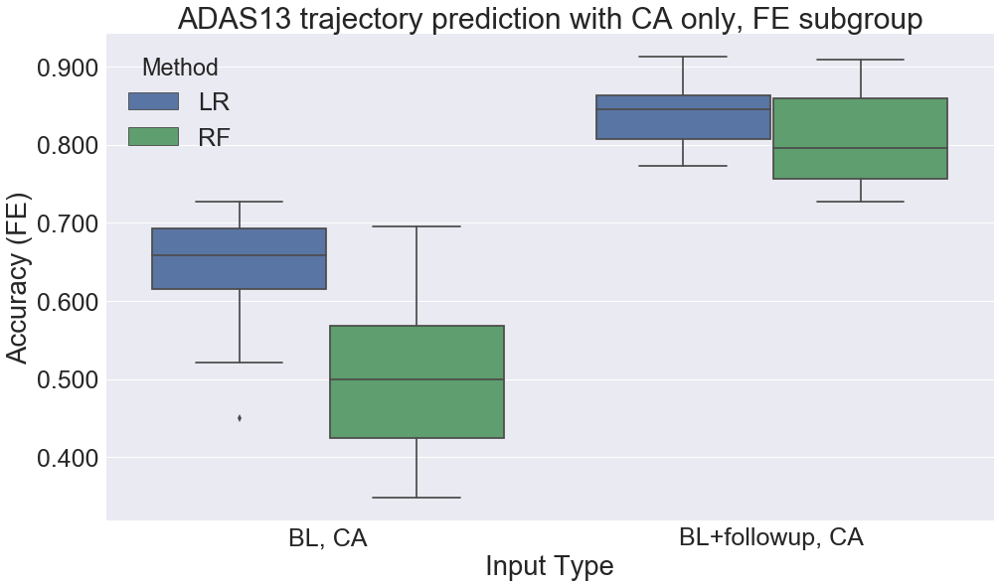

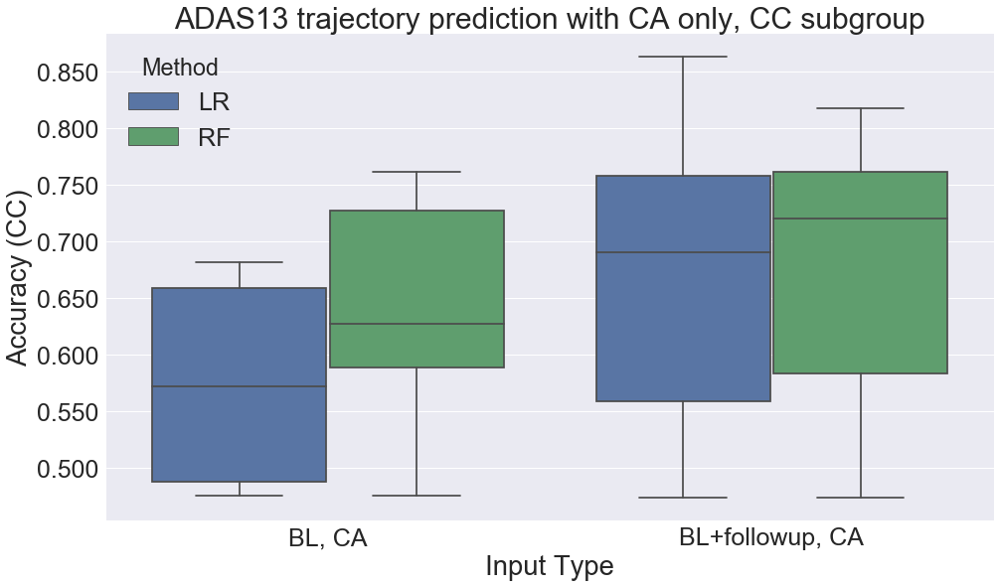

In [11]:
# Plot the accuracy with clinical attributes only
for t in ["MMSE", "ADAS13"]:
    plt.figure(figsize=(16,8))
    cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["FeatureType"] == "None")]
    ax = sns.boxplot(x="Input Type", y="Accuracy", hue="Method", data=cur_df, 
                     order=["BL, CA", "BL+followup, CA"])
    plt.ylim(0.750, 1.000)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    plt.title("{} trajectory prediction with clinical attributes only".format(t))
    plt.savefig("plots/Exp_Mar18_grid_search/{}_CA-only_acc_boxplot.png".format(t))
    
    for sg in ["BE", "FE", "CC"]:
        plt.figure(figsize=(16,9))
        ax = sns.boxplot(x="Input Type", y="Accuracy ({})".format(sg), hue="Method", 
                         data=cur_df, order=["BL, CA", "BL+followup, CA"])
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with CA only, {} subgroup".format(t, sg))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_CA-only_acc_boxplot.png".format(t, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


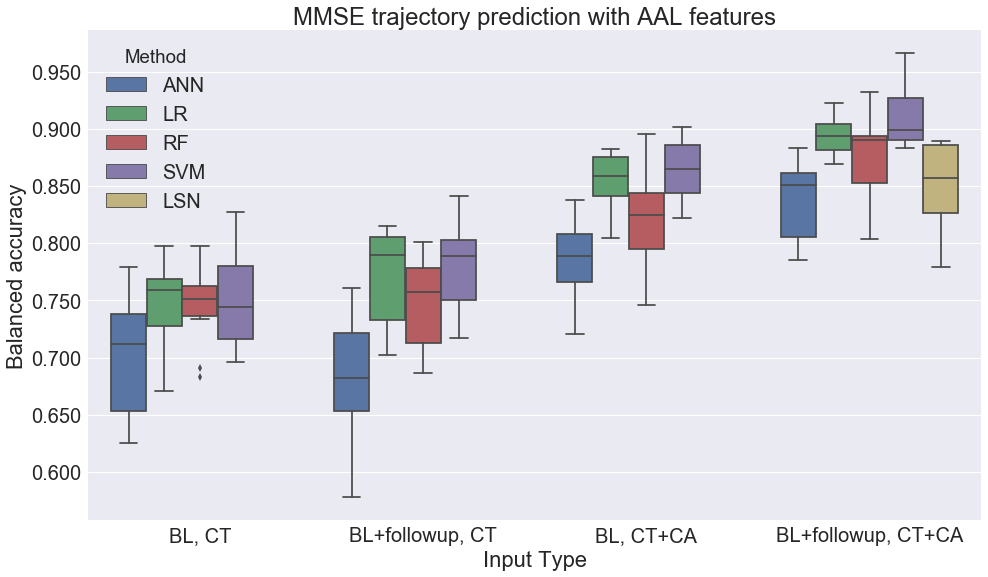

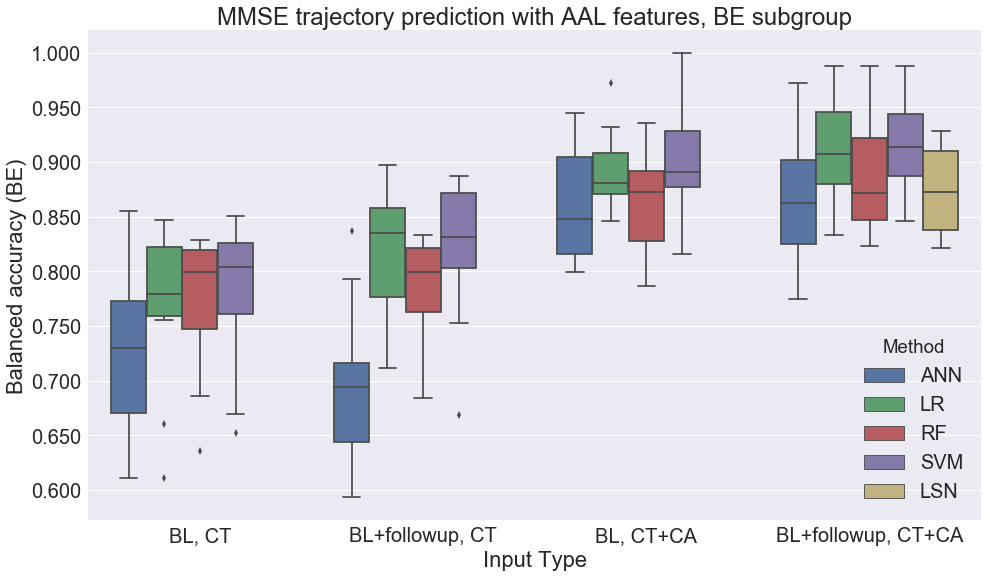

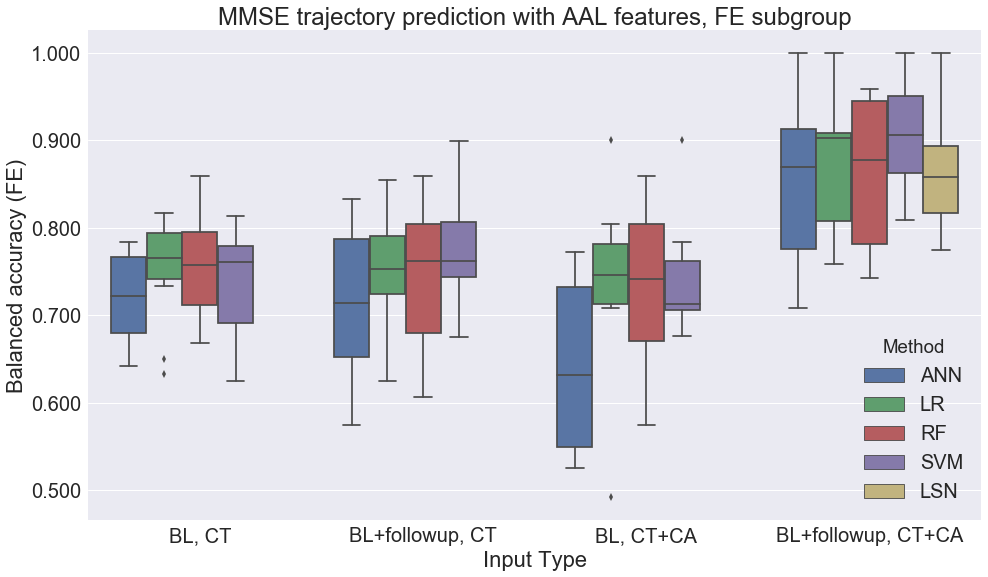

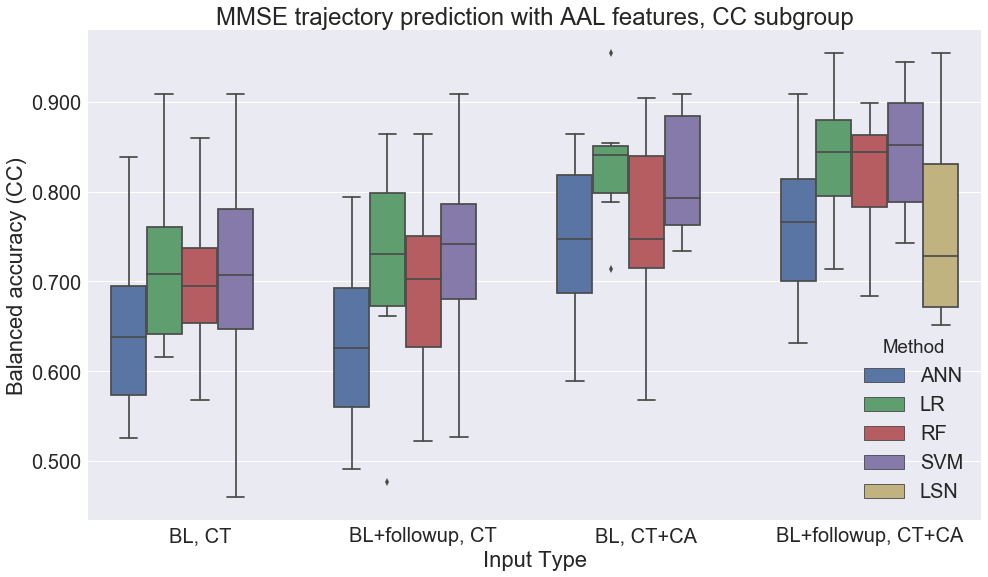

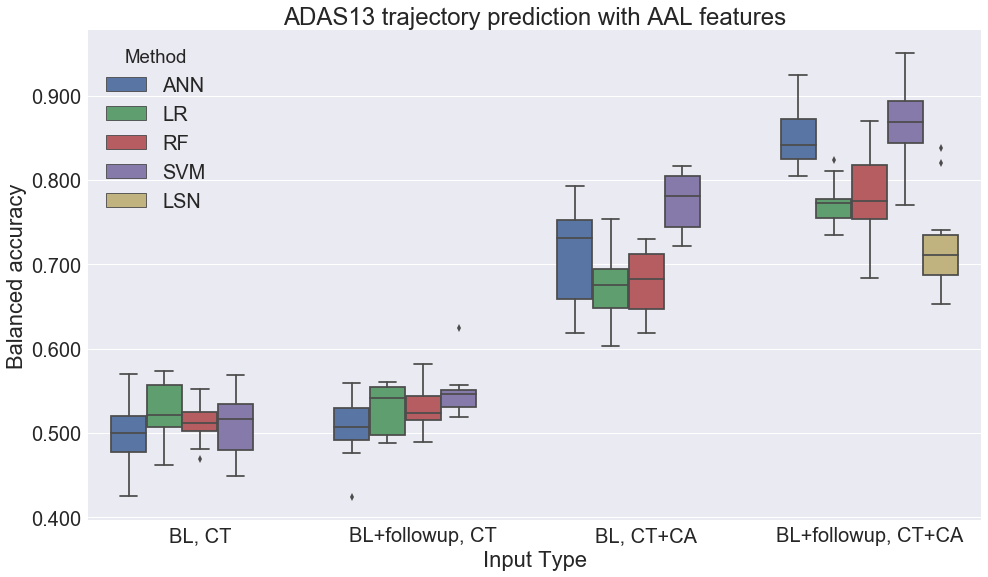

...

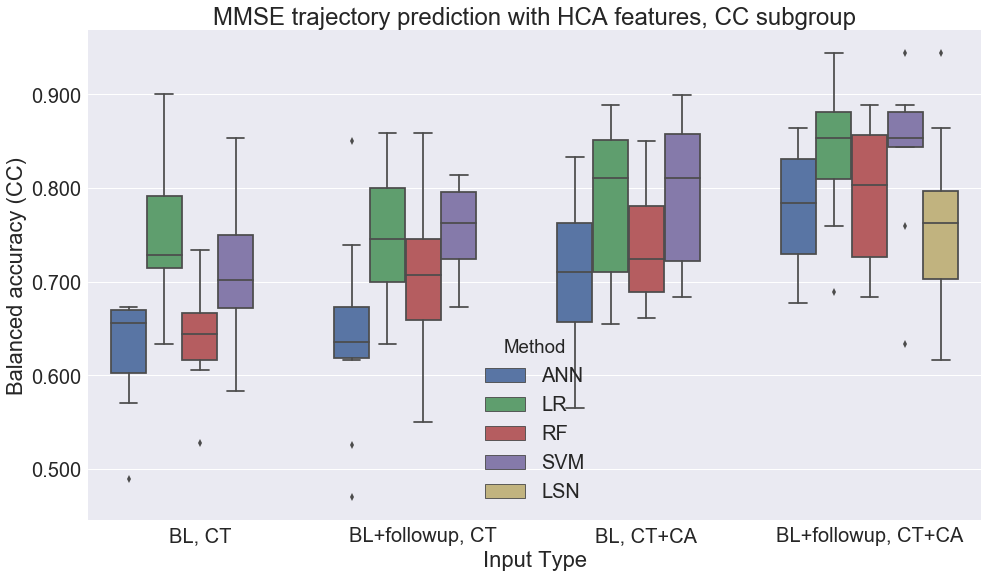

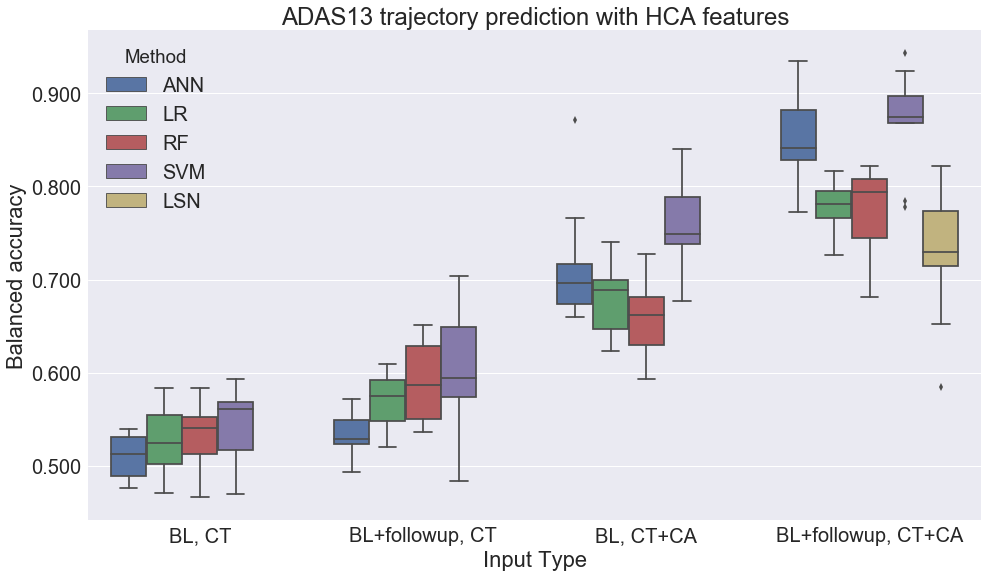

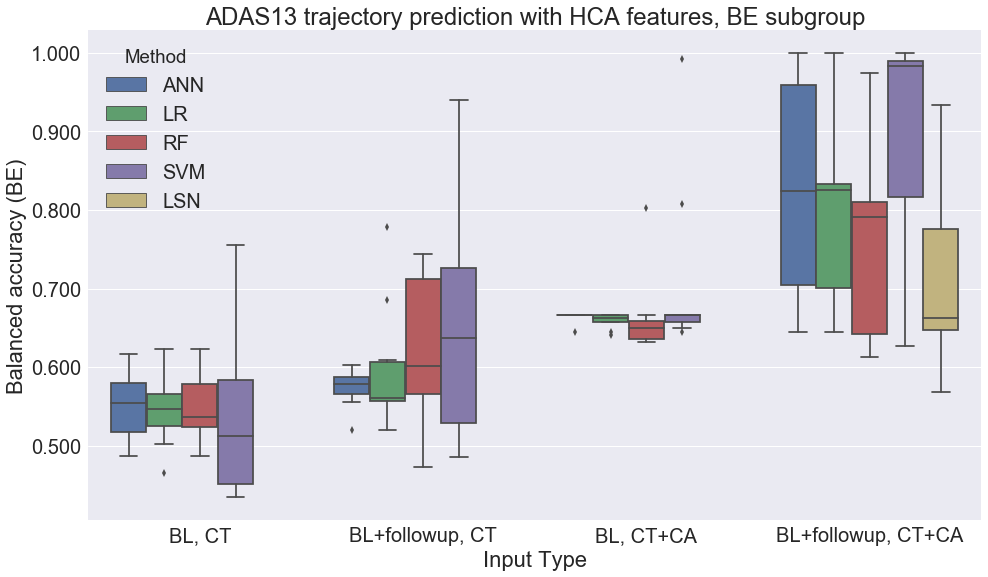

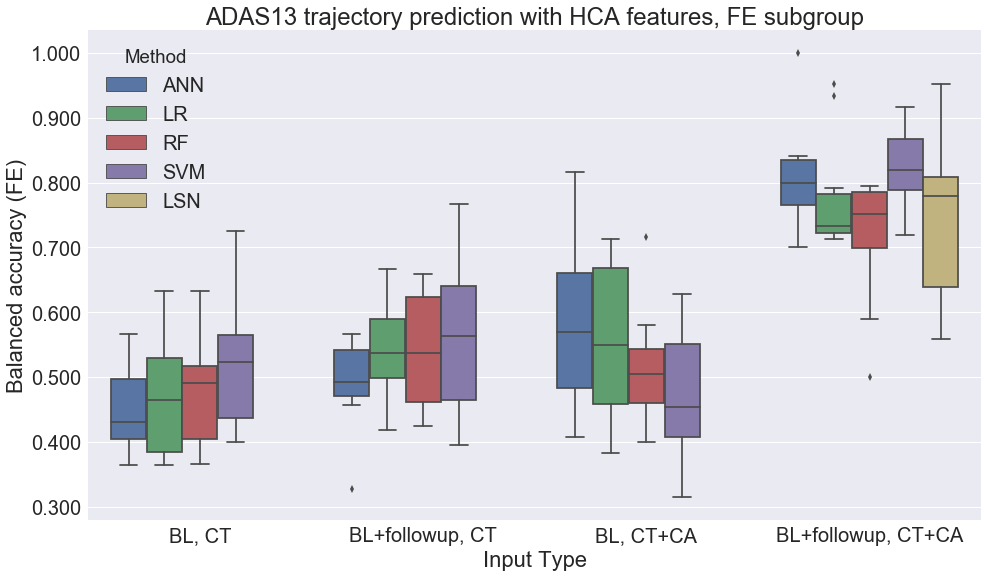

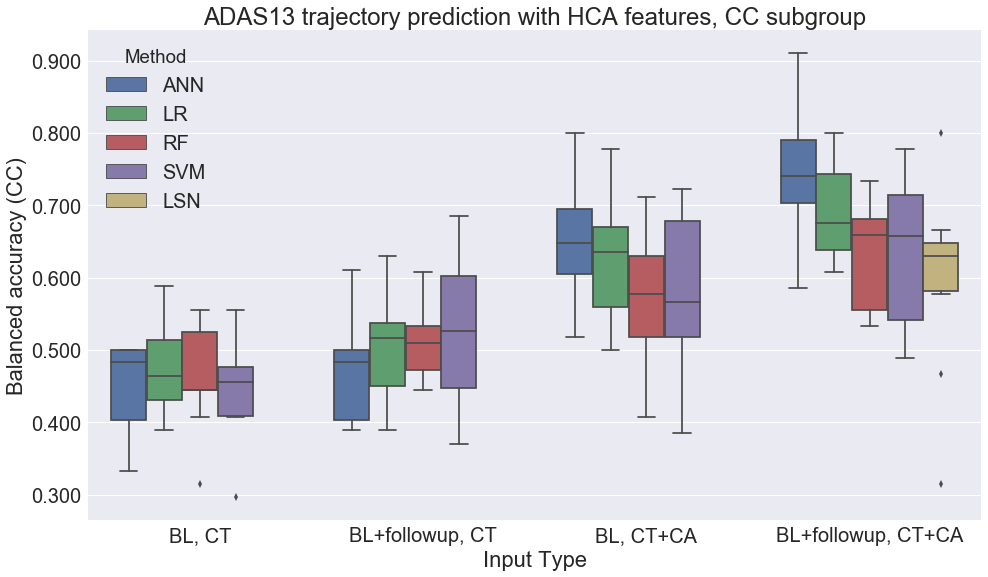

In [10]:
# Look through the experimental conditions (balanced accuracy)
for f in ["AAL", "PCA", "RFE", "RLR", "HCA"]:
    for t in ["MMSE", "ADAS13"]:
        plt.figure(figsize=(16,9))
        cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["FeatureType"] == f)]
        ax = sns.boxplot(x="Input Type", y="Balanced accuracy", hue="Method", data=cur_df, order=choices)
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with {} features".format(t, f))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_bacc_boxplot.png".format(t, f))
        
        for sg in ["BE", "FE", "CC"]:
            plt.figure(figsize=(16,9))
            ax = sns.boxplot(x="Input Type", y="Balanced accuracy ({})".format(sg), 
                             hue="Method", data=cur_df, order=choices)
            ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
            plt.title("{} trajectory prediction with {} features, {} subgroup".format(t, f, sg))
            plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_bacc_boxplot.png".format(t, f, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


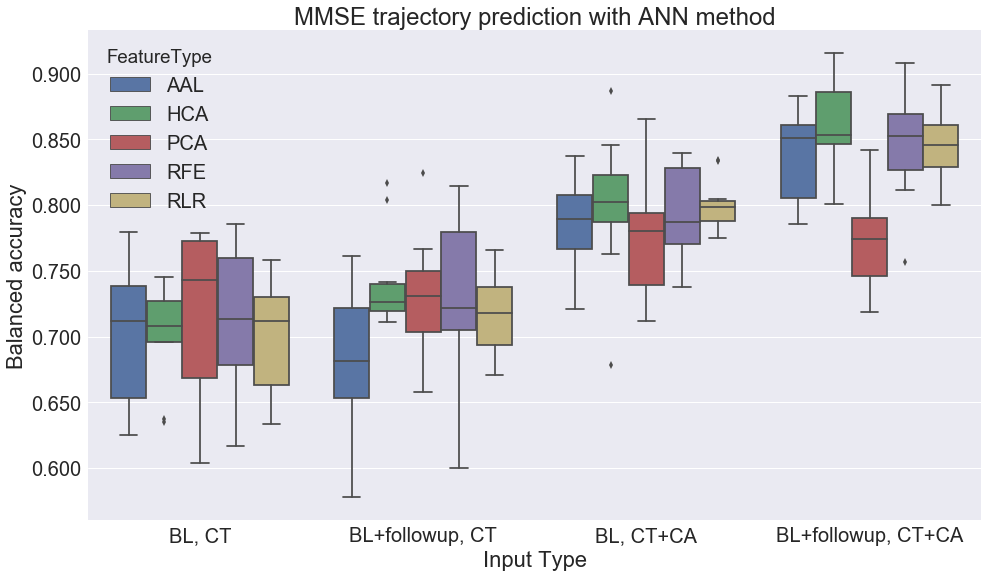

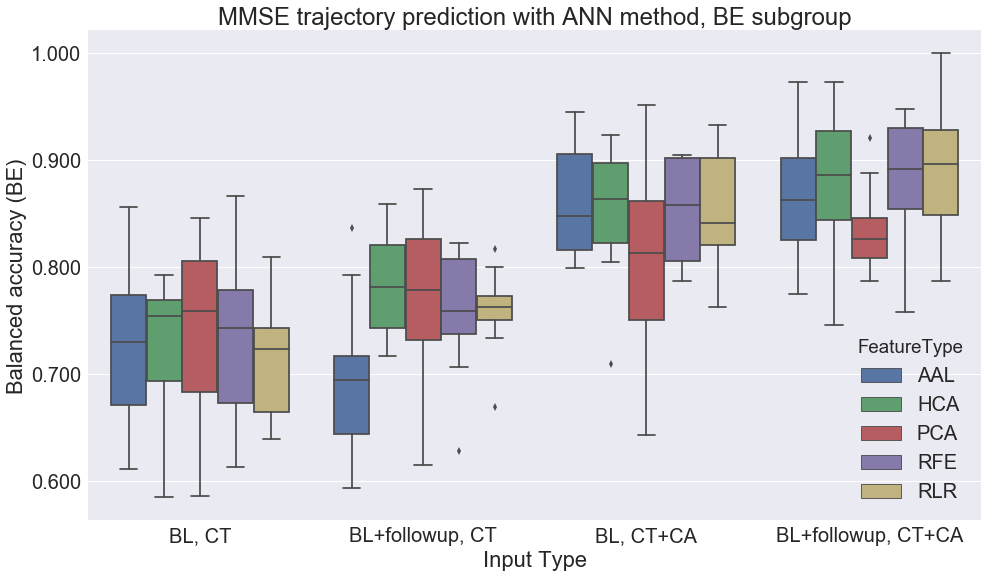

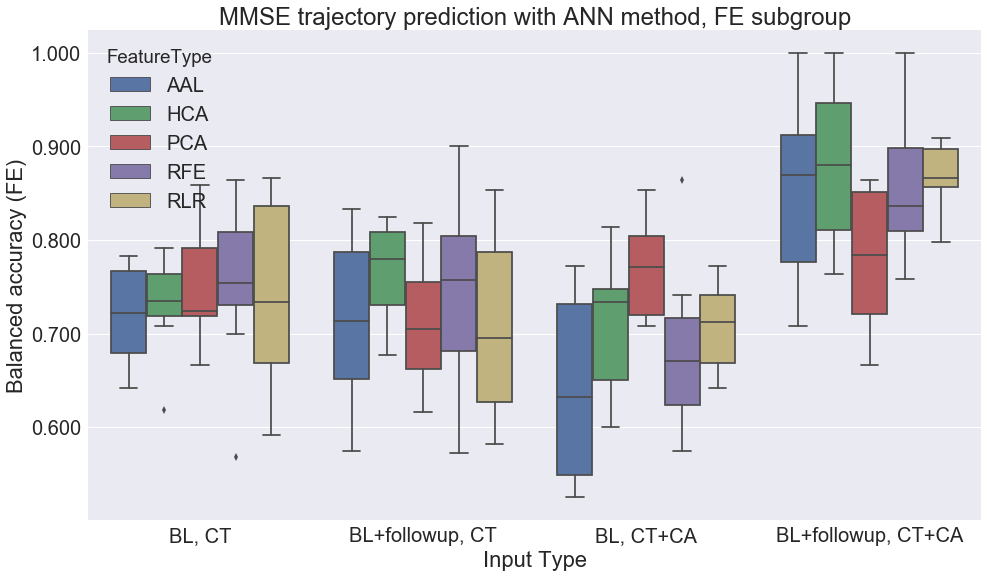

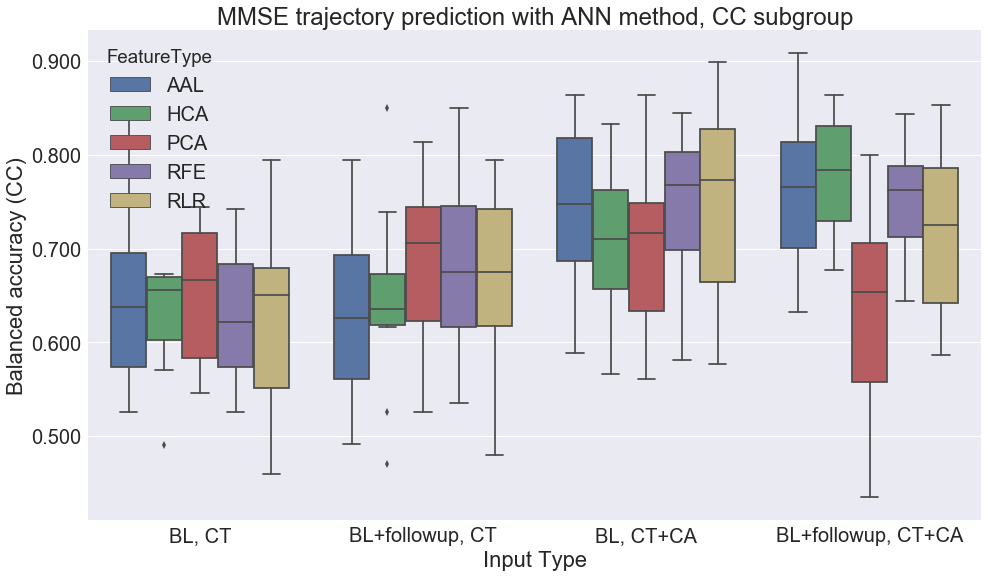

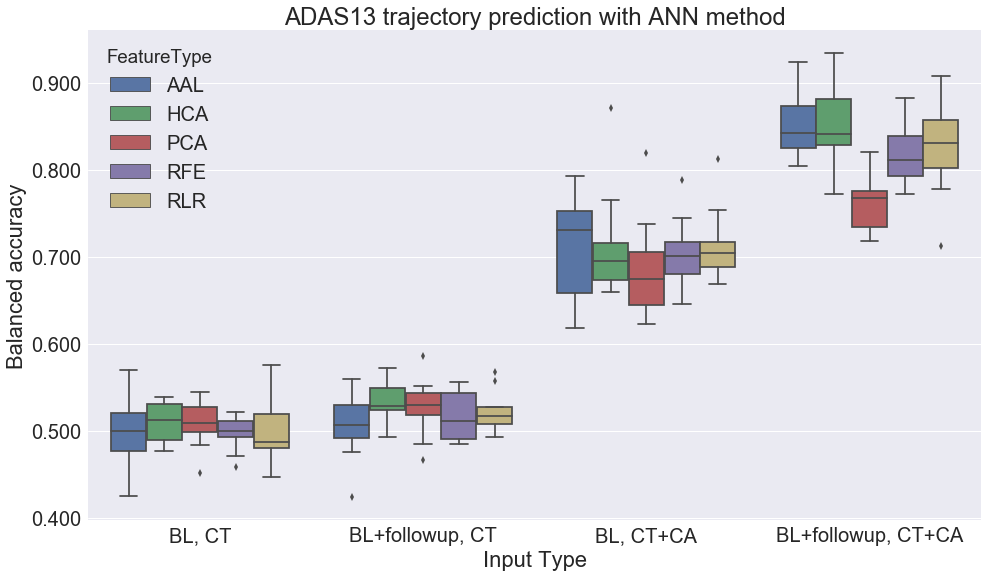

...

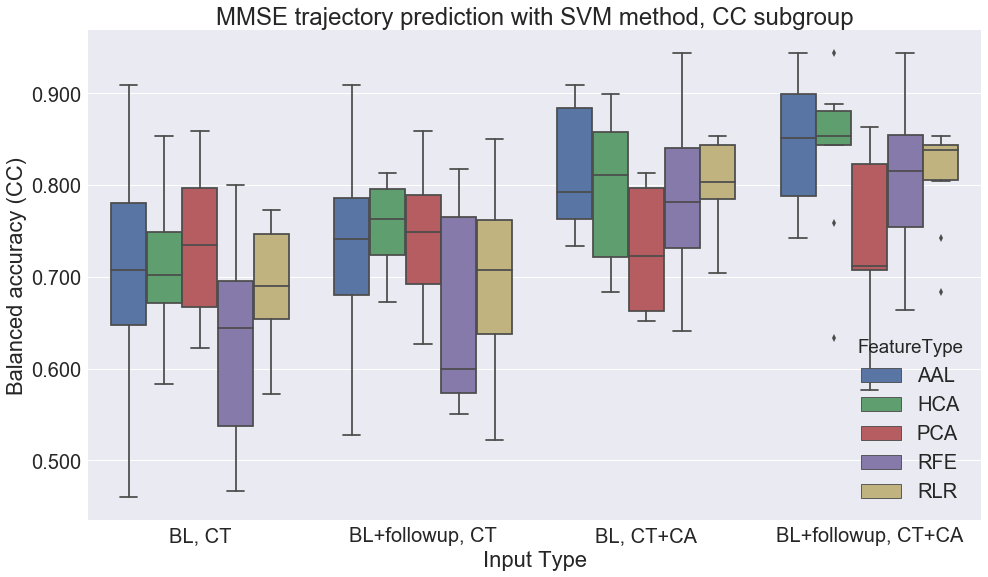

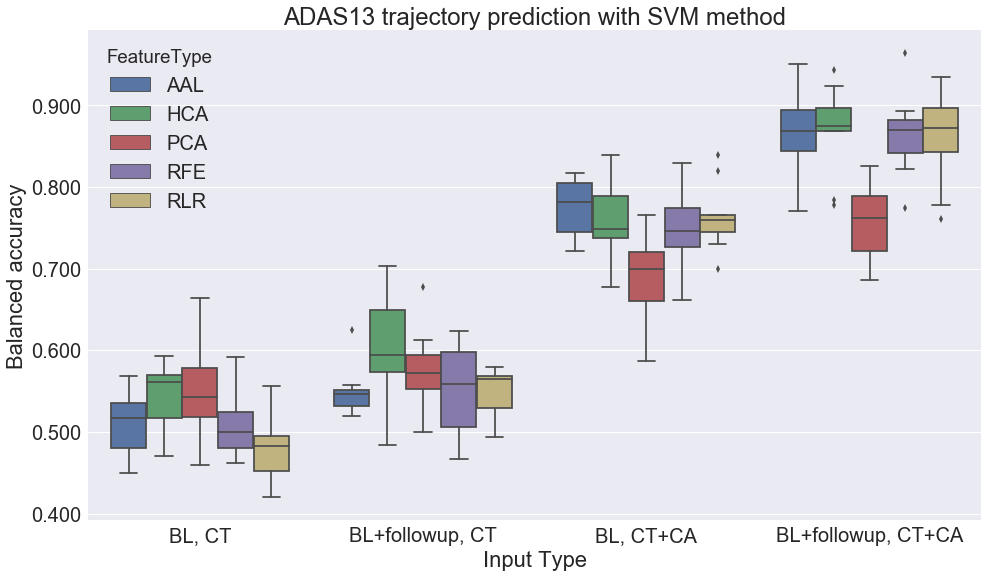

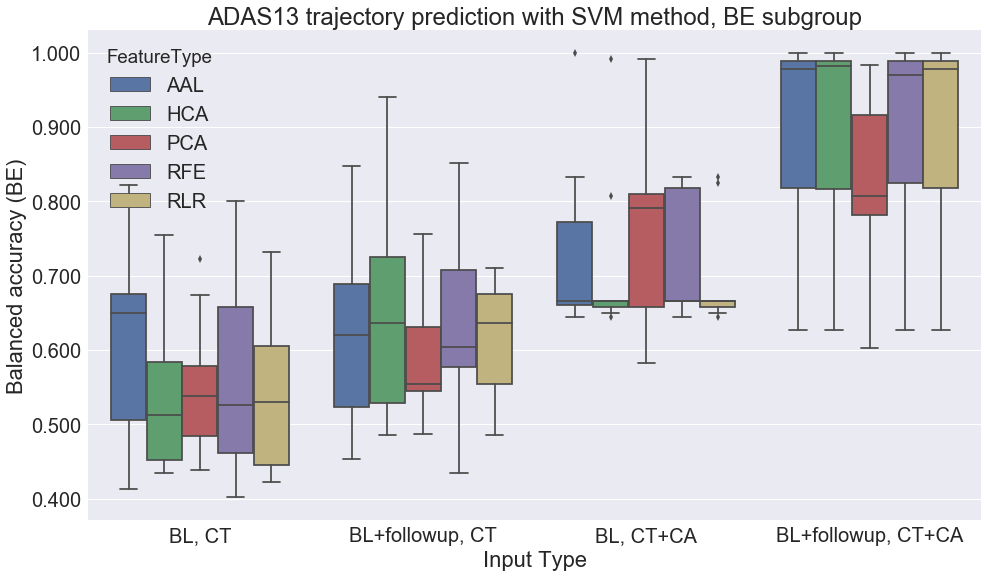

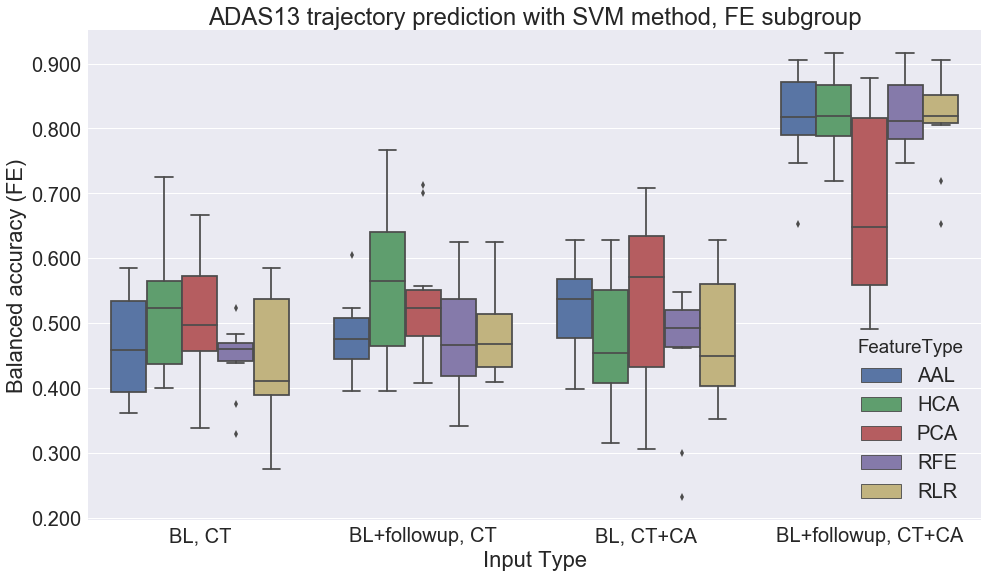

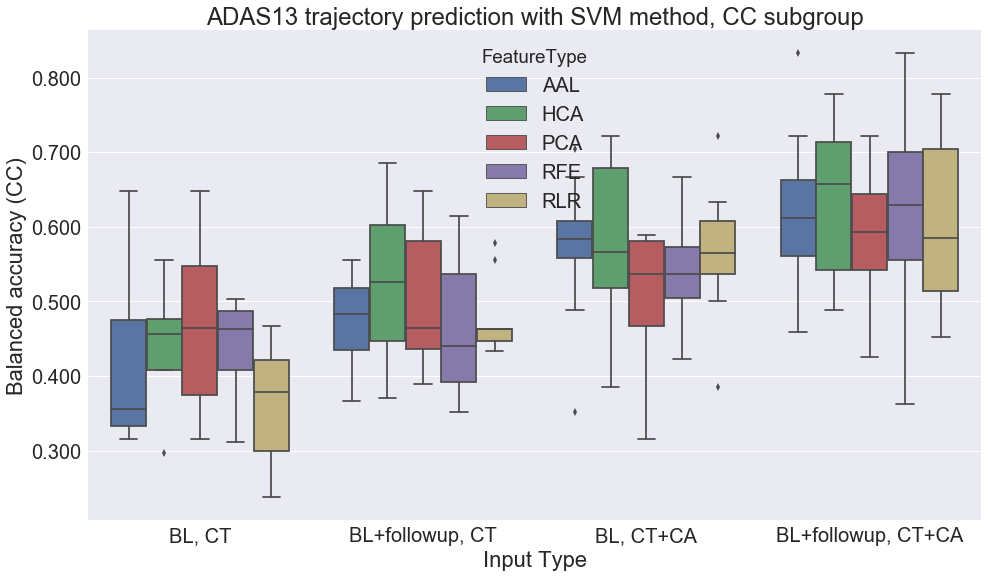

In [23]:
# Balanced accuracy boxplots by method, at feature type
for m in ["ANN", "LR", "LSN", "RF", "SVM"]:
    for t in ["MMSE", "ADAS13"]:
        plt.figure(figsize=(16,9))
        cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["Method"] == m) & 
                            (new_df["FeatureType"] != "None")]
        if m == "LSN":
            ax = sns.boxplot(x="Input Type", hue="FeatureType", y="Balanced accuracy", data=cur_df)
            if t == 'MMSE':
                plt.ylim(0.760, 0.940)
            else:
                plt.ylim(0.600, 0.900)
            plt.legend(loc='lower right')
        else:
            ax = sns.boxplot(x="Input Type", y="Balanced accuracy", hue="FeatureType", data=cur_df, order=choices)
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with {} method".format(t, m))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_bacc_boxplot.png".format(t, m))
        
        for sg in ["BE", "FE", "CC"]:
            plt.figure(figsize=(16,9))
            if m == "LSN":
                ax = sns.boxplot(x="Input Type", hue="FeatureType", y="Balanced accuracy", data=cur_df)
            else:
                ax = sns.boxplot(x="Input Type", y="Balanced accuracy ({})".format(sg), 
                                 hue="FeatureType", data=cur_df, order=choices)
            ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
            plt.title("{} trajectory prediction with {} method, {} subgroup".format(t, m, sg))
            plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_bacc_boxplot.png".format(t, m, sg))

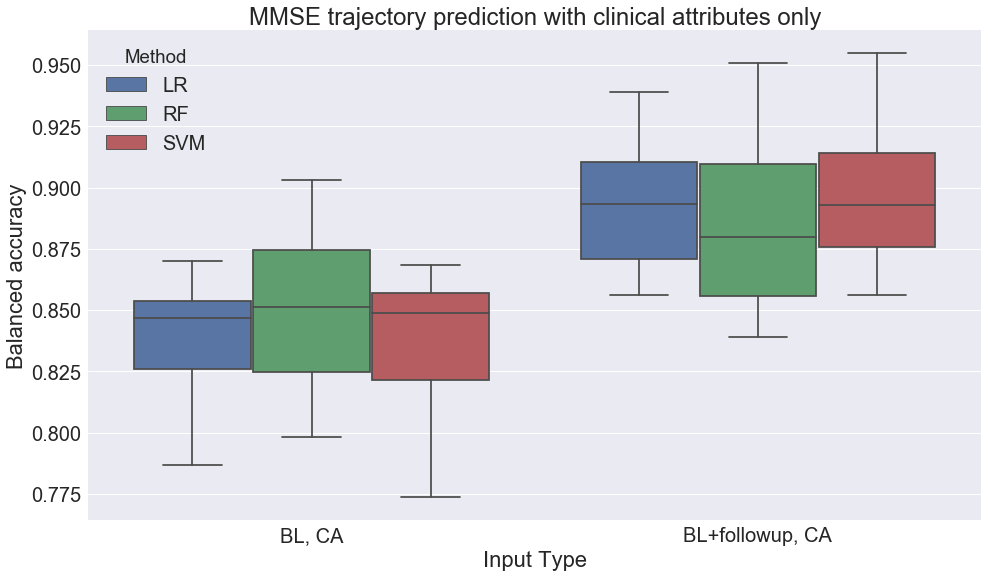

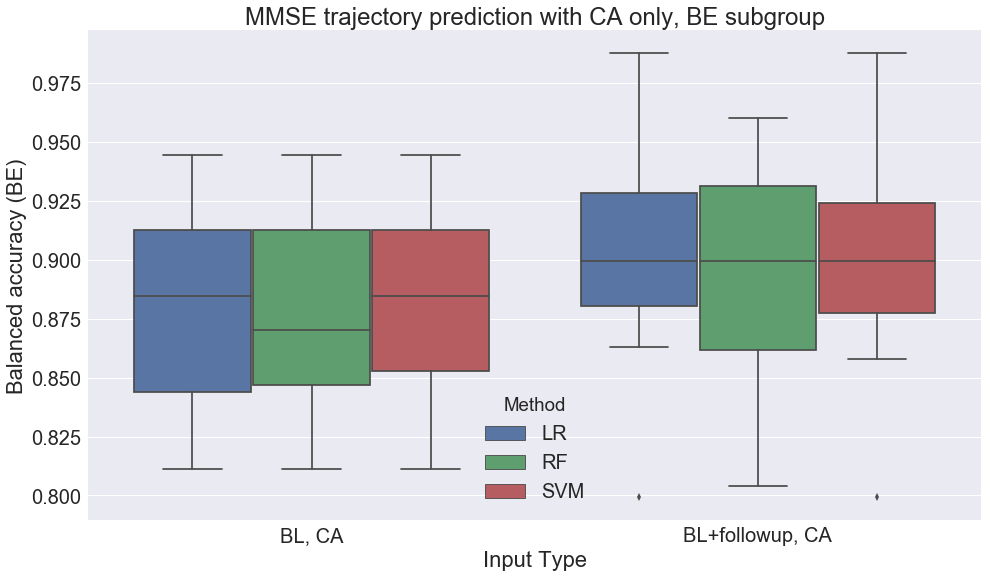

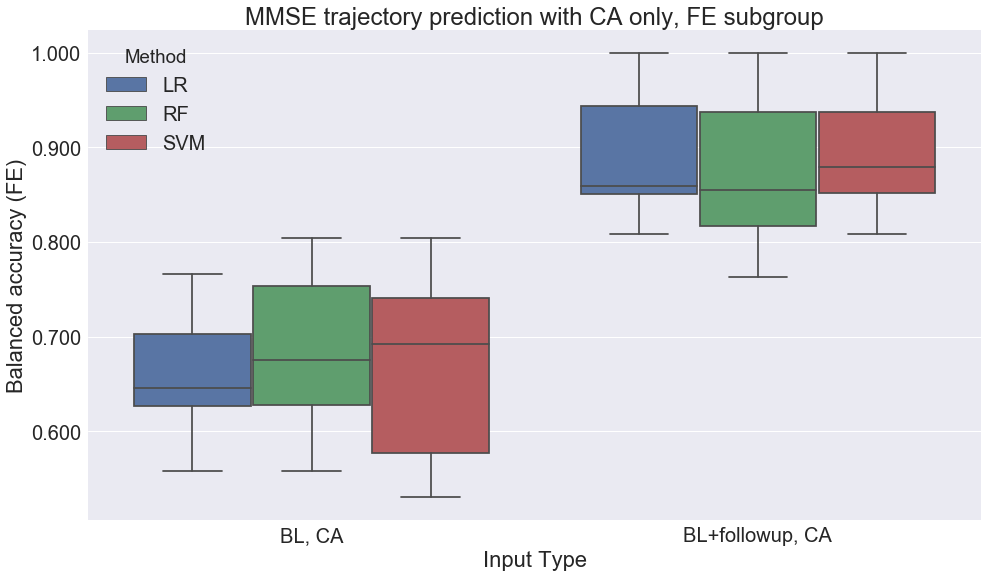

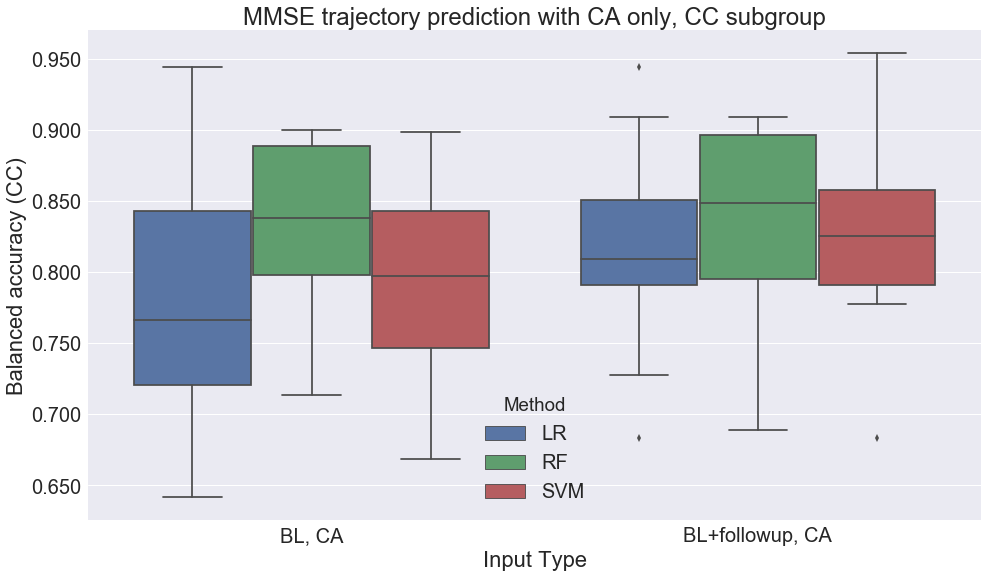

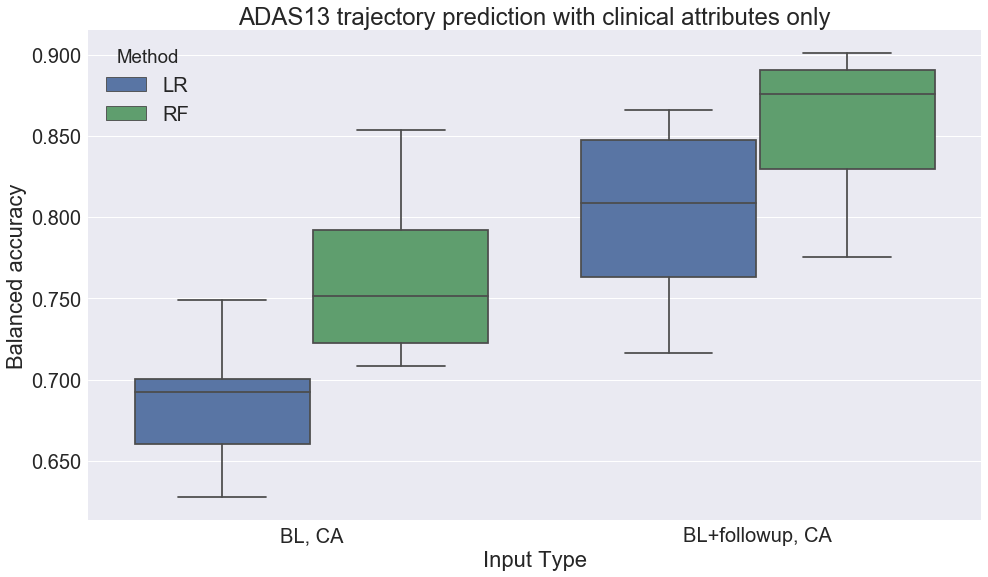

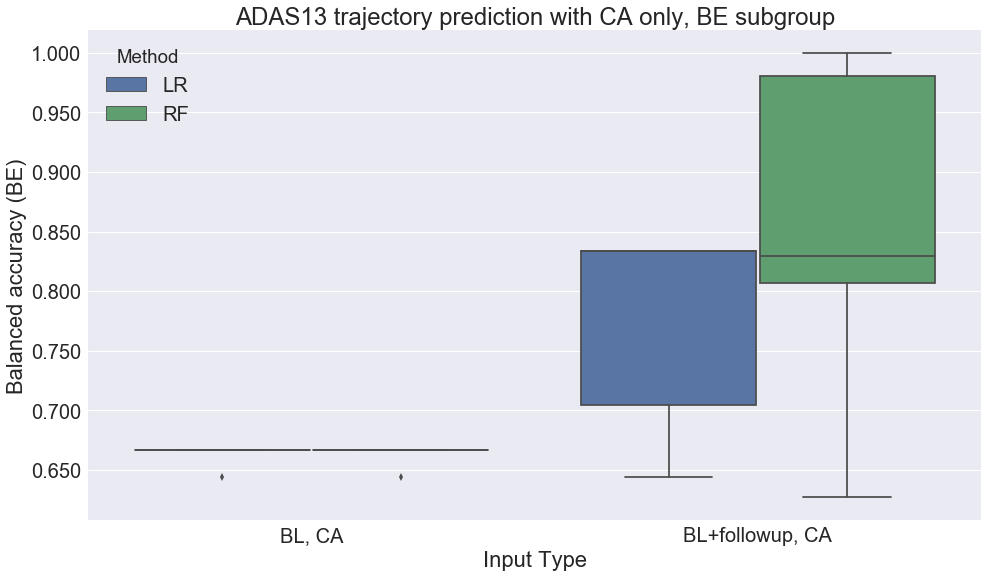

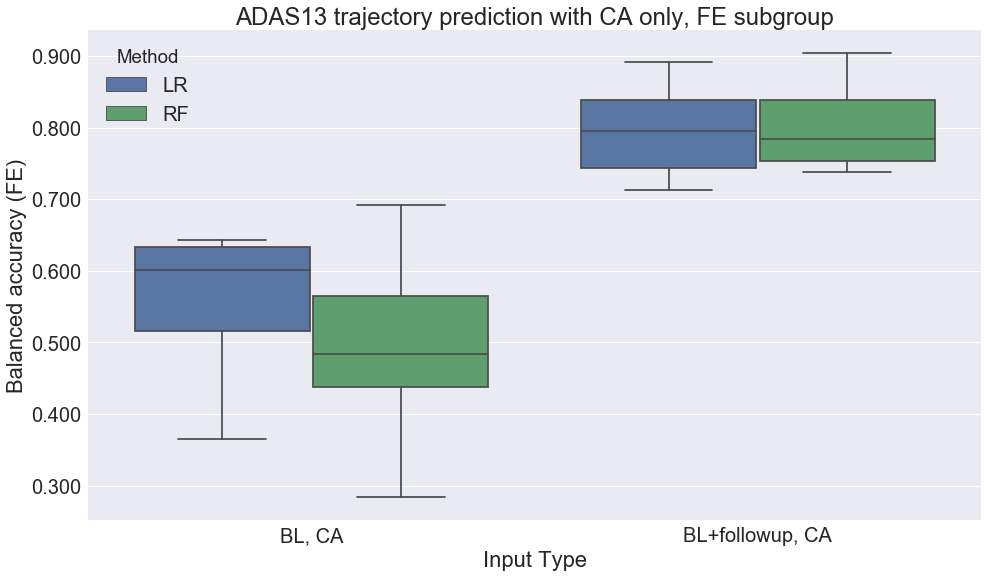

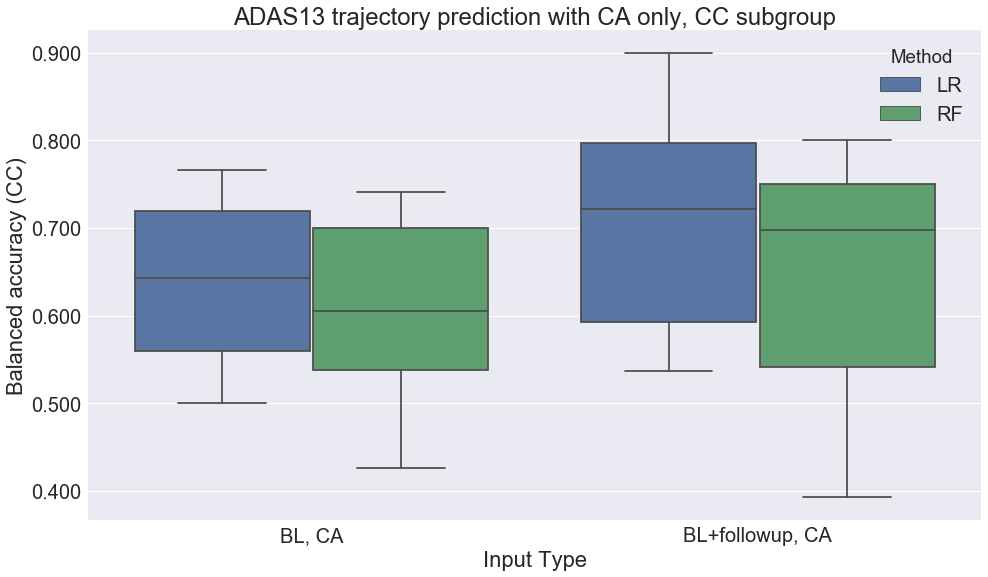

In [25]:
# Plot the balanced accuracy with clinical attributes only
for t in ["MMSE", "ADAS13"]:
    plt.figure(figsize=(16,9))
    cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["FeatureType"] == "None")]
    ax = sns.boxplot(x="Input Type", y="Balanced accuracy", hue="Method", data=cur_df, 
                     order=["BL, CA", "BL+followup, CA"])
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    plt.title("{} trajectory prediction with clinical attributes only".format(t))
    plt.savefig("plots/Exp_Mar18_grid_search/{}_CA-only_bacc_boxplot.png".format(t))
    
    for sg in ["BE", "FE", "CC"]:
        plt.figure(figsize=(16,9))
        ax = sns.boxplot(x="Input Type", y="Balanced accuracy ({})".format(sg), hue="Method", 
                         data=cur_df, order=["BL, CA", "BL+followup, CA"])
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with CA only, {} subgroup".format(t, sg))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_CA-only_bacc_boxplot.png".format(t, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


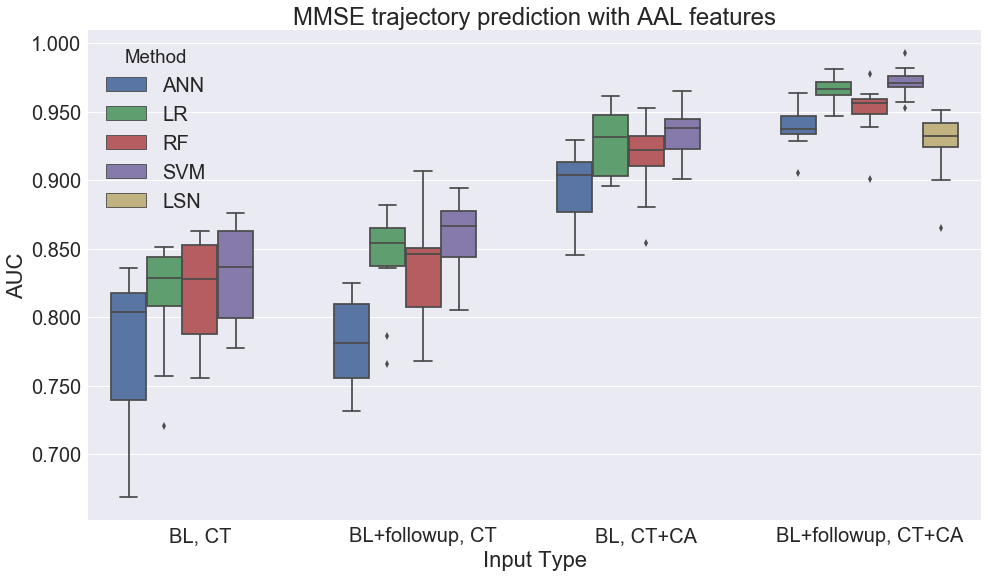

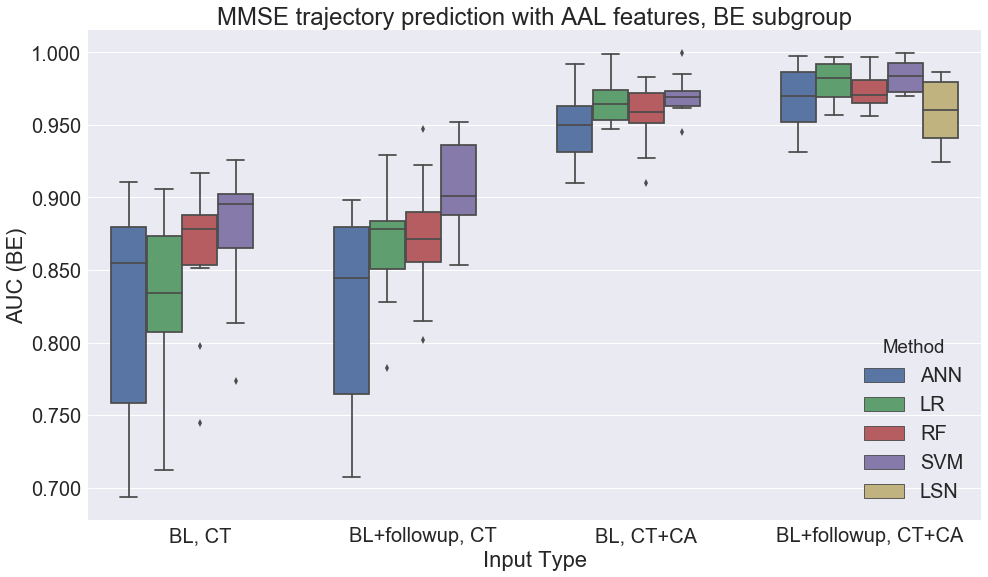

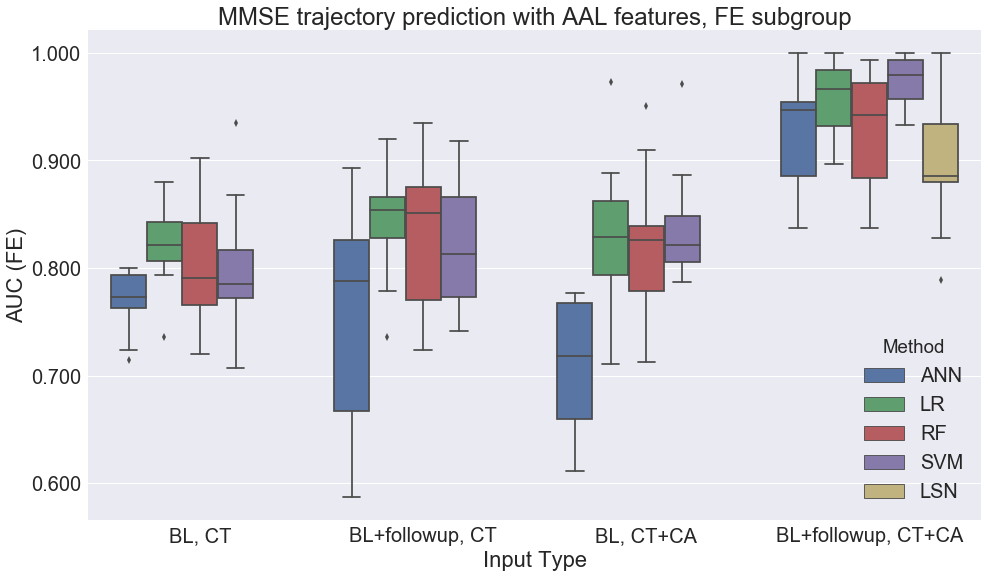

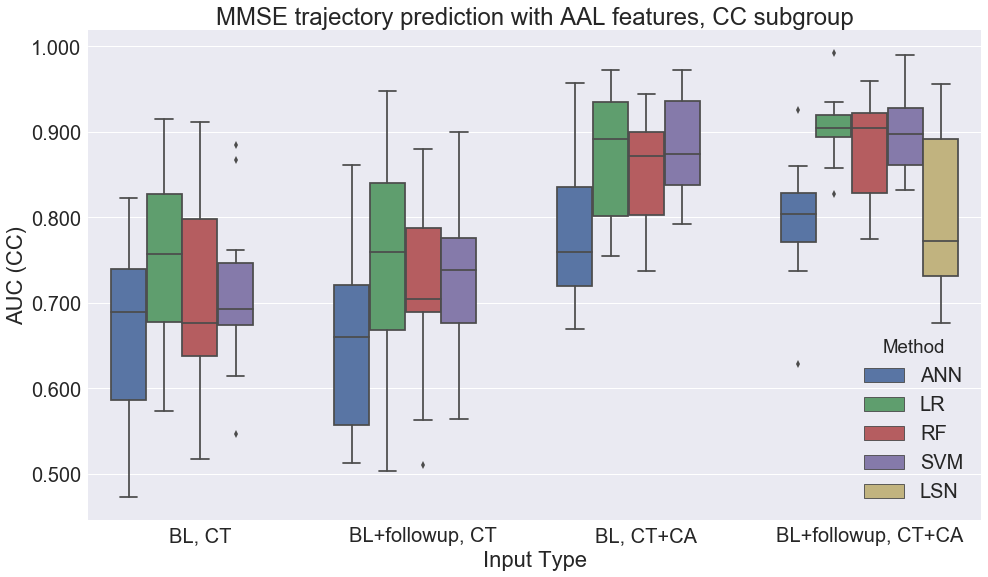

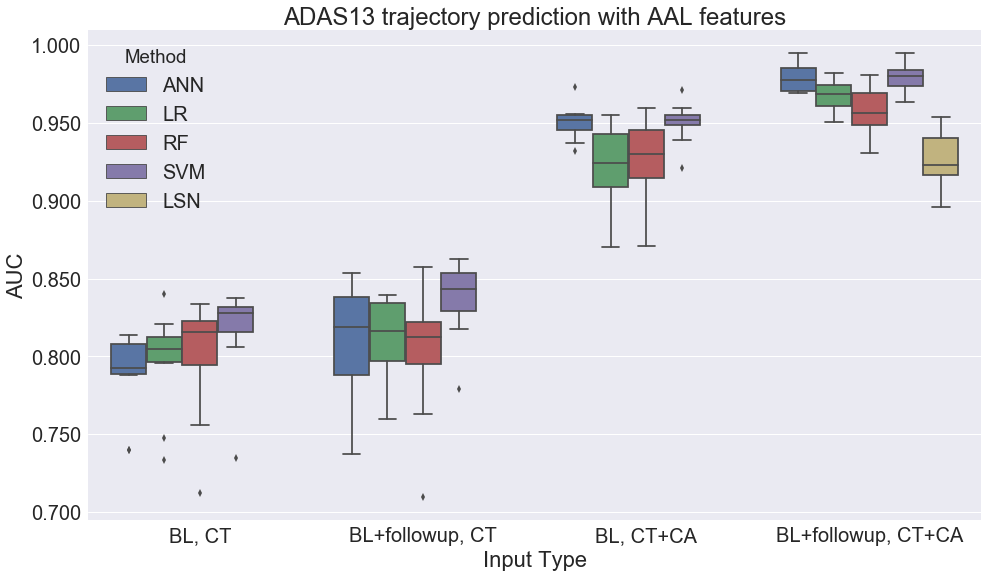

...

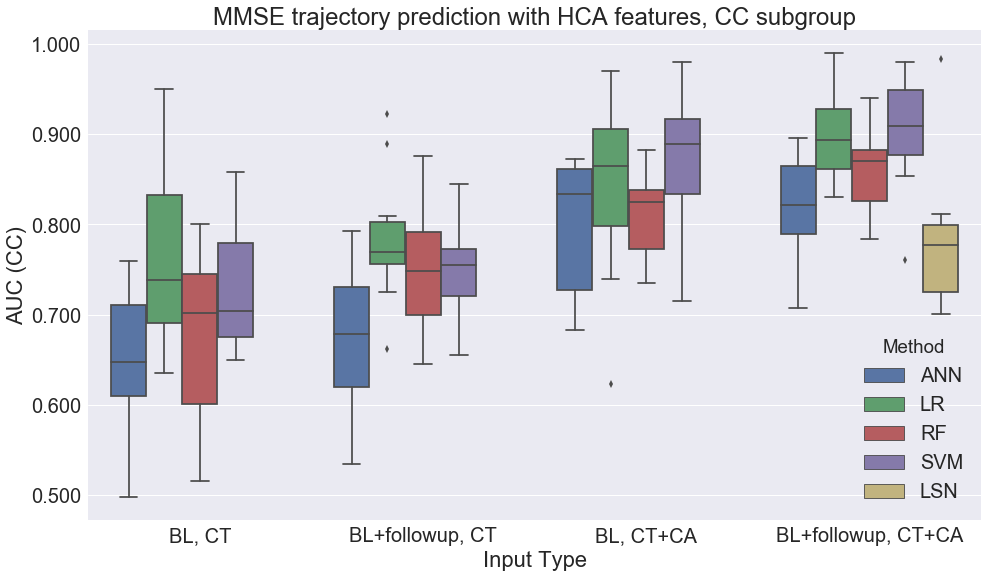

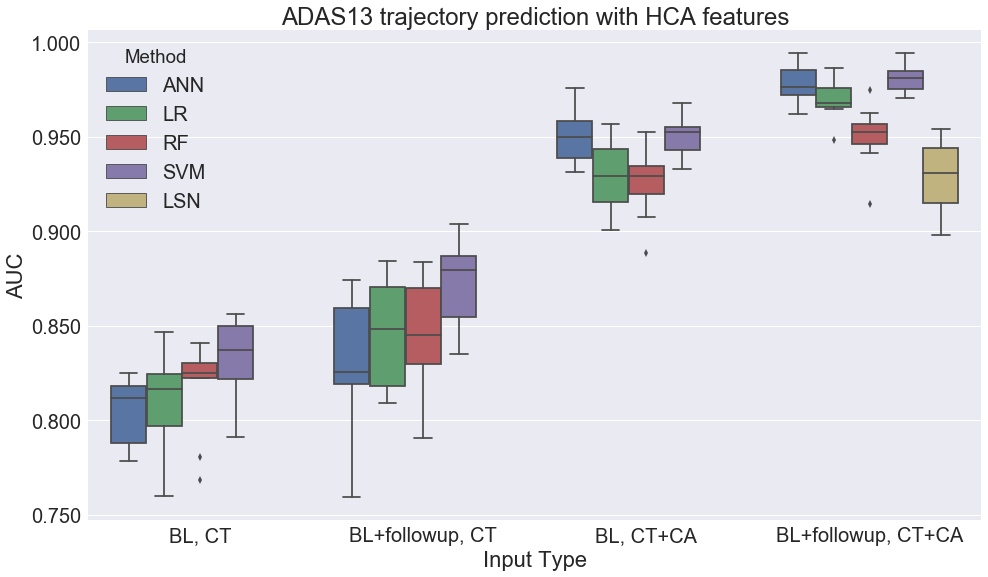

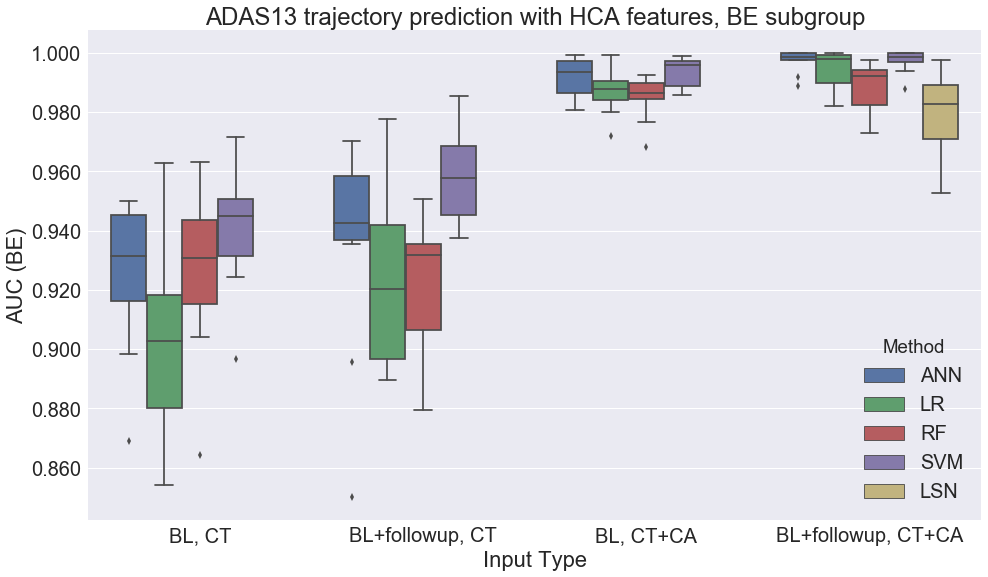

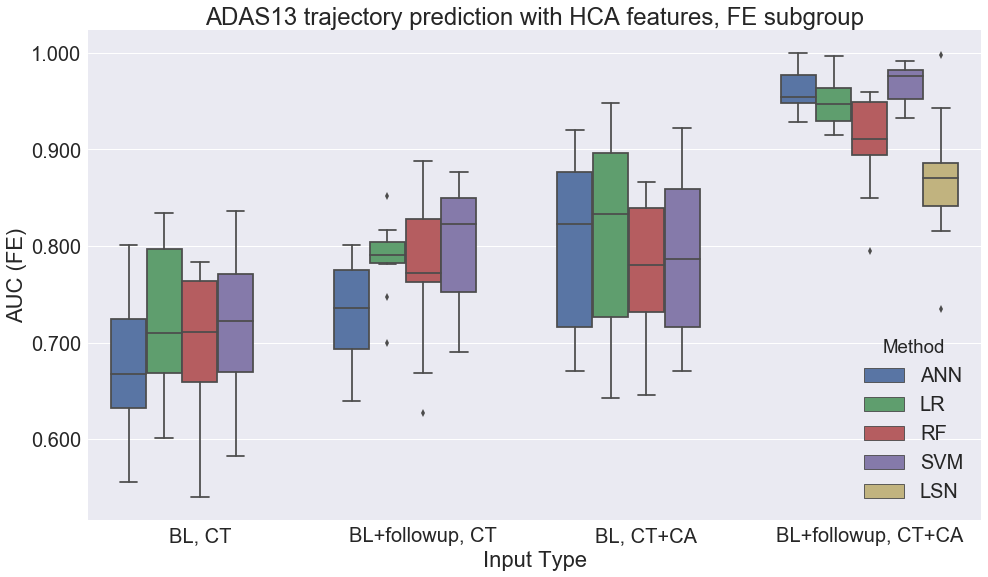

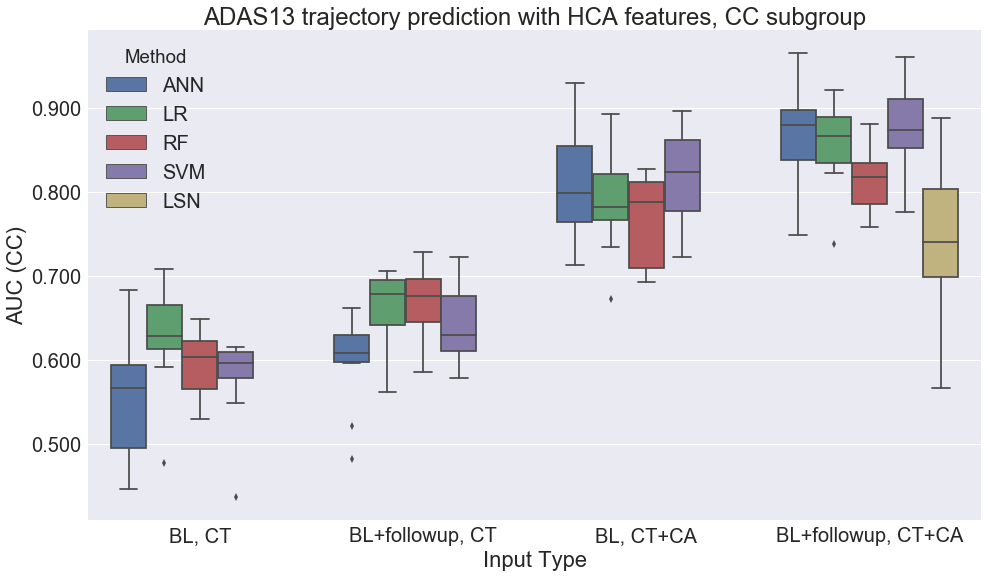

In [26]:
# Look through the experimental conditions (AUC)
for f in ["AAL", "PCA", "RFE", "RLR", "HCA"]:
    for t in ["MMSE", "ADAS13"]:
        plt.figure(figsize=(16,9))
        cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["FeatureType"] == f)]
        ax = sns.boxplot(x="Input Type", y="AUC", hue="Method", data=cur_df, order=choices)
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with {} features".format(t, f))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_auc_boxplot.png".format(t, f))
        
        for sg in ["BE", "FE", "CC"]:
            plt.figure(figsize=(16,9))
            ax = sns.boxplot(x="Input Type", y="AUC ({})".format(sg), 
                             hue="Method", data=cur_df, order=choices)
            ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
            plt.title("{} trajectory prediction with {} features, {} subgroup".format(t, f, sg))
            plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_auc_boxplot.png".format(t, f, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


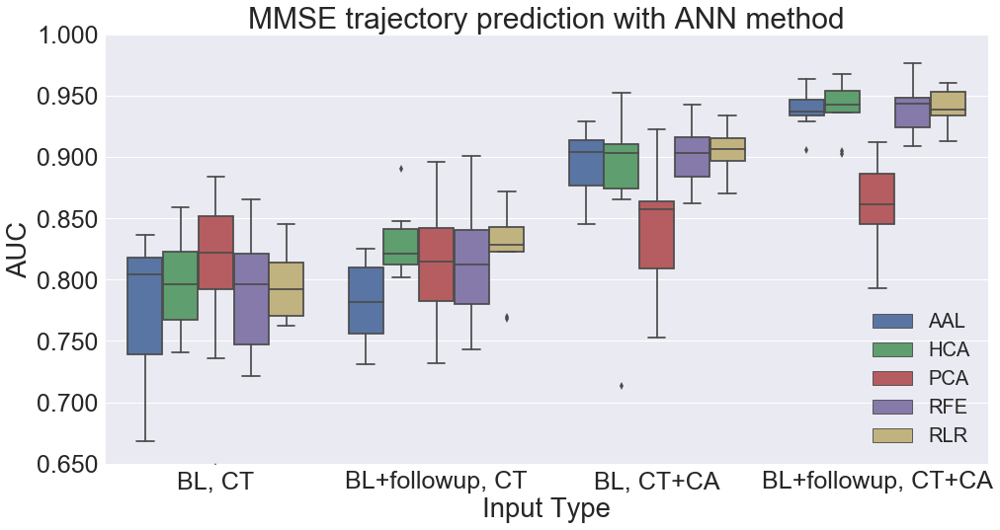

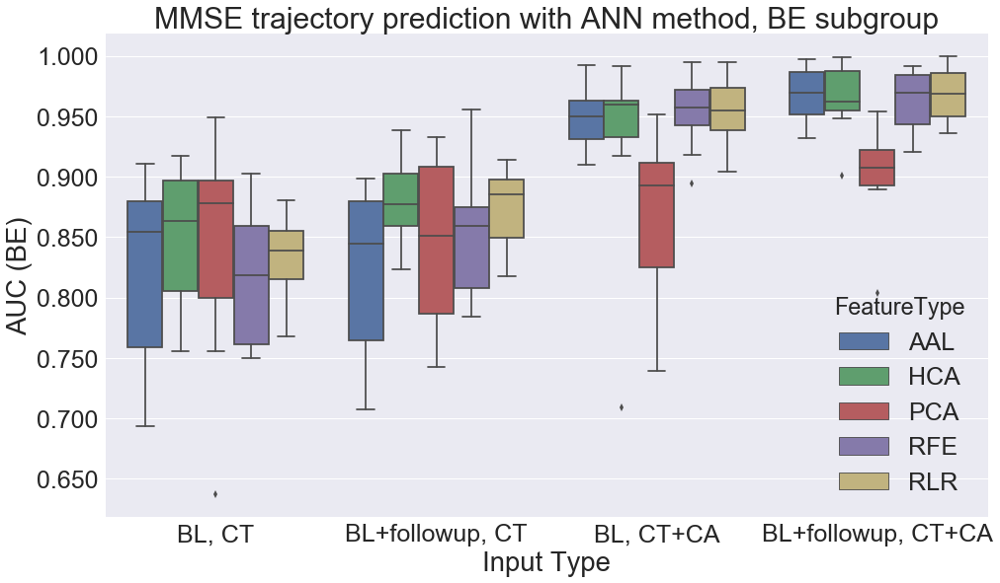

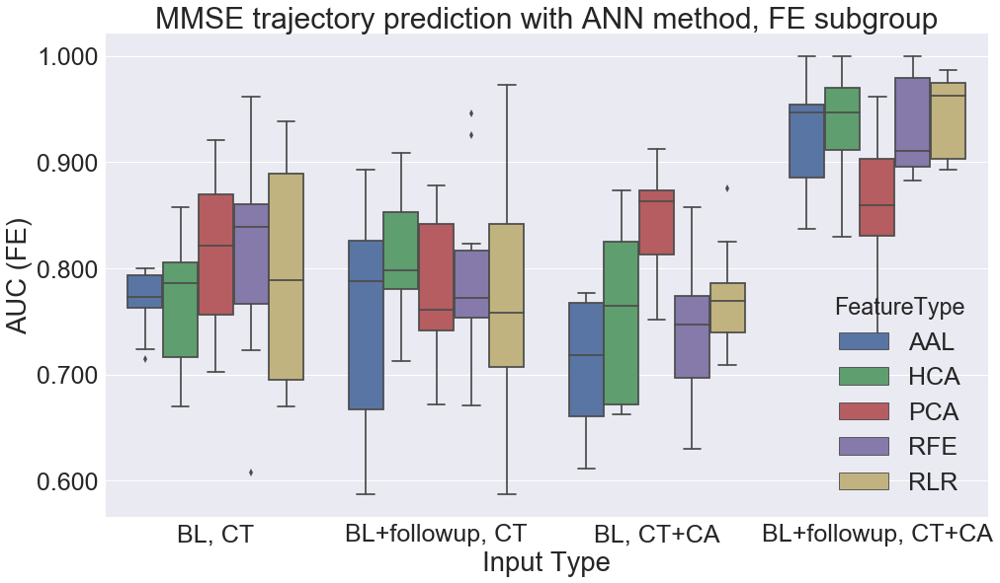

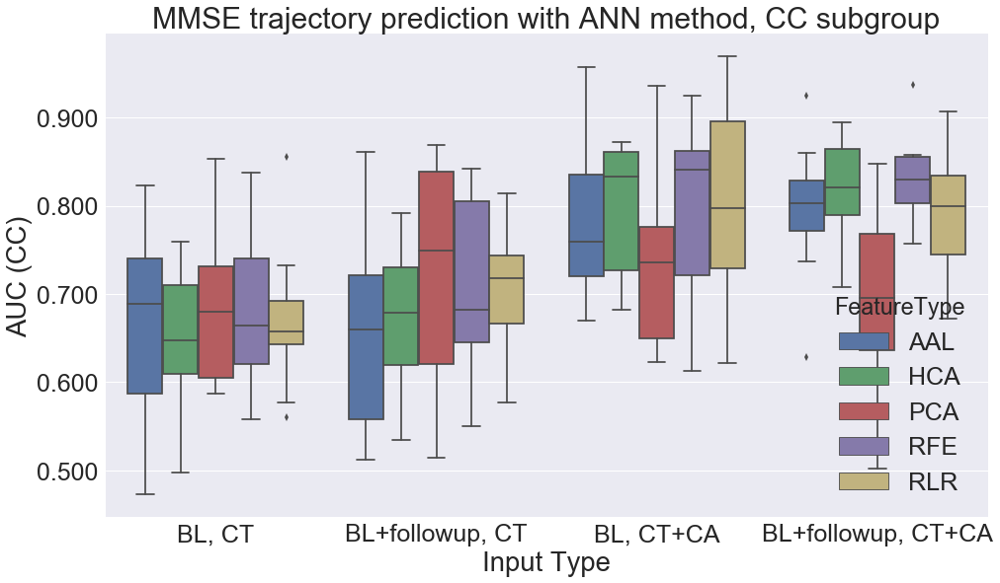

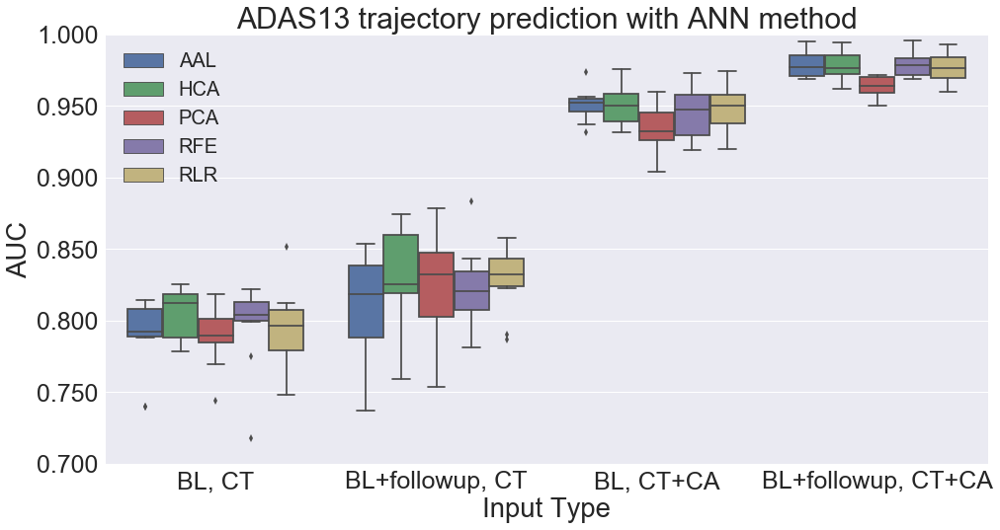

...

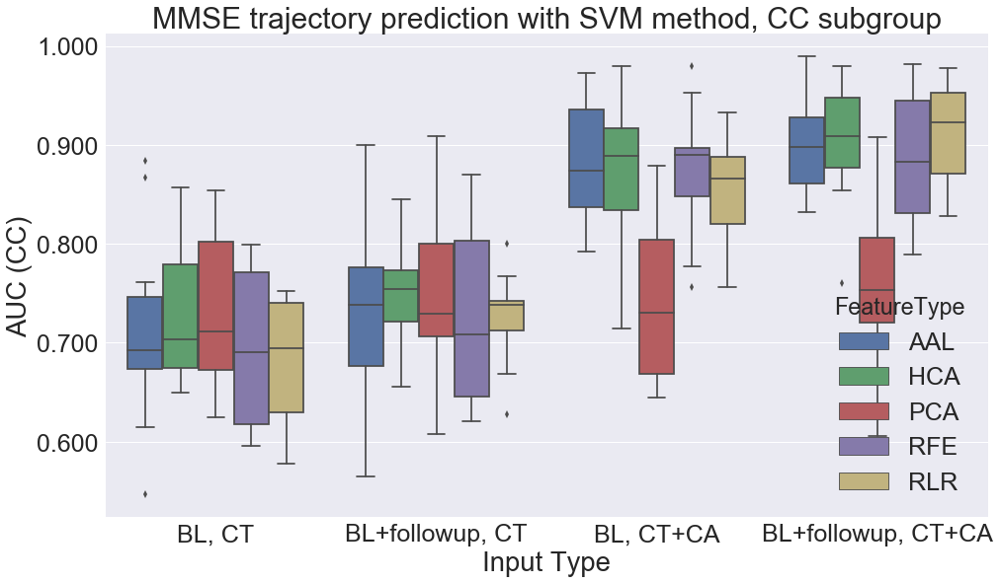

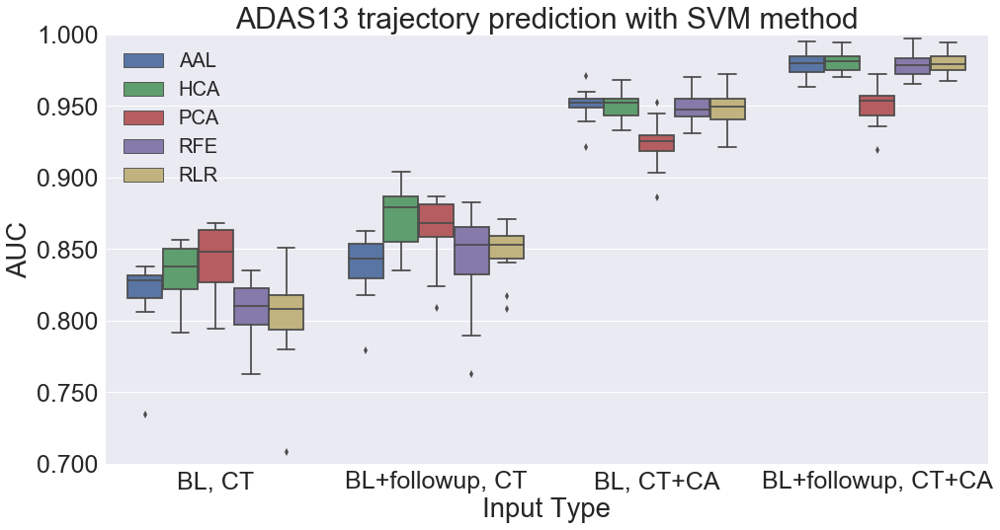

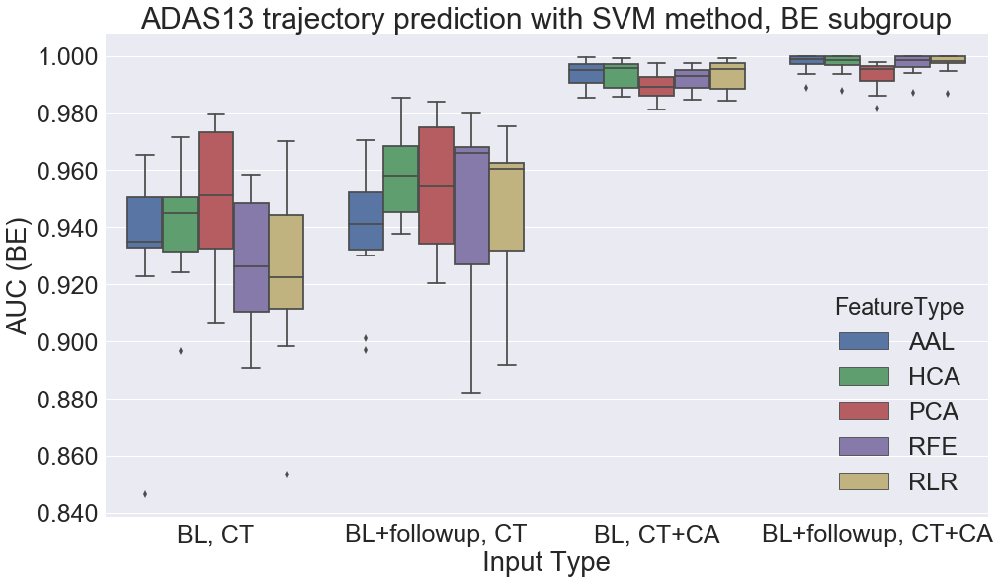

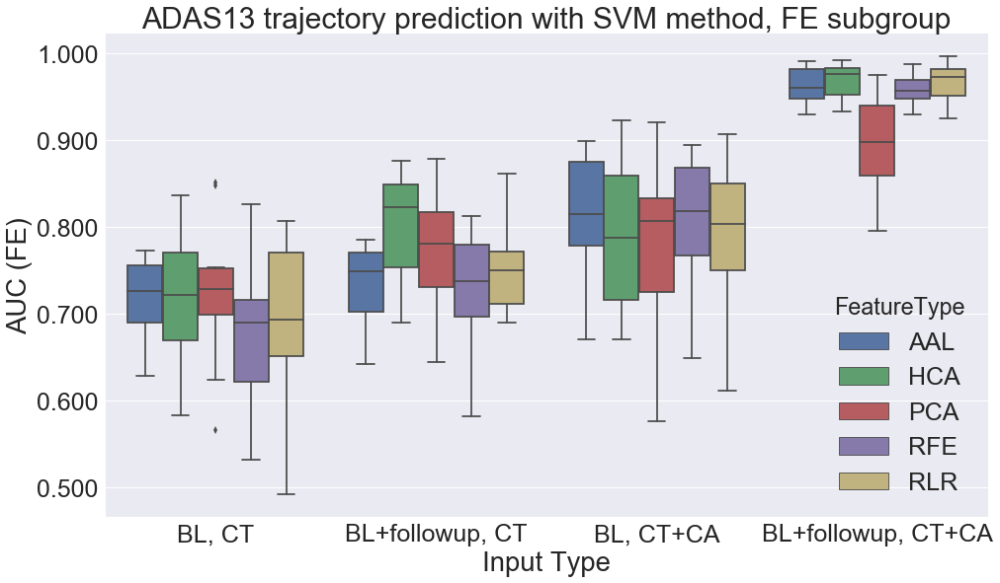

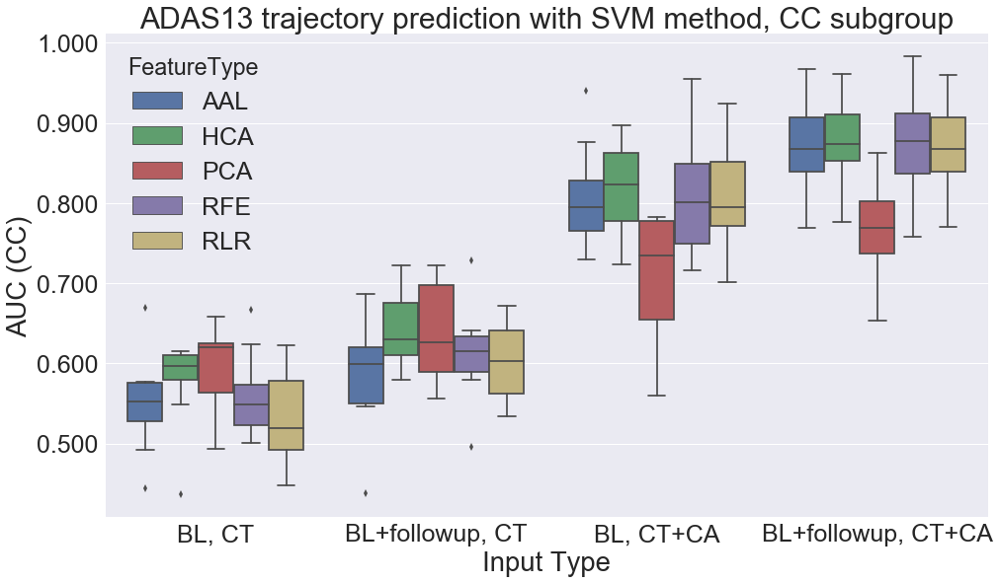

In [24]:
# AUC boxplots by method, at feature type
for m in ["ANN", "LR", "LSN", "RF", "SVM"]:
    for t in ["MMSE", "ADAS13"]:
        plt.figure(figsize=(16,8))
        cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["Method"] == m) & 
                            (new_df["FeatureType"] != "None")]
        if m == "LSN":
            ax = sns.boxplot(x="Input Type", hue="FeatureType", y="AUC", data=cur_df)
            if t == 'MMSE':
                plt.ylim(0.850, 1.000)
            else:
                plt.ylim(0.850, 1.000)
            plt.legend(loc='lower right', fontsize=20)
        else:
            ax = sns.boxplot(x="Input Type", y="AUC", hue="FeatureType", data=cur_df, order=choices)
            if t == 'MMSE':
                plt.ylim(0.650, 1.000)
            if t == 'ADAS13':
                plt.ylim(0.700, 1.000)
            plt.legend(fontsize=20)
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with {} method".format(t, m))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_auc_boxplot.png".format(t, m))
        
        for sg in ["BE", "FE", "CC"]:
            plt.figure(figsize=(16,9))
            if m == "LSN":
                ax = sns.boxplot(x="Input Type", hue="FeatureType", y="AUC", data=cur_df)
            else:
                ax = sns.boxplot(x="Input Type", y="AUC ({})".format(sg), 
                                 hue="FeatureType", data=cur_df, order=choices)
            ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
            plt.title("{} trajectory prediction with {} method, {} subgroup".format(t, m, sg))
            plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_auc_boxplot.png".format(t, m, sg))

In [35]:
# Do statistical testing of the differences between method
for t in ['MMSE', 'ADAS13']:
    for m in ['ANN', 'LR', 'LSN', 'RF', 'SVM']:
        cur_df = new_df.loc[(new_df['Trajectory'] == t) & (new_df['Method'] == m) & 
                            (new_df['Input Type'] == 'BL+followup, CT+CA')]
        ftypes = ['AAL', 'HCA', 'PCA', 'RLR', 'RFE']
        for index, f1 in enumerate(ftypes):
            for f2 in ftypes[index+1:]:
                d1 = cur_df.loc[cur_df['FeatureType'] == f1]['AUC'].values
                d2 = cur_df.loc[cur_df['FeatureType'] == f2]['AUC'].values
                stat, pvalue = ss.mannwhitneyu(d1, d2)
                print(t, m, f1, f2, np.mean(d1) > np.mean(d2), pvalue)

MMSE ANN AAL HCA False 0.3115881119410587
MMSE ANN AAL PCA True 0.00012306406395261486
MMSE ANN AAL RLR False 0.42505336956926293
MMSE ANN AAL RFE False 0.4849249884965778
MMSE ANN HCA PCA True 0.00016491926038899677
MMSE ANN HCA RLR True 0.3668649978481236
MMSE ANN HCA RFE True 0.3956683900503302
MMSE ANN PCA RLR False 9.133589555477501e-05
MMSE ANN PCA RFE False 0.00012306406395261486
MMSE ANN RLR RFE True 0.3956683900503302
MMSE LR AAL HCA True 0.2982815798813098
MMSE LR AAL PCA True 0.0014136360455584039
MMSE LR AAL RLR True 0.3115881119410587
MMSE LR AAL RFE True 0.09293836618293788
MMSE LR HCA PCA True 0.007009638556979976
MMSE LR HCA RLR True 0.5
MMSE LR HCA RFE True 0.3668649978481236
MMSE LR PCA RLR False 0.007009638556979976
MMSE LR PCA RFE False 0.015604506385870109
MMSE LR RLR RFE True 0.33879247897623777
MMSE LSN AAL HCA True 0.23633779675579358
MMSE LSN AAL PCA True 0.15374472830934066
MMSE LSN AAL RLR False 0.3115881119410587
MMSE LSN AAL RFE True 0.07023252407917747
MMS

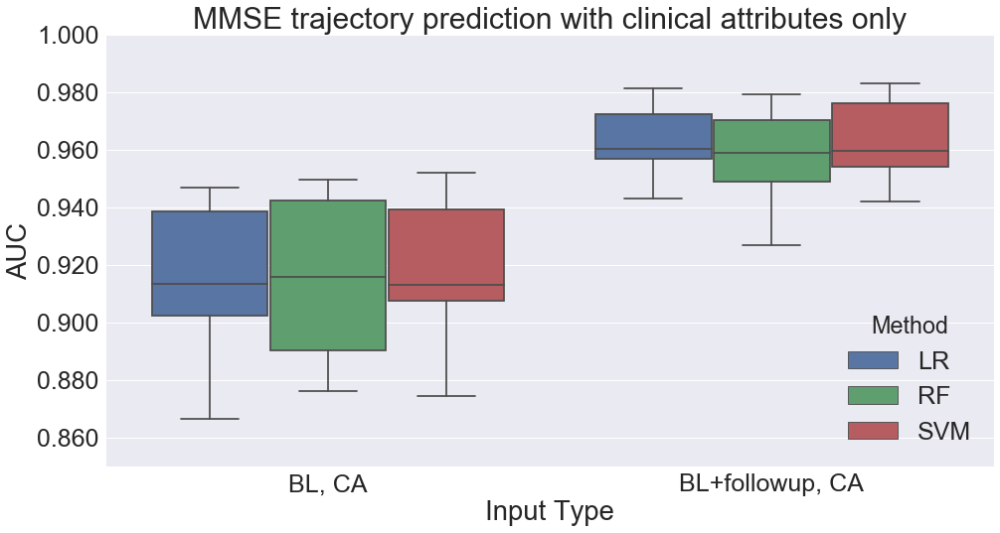

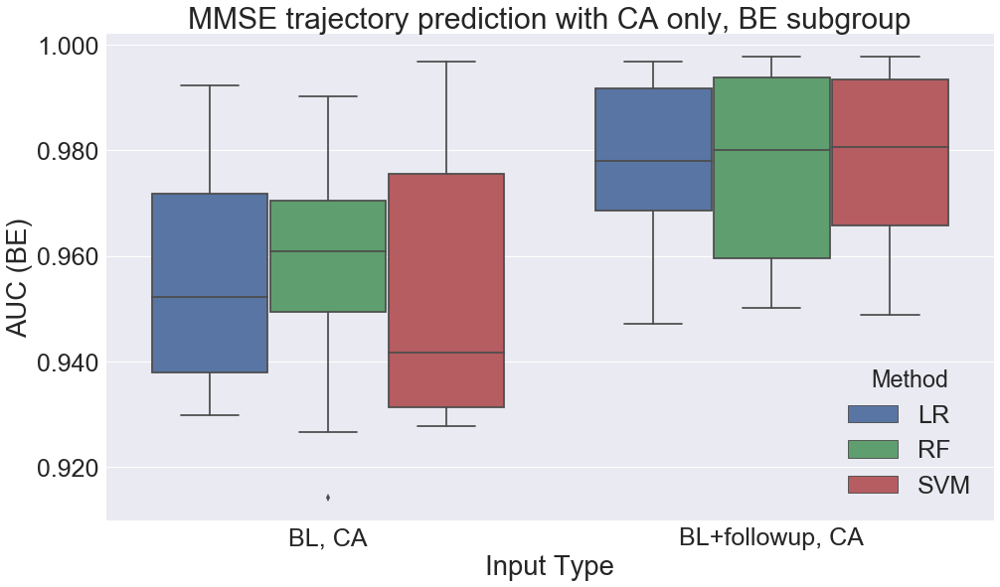

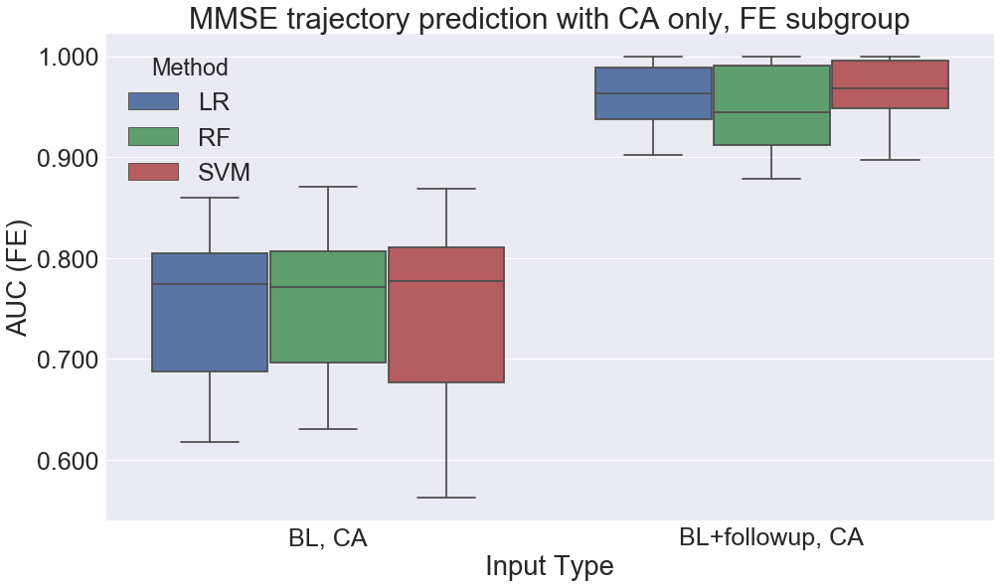

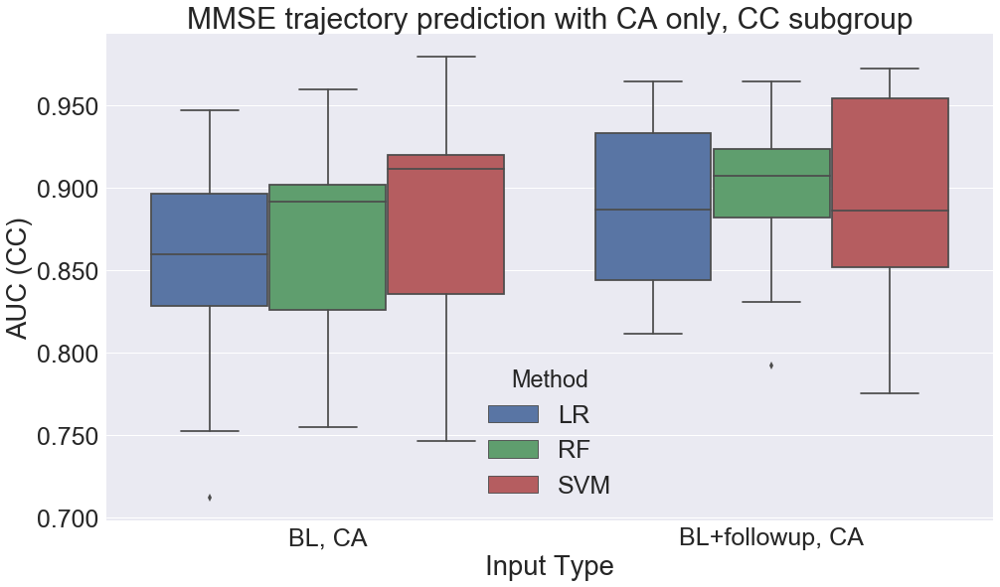

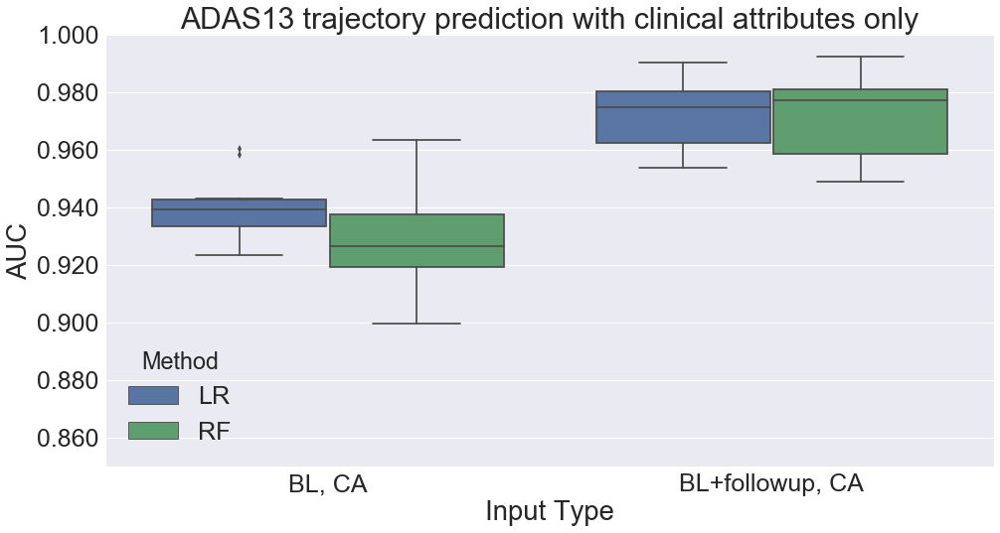

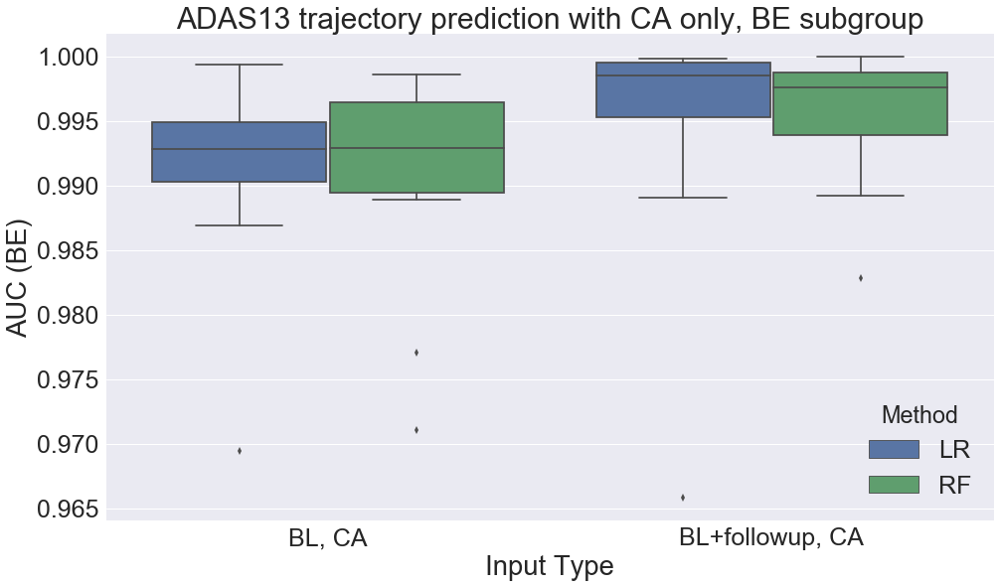

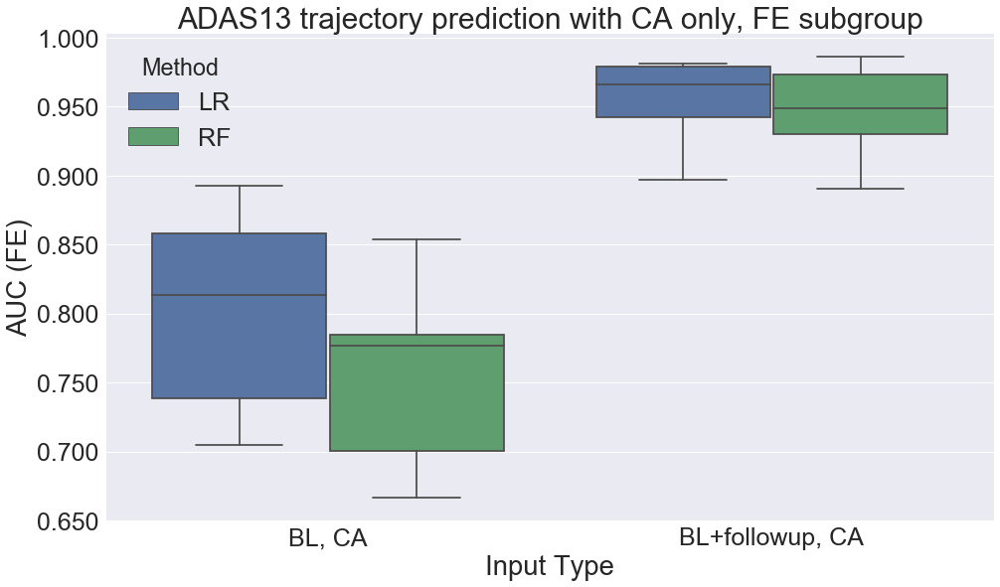

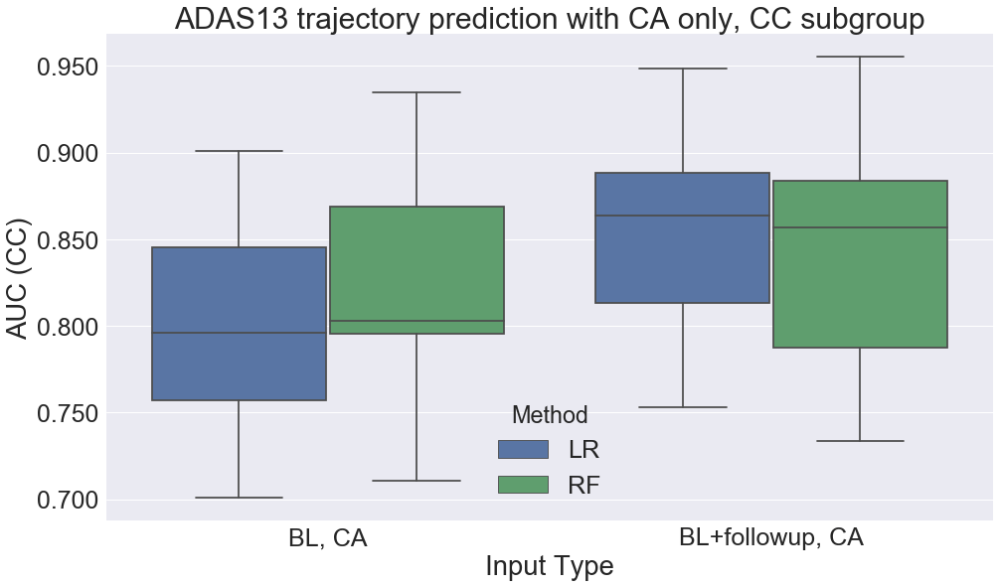

In [13]:
# Plot the AUC with clinical attributes only
for t in ["MMSE", "ADAS13"]:
    plt.figure(figsize=(16,8))
    cur_df = new_df.loc[(new_df["Trajectory"] == t) & (new_df["FeatureType"] == "None")]
    ax = sns.boxplot(x="Input Type", y="AUC", hue="Method", data=cur_df, order=["BL, CA", "BL+followup, CA"])
    plt.ylim(0.850, 1.000)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    plt.title("{} trajectory prediction with clinical attributes only".format(t))
    plt.savefig("plots/Exp_Mar18_grid_search/{}_CA-only_auc_boxplot.png".format(t))
    
    for sg in ["BE", "FE", "CC"]:
        plt.figure(figsize=(16,9))
        ax = sns.boxplot(x="Input Type", y="AUC ({})".format(sg), hue="Method", 
                         data=cur_df, order=["BL, CA", "BL+followup, CA"])
        ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
        plt.title("{} trajectory prediction with CA only, {} subgroup".format(t, sg))
        plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_CA-only_auc_boxplot.png".format(t, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


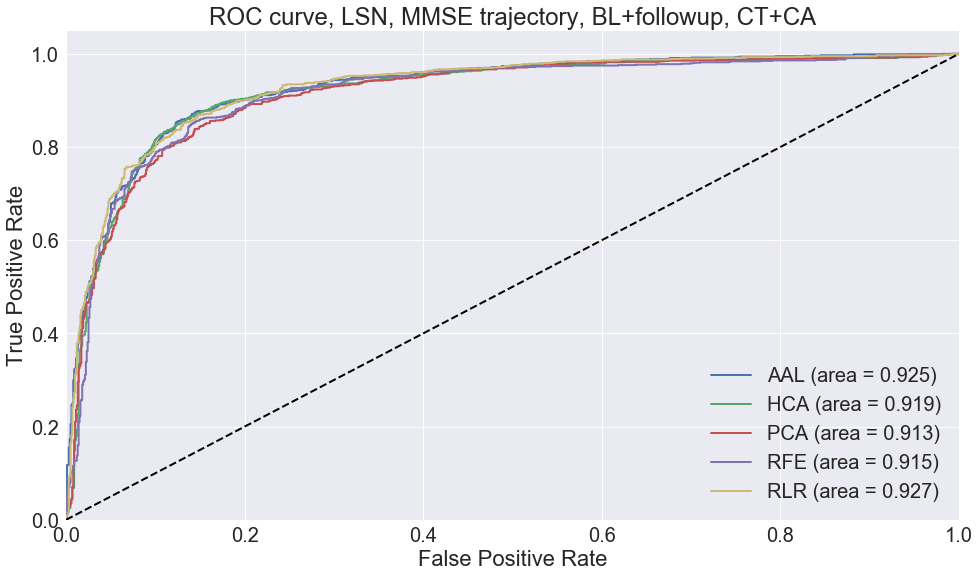

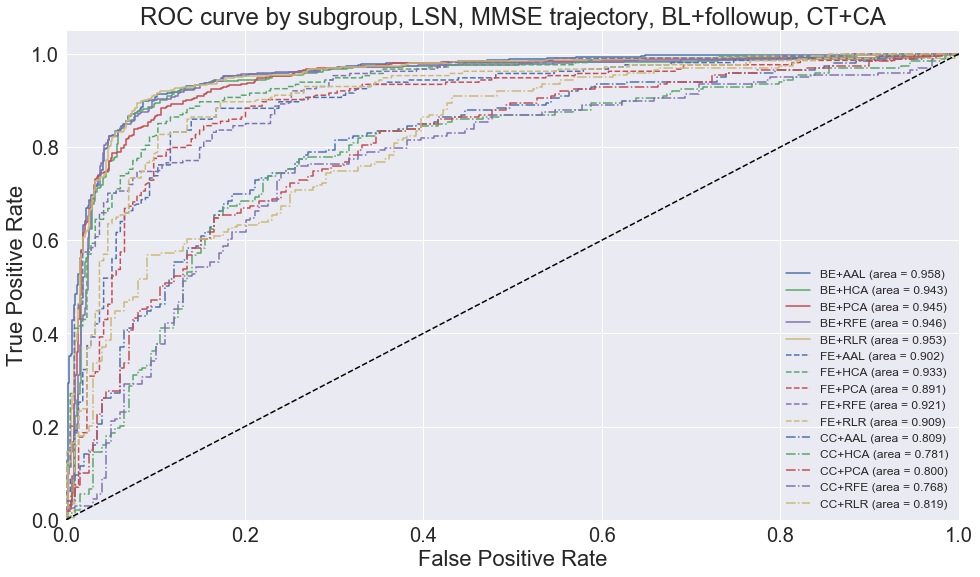

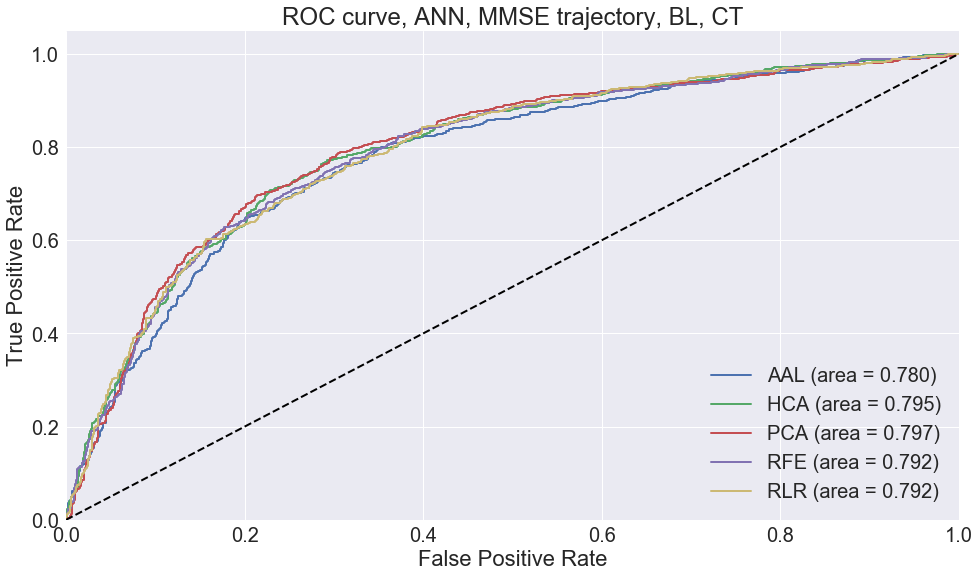

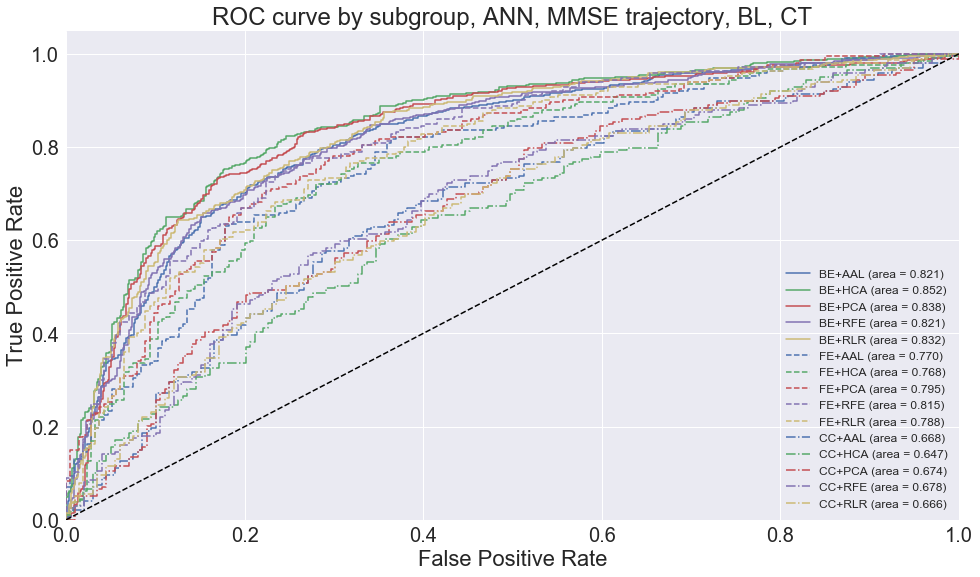

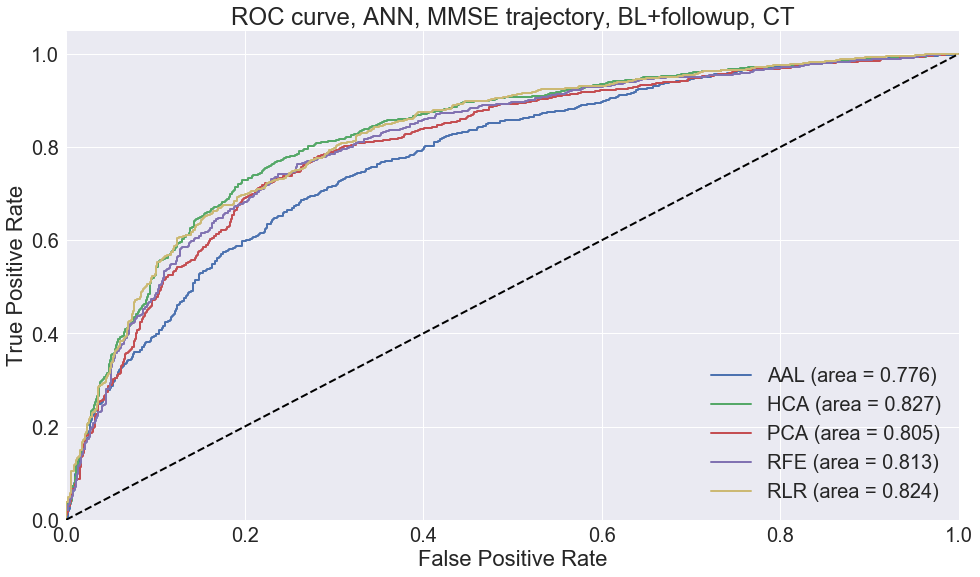

...

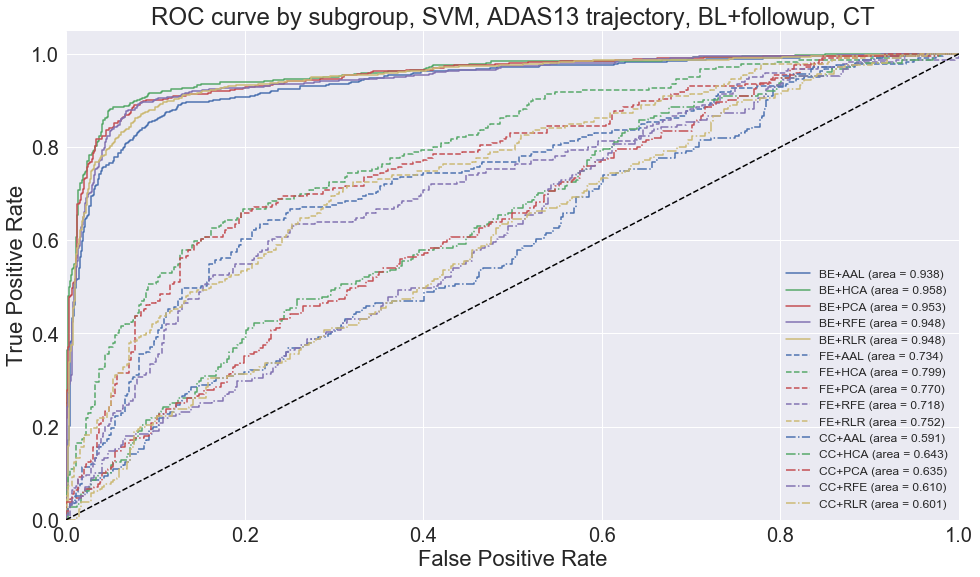

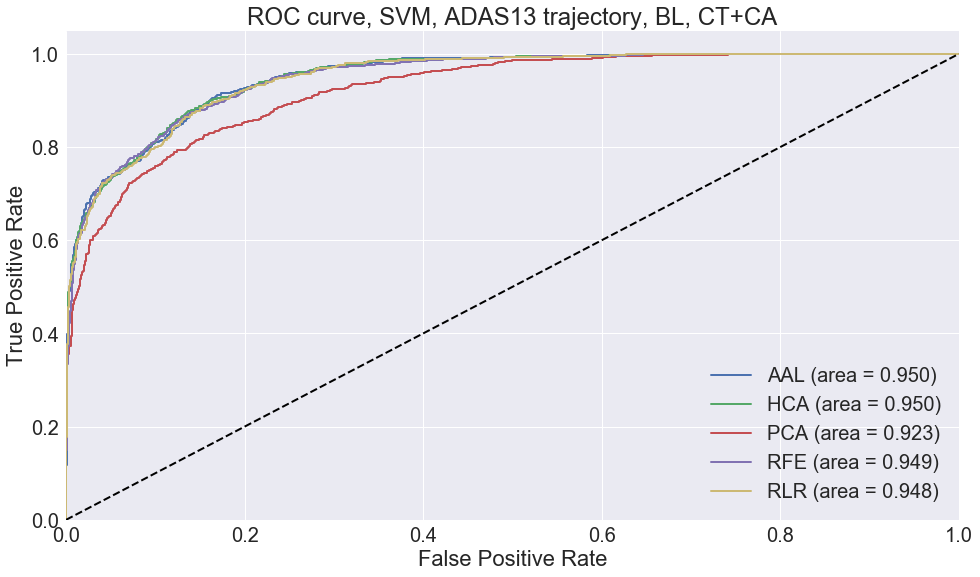

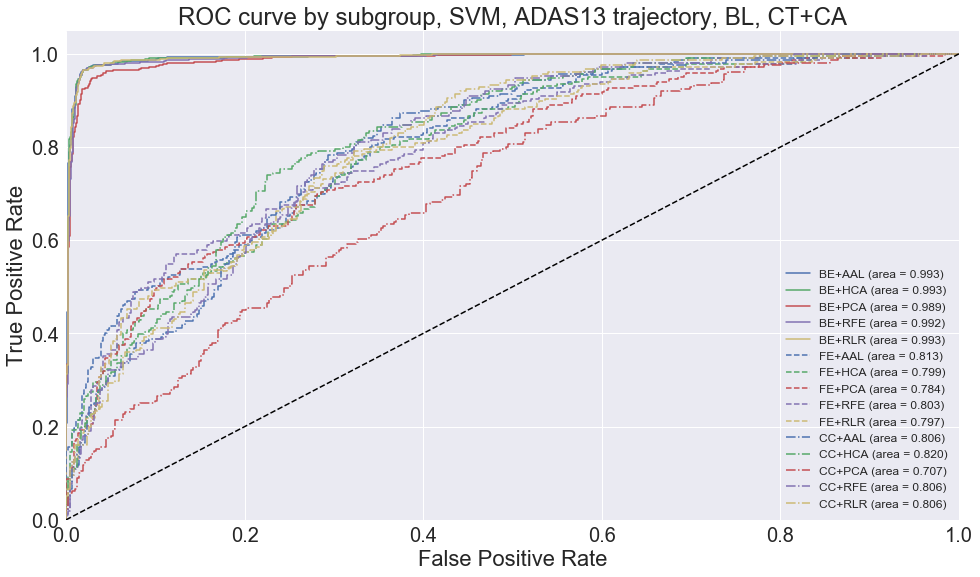

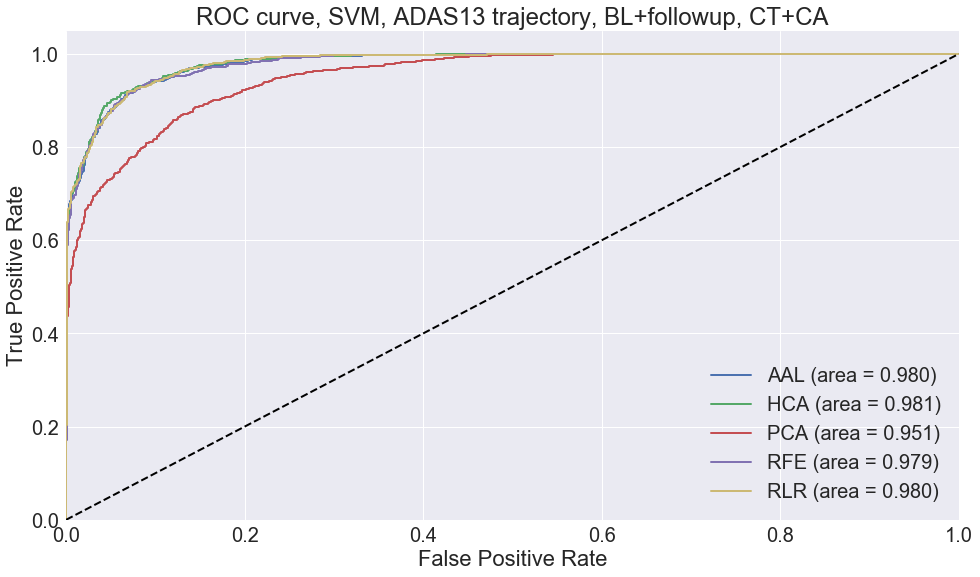

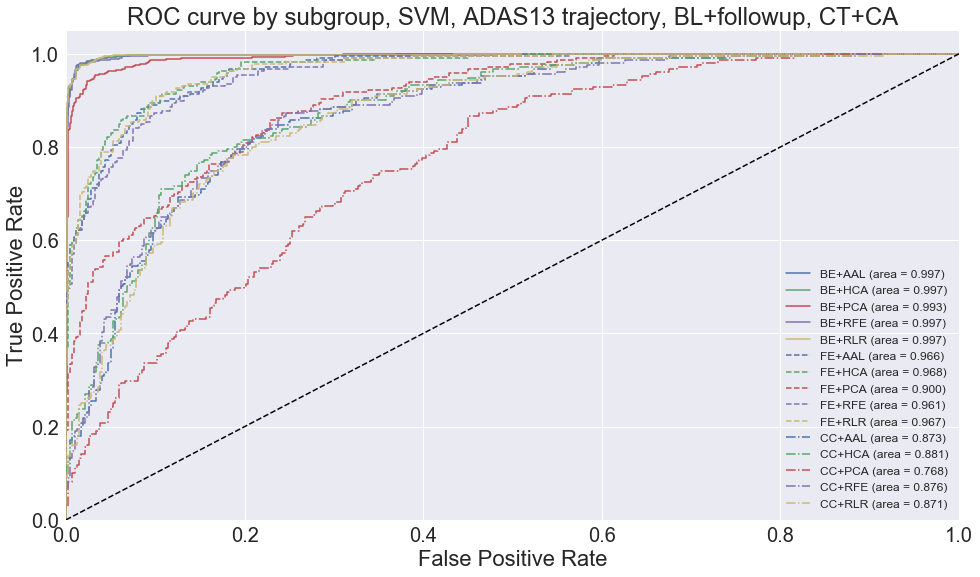

In [48]:
# Plot the Receiver Operator Characteristic curves

for t in ["MMSE", "ADAS13"]:
    for m in ["LSN", "ANN", "LR", "RF", "SVM"]:
        for ix, condition in enumerate(["BL, CT", "BL+followup, CT", "BL, CT+CA","BL+followup, CT+CA"]):
            if m == "LSN" and condition != "BL+followup, CT+CA":
                pass
        
            else:
                roc_stats = {}
            
                if condition == "BL, CT":
                    suffix = "{}_78_NoClinical_NoFollowup_GridSearch_roc_stats.pkl".format(t)
                elif condition == "BL+followup, CT":
                    suffix = "{}_78_NoClinical_GridSearch_roc_stats.pkl".format(t)
                elif condition == "BL, CT+CA":
                    suffix = "{}_78_NoFollowup_GridSearch_roc_stats.pkl".format(t)
                elif condition == "BL+followup, CT+CA":
                    suffix = "{}_78_GridSearch_roc_stats.pkl".format(t)

                for ftype in ["AAL", "HCA", "PCA", "RFE", "RLR"]:
                    with open("results/Exp_Mar18_grid_search/{}_{}_{}".format(m, ftype, suffix), "rb") as f:
                        roc_stats[ftype] = pkl.load(f)

                plt.figure(figsize=(16,9))
                for ftype in ["AAL", "HCA", "PCA", "RFE", "RLR"]:
                    plt.plot(roc_stats[ftype]['fpr'], roc_stats[ftype]['tpr'],
                            lw=2, label="{} (area = {:0.3f})".format(ftype, 
                            auc(roc_stats[ftype]['fpr'], roc_stats[ftype]['tpr'])))

                plt.plot([0, 1], [0, 1], 'k--', lw=2)
                plt.xlim([0.0, 1.0])
                plt.ylim([0.0, 1.05])
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.title('ROC curve, {}, {} trajectory, {}'.format(m, t, condition))
                plt.legend(loc="lower right")
                plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_ROC_curve.png".format(m, t, ix))
                
                plt.figure(figsize=(16,9))
                colors = sns.color_palette()
                linestyles = ['-', '--', '-.']
                for i, sg in enumerate(["BE", "FE", "CC"]):
                    for j, ftype in enumerate(["AAL", "HCA", "PCA", "RFE", "RLR"]):
                        plt.plot(roc_stats[ftype]['fpr_{}'.format(sg)], roc_stats[ftype]['tpr_{}'.format(sg)],
                                lw=1.5, color=colors[j], linestyle=linestyles[i], 
                                label="{}+{} (area = {:0.3f})".format(sg, ftype, 
                                auc(roc_stats[ftype]['fpr_{}'.format(sg)], roc_stats[ftype]['tpr_{}'.format(sg)])))

                plt.plot([0, 1], [0, 1], 'k--', lw=1.5)
                plt.xlim([0.0, 1.0])
                plt.ylim([0.0, 1.05])
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.title('ROC curve by subgroup, {}, {} trajectory, {}'.format(m, t, condition))
                plt.legend(loc="lower right", prop={'size': 12})
                plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_subgroup_ROC_curve.png".format(m, t, ix, sg))

/opt/quarantine/anaconda/5.1.0-python3/install/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


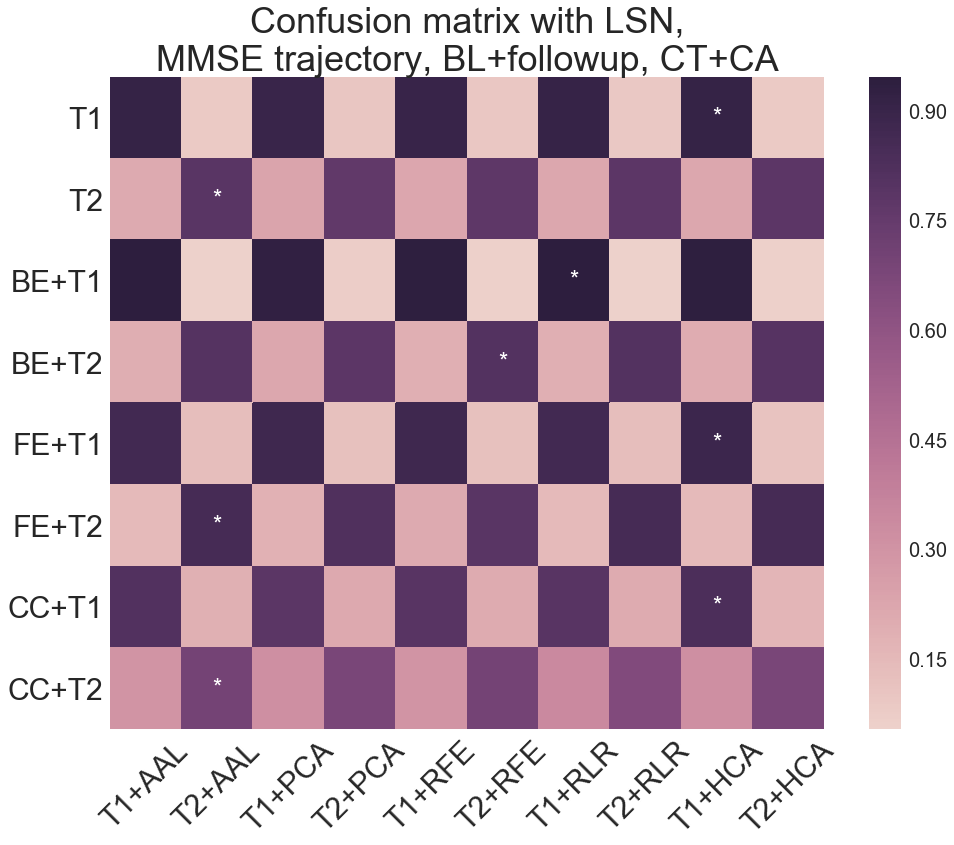

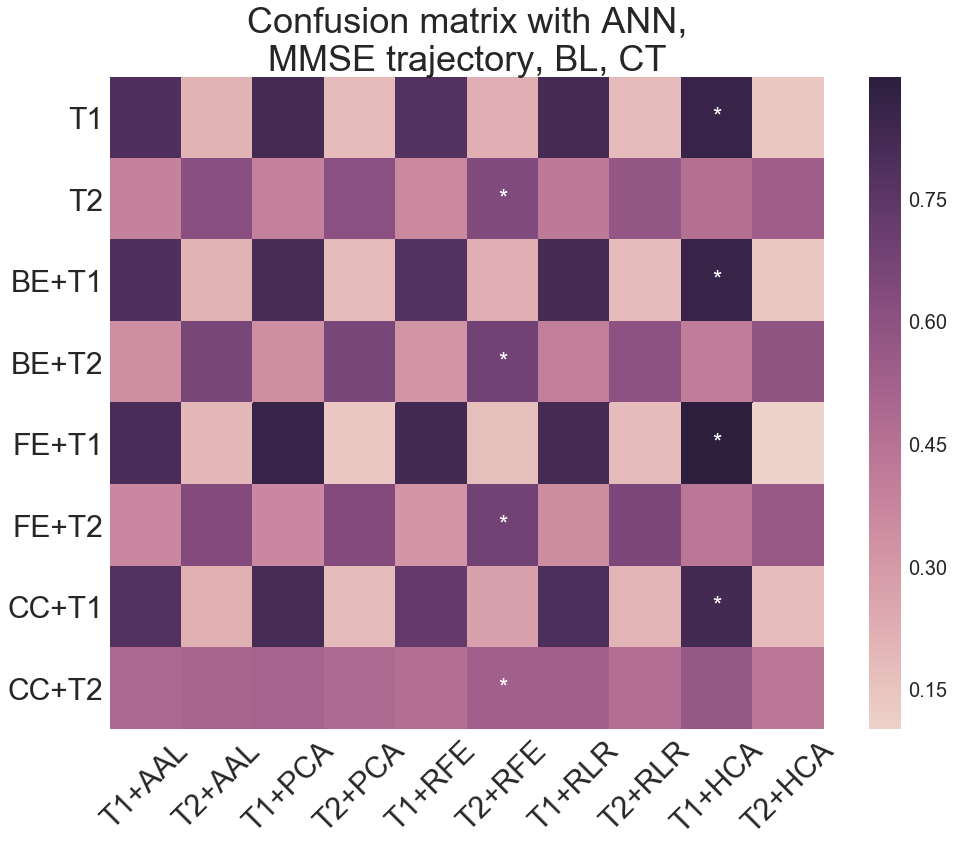

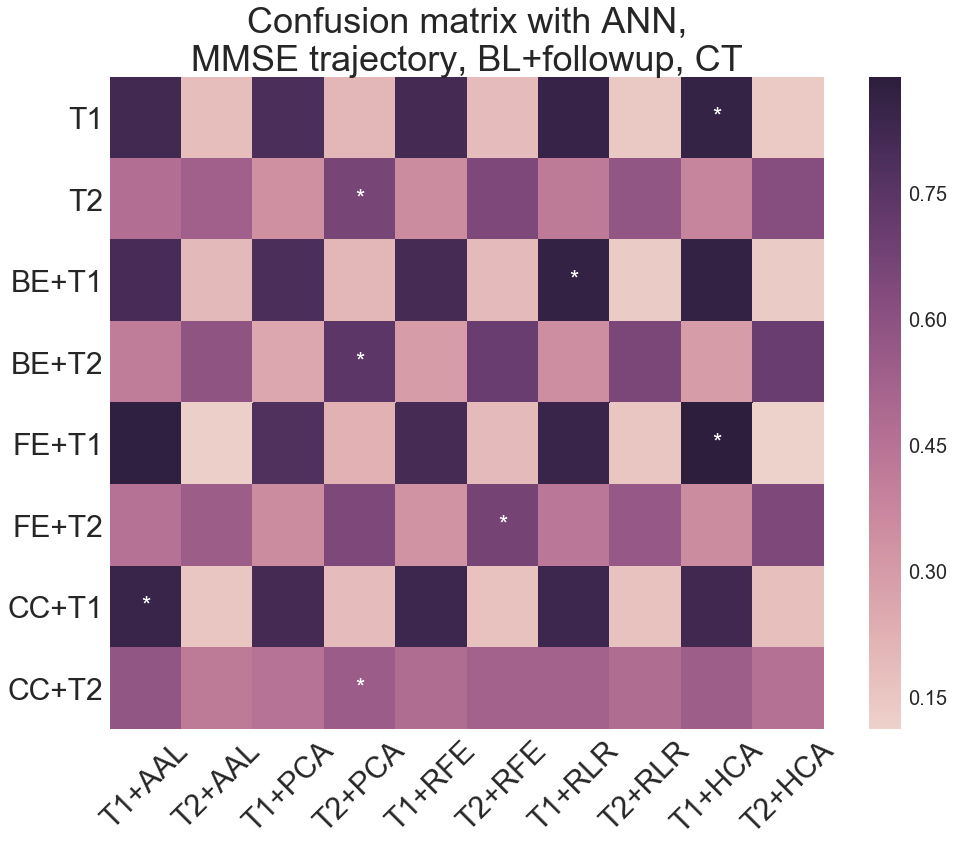

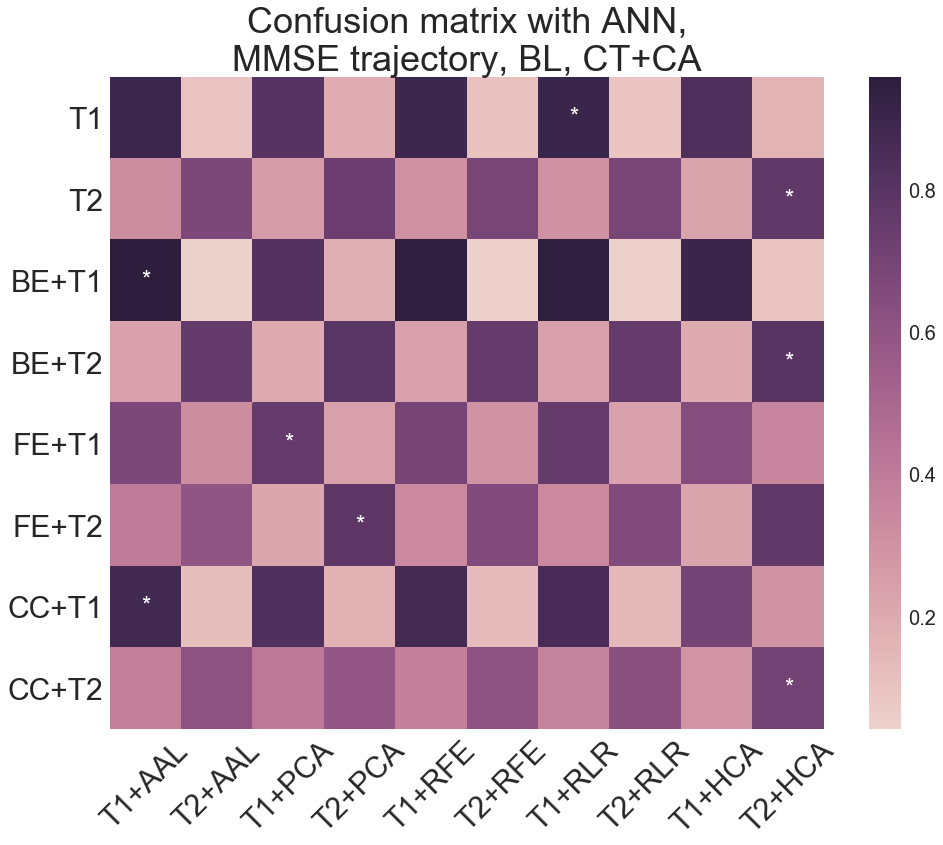

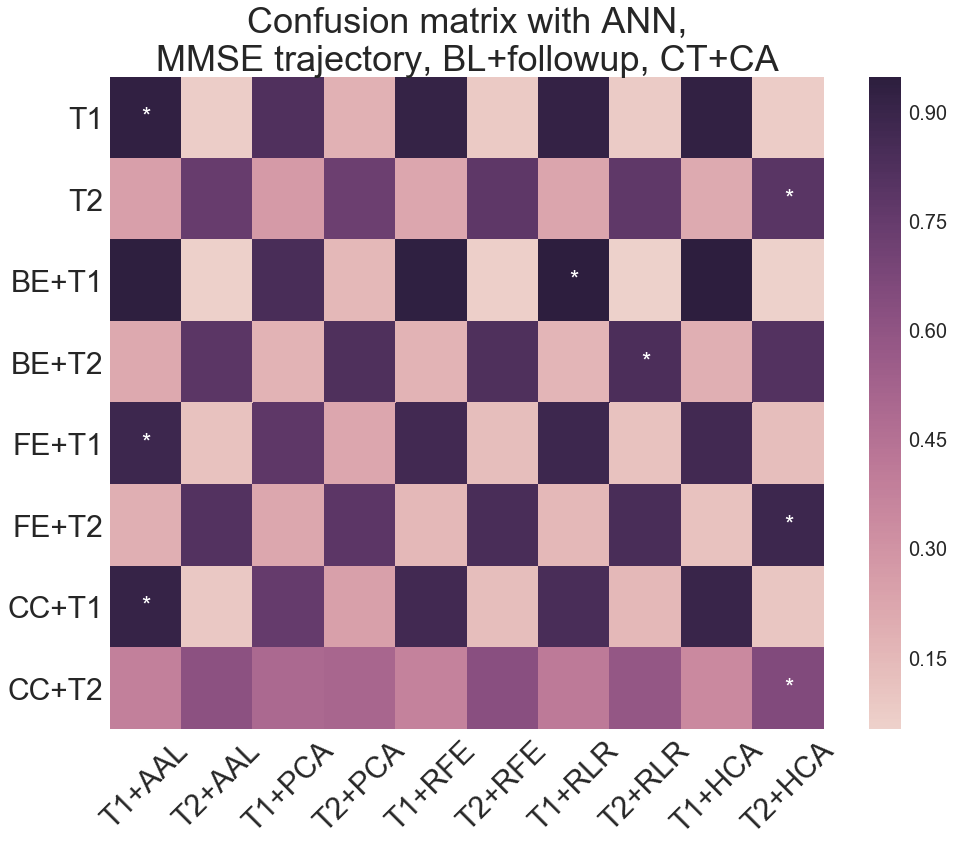

...

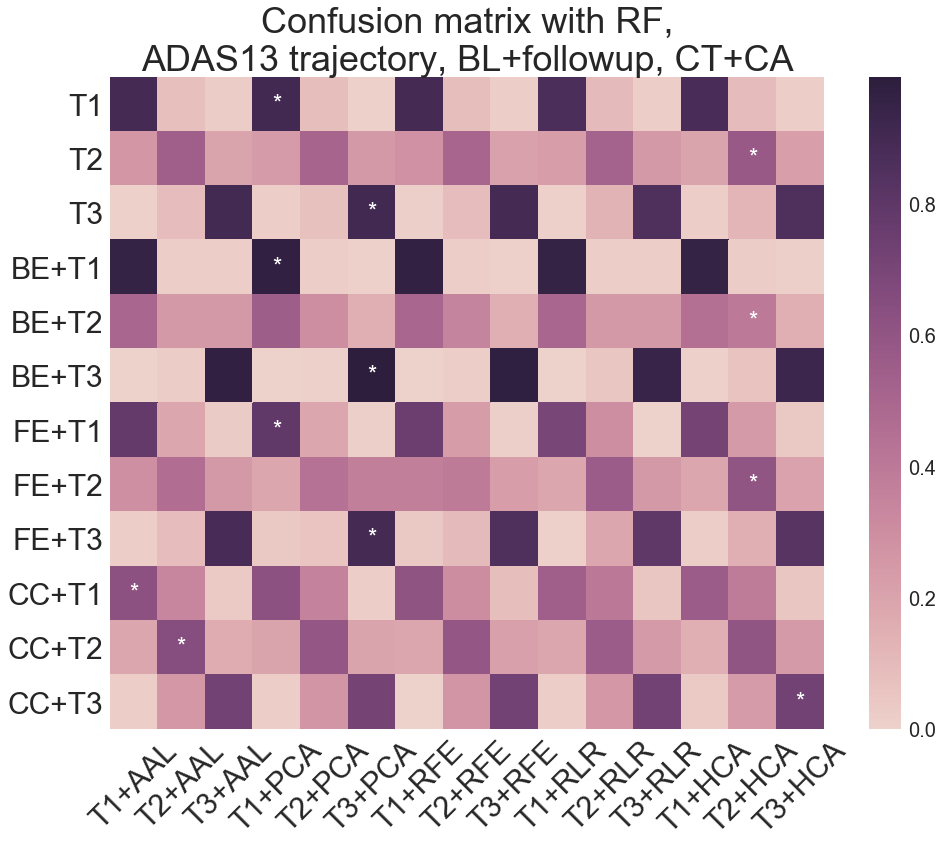

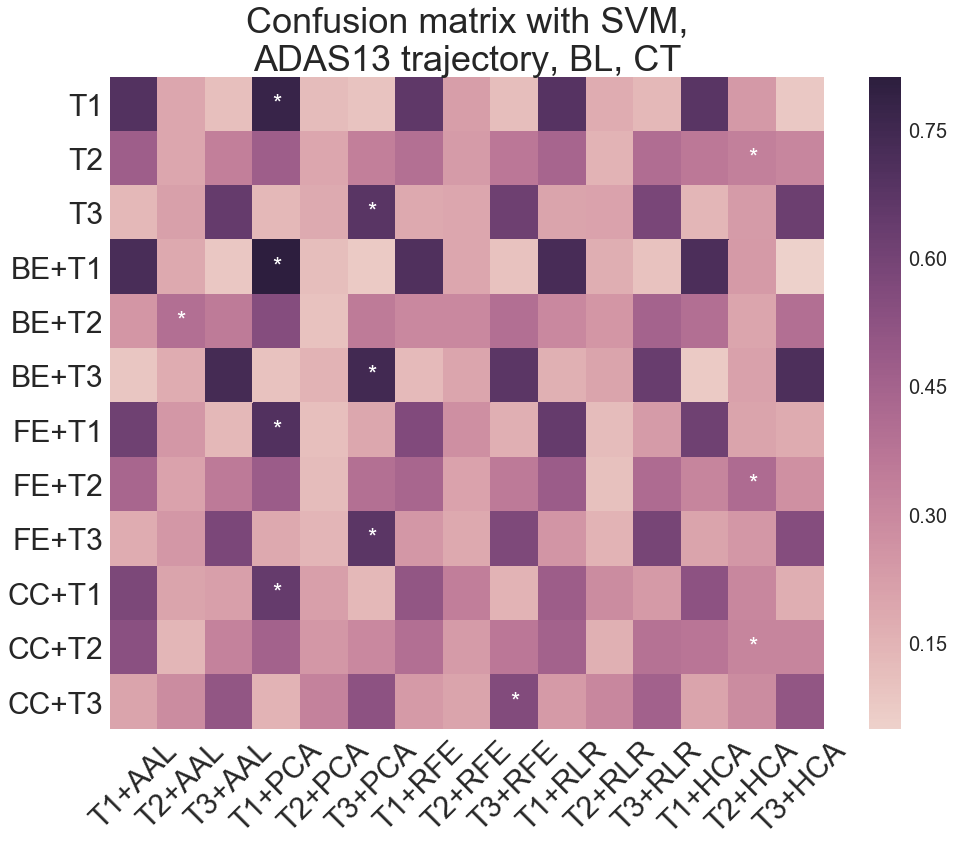

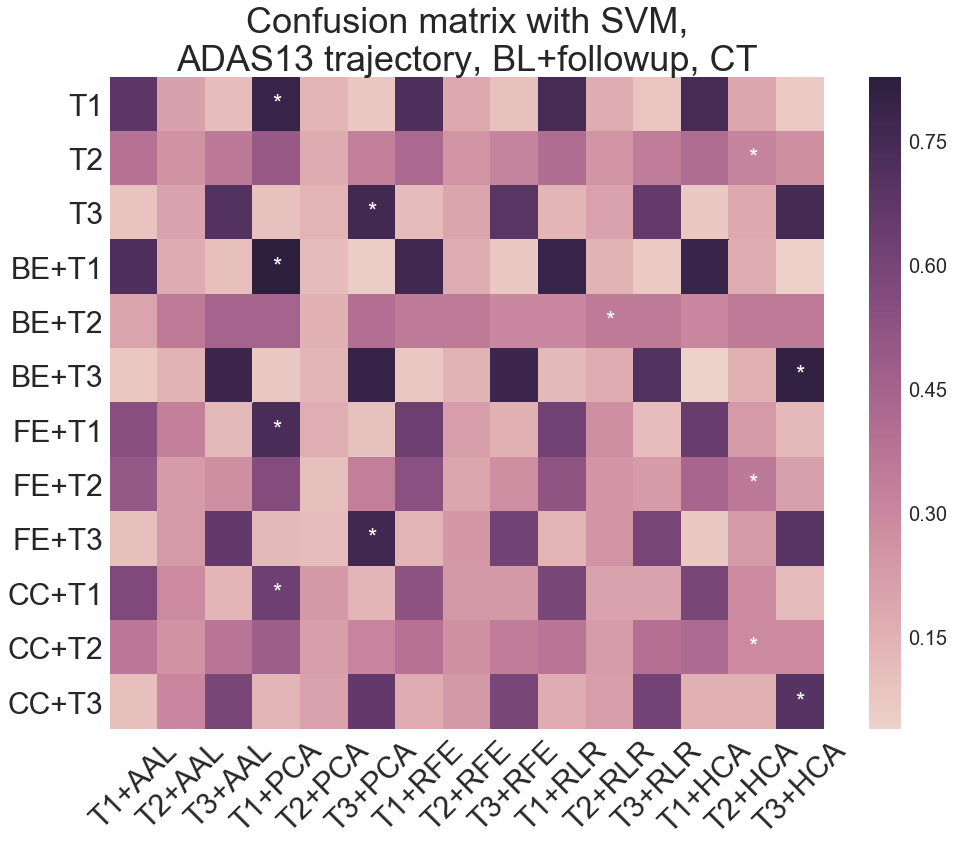

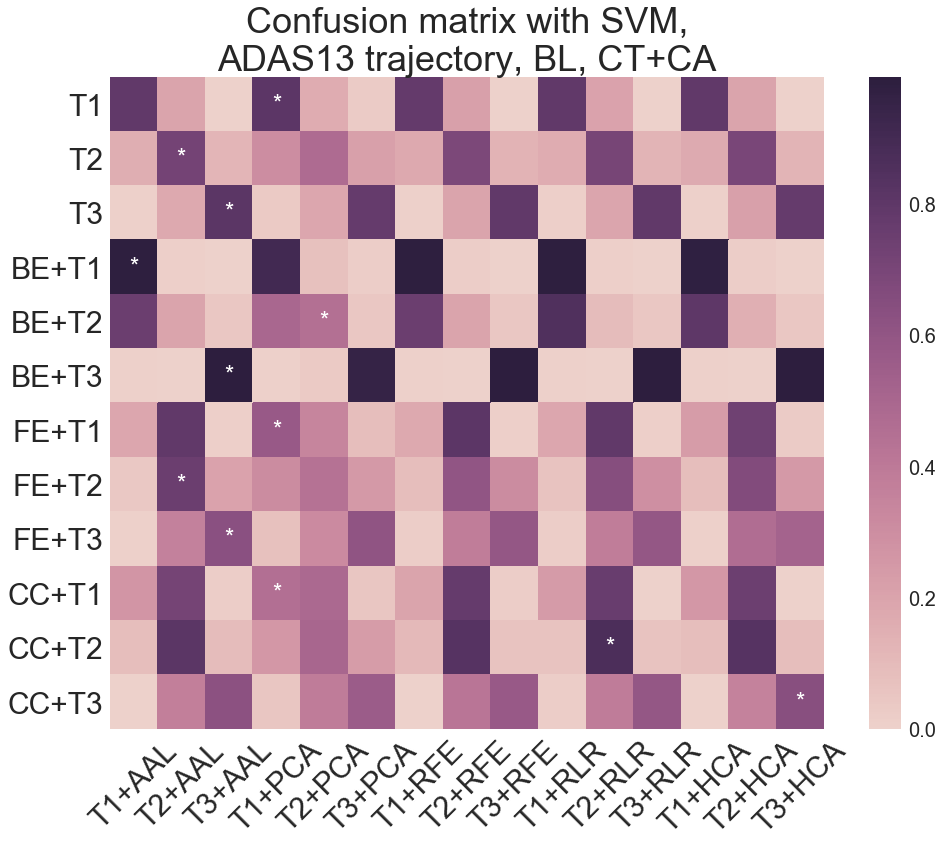

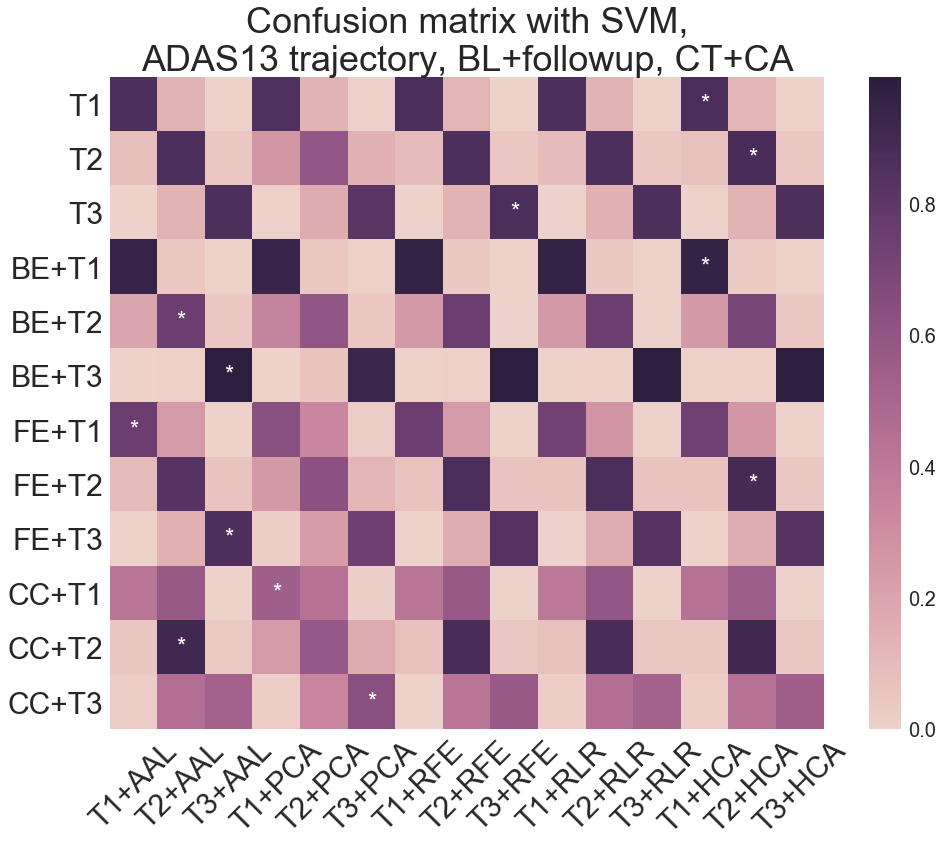

In [43]:
# Plot the confusion heatmaps (subgroup x feature type)
sns.set(font_scale=2)
for t in ['MMSE', 'ADAS13']:
    for m in ['LSN', 'ANN', 'LR', 'RF', 'SVM']:
        for ix, condition in enumerate(["BL, CT", "BL+followup, CT", "BL, CT+CA","BL+followup, CT+CA"]):
            if m == "LSN" and condition != "BL+followup, CT+CA":
                pass
            
            else:
                cmatrix = {}
                
                if condition == "BL, CT":
                    suffix = "{}_78_NoClinical_NoFollowup_GridSearch_cmatrix.pkl".format(t)
                elif condition == "BL+followup, CT":
                    suffix = "{}_78_NoClinical_GridSearch_cmatrix.pkl".format(t)
                elif condition == "BL, CT+CA":
                    suffix = "{}_78_NoFollowup_GridSearch_cmatrix.pkl".format(t)
                elif condition == "BL+followup, CT+CA":
                    suffix = "{}_78_GridSearch_cmatrix.pkl".format(t)

                for ftype in ["AAL", "HCA", "PCA", "RFE", "RLR"]:
                    with open("results/Exp_Mar18_grid_search/{}_{}_{}".format(m, ftype, suffix), "rb") as f:
                        cmatrix[ftype] = pkl.load(f)
                        
                if t == 'MMSE':
                    increment = 2
                elif t == 'ADAS13':
                    increment = 3
                    
                cmatrix_combined = np.zeros((4*increment, 5*increment))
                
                for i, ftype in enumerate(['AAL', 'PCA', 'RFE', 'RLR', 'HCA']):
                    for j, sg in enumerate(['all', 'BE', 'FE', 'CC']):
                        sub_arr = np.array(cmatrix[ftype][sg])
                        sub_arr = np.average(sub_arr, axis=0)
                        sub_arr = (sub_arr.T / np.sum(sub_arr, axis=1)).T
                        cmatrix_combined[j*increment:(j+1)*increment, i*increment:(i+1)*increment] = sub_arr
                
                if t == 'MMSE':
                    index = ['T1', 'T2', 'BE+T1', 'BE+T2', 'FE+T1', 'FE+T2', 'CC+T1', 'CC+T2']
                    columns = ['T1+AAL', 'T2+AAL', 'T1+PCA', 'T2+PCA', 'T1+RFE', 'T2+RFE', 
                               'T1+RLR', 'T2+RLR', 'T1+HCA', 'T2+HCA']
                elif t == 'ADAS13':
                    index = ['T1', 'T2', 'T3', 'BE+T1', 'BE+T2', 'BE+T3', 
                             'FE+T1', 'FE+T2', 'FE+T3', 'CC+T1', 'CC+T2', 'CC+T3']
                    columns = ['T1+AAL', 'T2+AAL', 'T3+AAL', 'T1+PCA', 'T2+PCA', 'T3+PCA', 'T1+RFE', 'T2+RFE', 
                               'T3+RFE', 'T1+RLR', 'T2+RLR', 'T3+RLR', 'T1+HCA', 'T2+HCA', 'T3+HCA']
                df = pd.DataFrame(cmatrix_combined, index=index, columns=columns)
                
                annotation = np.zeros((4*increment, 5*increment), dtype=np.str)
                for j in range(4*increment):
                    true_pos = cmatrix_combined[j, [i for i in range(5*increment) if i%increment == j%increment]]
                    best_ind = increment*np.argmax(true_pos) + j%increment
                    annotation[j, best_ind] = '*'
                
                plt.figure(figsize=(16,12))
                sns.heatmap(pd.DataFrame(df), annot=annotation, fmt='', cmap=sns.cubehelix_palette(as_cmap=True))
                plt.title("Confusion matrix with {},\n{} trajectory, {}".format(m, t, condition), fontsize=36)
                plt.yticks(rotation=0, fontsize=30); plt.xticks(rotation=45, fontsize=30);
                plt.savefig("plots/Exp_Mar18_grid_search/{}_{}_{}_cmatrix.png".format(m, t, ix))

In [44]:
# Read the replication study data
df = pd.read_csv("results/Exp_Mar18_grid_search/replication_performance.csv")
choices = ["BL, CT", "BL+followup, CT", "BL, CT+CA","BL+followup, CT+CA"]
sns.set(font_scale=2)

# Reformat the obtained results
new_df = pd.DataFrame()
for index, row in df.iterrows():
    if row["Method"] != "LSN" and not row["NoThickness"]:
        if row["NoClinical"] and row["NoFollowup"]:
            condition = "BL, CT"
        elif row["NoClinical"]:
            condition = "BL+followup, CT"
        elif row["NoFollowup"]:
            condition = "BL, CT+CA"
        else:
            condition = "BL+followup, CT+CA"
        method = row["Method"]
        featuretype = row["FeatureType"]
        
        for i in range(10):
            accuracy = row["acc_{}".format(i)]
            balanced_accuracy = row["bacc_{}".format(i)]
            my_auc = row["auc_{}".format(i)]
            new_row = {"Method": method, "Input Type": condition,
                       "FeatureType": featuretype, "Accuracy": accuracy, 
                       "Balanced accuracy": balanced_accuracy, "AUC": my_auc}
            new_df = new_df.append(new_row, ignore_index=True)

# Append the results with the LSN method
for index, row in df.iterrows():
    if row["Method"] == "LSN":
        condition = "BL+followup, CT+CA"
        method = row["Method"]
        featuretype = row["FeatureType"]
        
        for i in range(10):
            accuracy = row["acc_{}".format(i)]
            balanced_accuracy = row["bacc_{}".format(i)]
            my_auc = row["auc_{}".format(i)]
            new_row = {"Method": method, "Input Type": condition,
                       "FeatureType": featuretype, "Accuracy": accuracy, 
                       "Balanced accuracy": balanced_accuracy, "AUC": my_auc}
            new_df = new_df.append(new_row, ignore_index=True)
            
# Append the results with clinical attributes only
for index, row in df.iterrows():
    if row["NoThickness"]:
        if row["NoFollowup"]:
            condition = "BL, CA"
        else:
            condition = "BL+followup, CA"
        method = row["Method"]
        featuretype = row["FeatureType"]
        
        for i in range(10):
            accuracy = row["acc_{}".format(i)]
            balanced_accuracy = row["bacc_{}".format(i)]
            my_auc = row["auc_{}".format(i)]
            new_row = {"Method": method, "Input Type": condition,
                       "FeatureType": featuretype, "Accuracy": accuracy, 
                       "Balanced accuracy": balanced_accuracy, "AUC": my_auc}
            new_df = new_df.append(new_row, ignore_index=True)

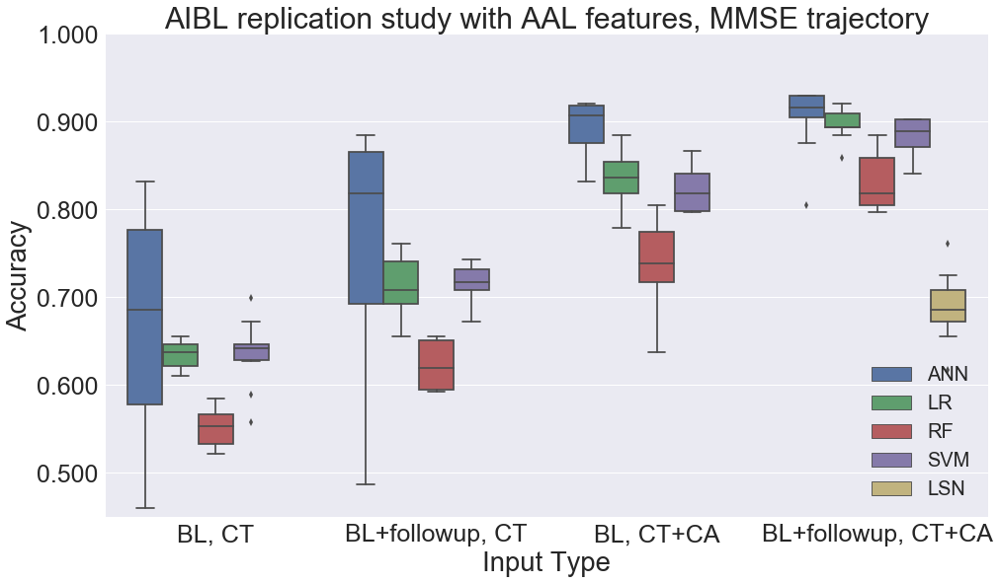

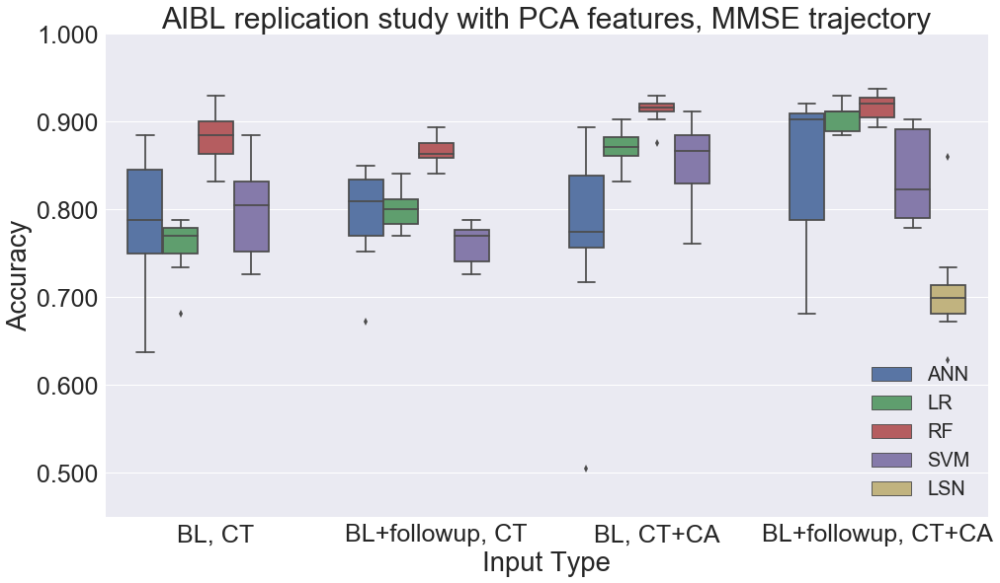

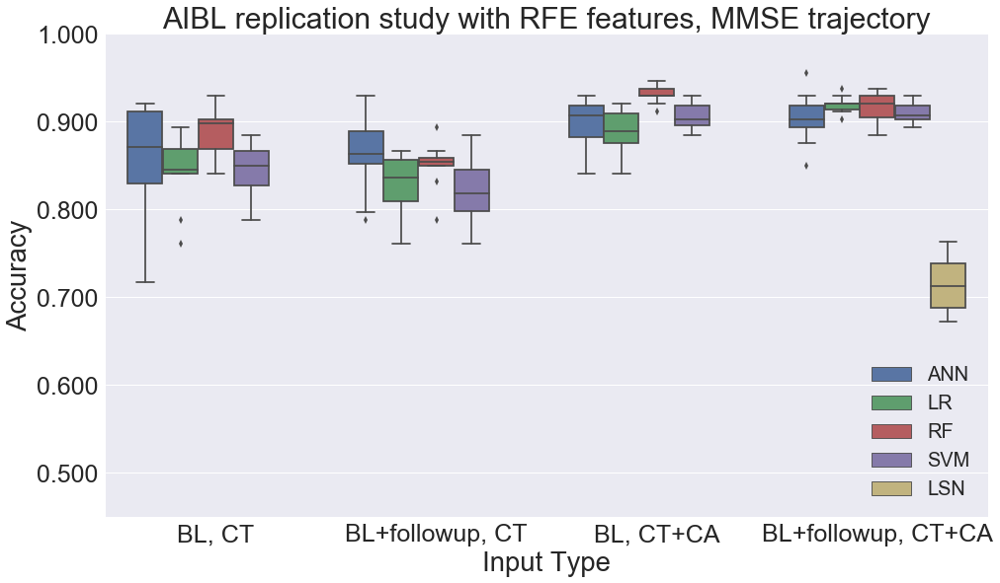

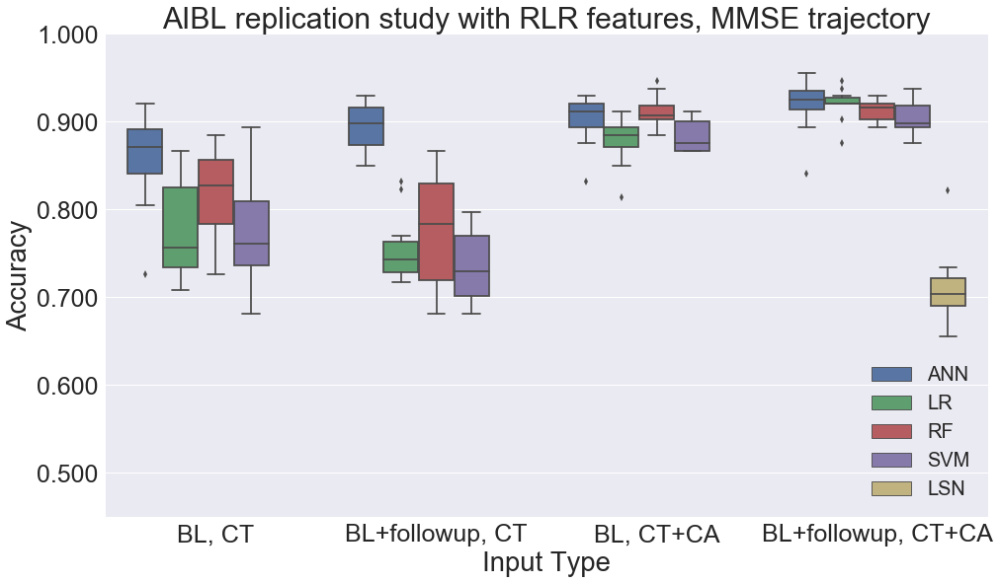

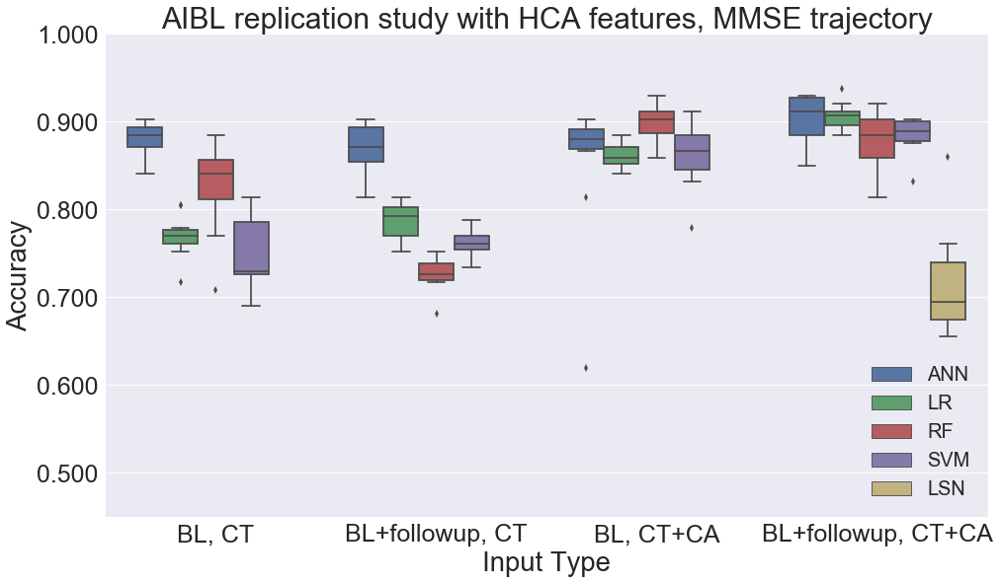

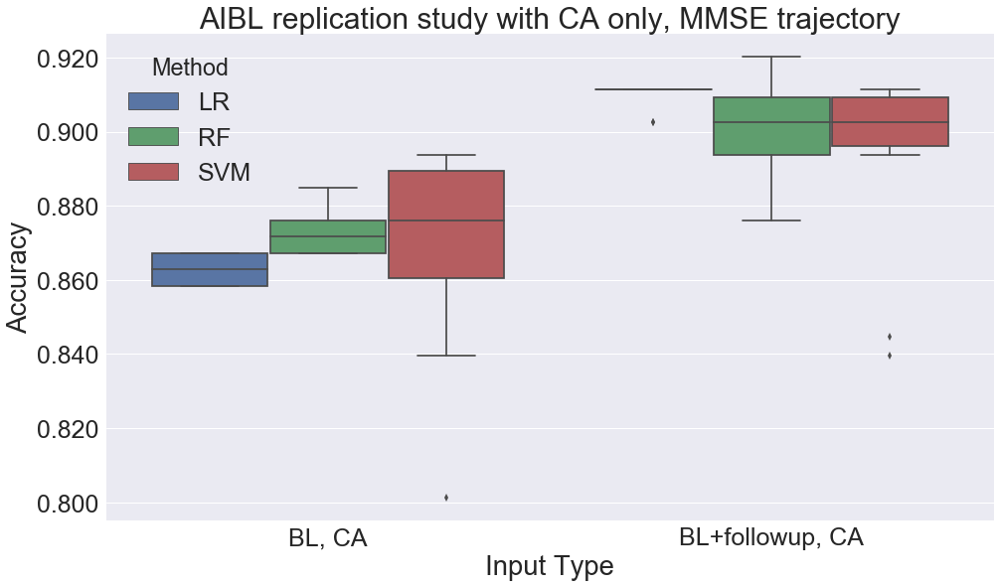

In [51]:
# Look through the experimental conditions (accuracy)
sns.set(font_scale=2.5)
for f in ["AAL", "PCA", "RFE", "RLR", "HCA"]:
    plt.figure(figsize=(16,9))
    cur_df = new_df.loc[new_df["FeatureType"] == f]
    ax = sns.boxplot(x="Input Type", y="Accuracy", hue="Method", data=cur_df, order=choices)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    plt.ylim(0.450, 1.000)
    plt.legend(loc='lower right', fontsize=20)
    plt.title("AIBL replication study with {} features, MMSE trajectory".format(f))
    plt.savefig("plots/Exp_Mar18_grid_search/AIBL_{}_acc_boxplot.png".format(f))
    
# Plot the accuracy with clinical attributes only
plt.figure(figsize=(16,9))
cur_df = new_df.loc[new_df["FeatureType"] == "None"]
ax = sns.boxplot(x="Input Type", y="Accuracy", hue="Method", data=cur_df, 
                 order=["BL, CA", "BL+followup, CA"])
ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
plt.title("AIBL replication study with CA only, MMSE trajectory")
plt.savefig("plots/Exp_Mar18_grid_search/AIBL_CA-only_acc_boxplot.png")

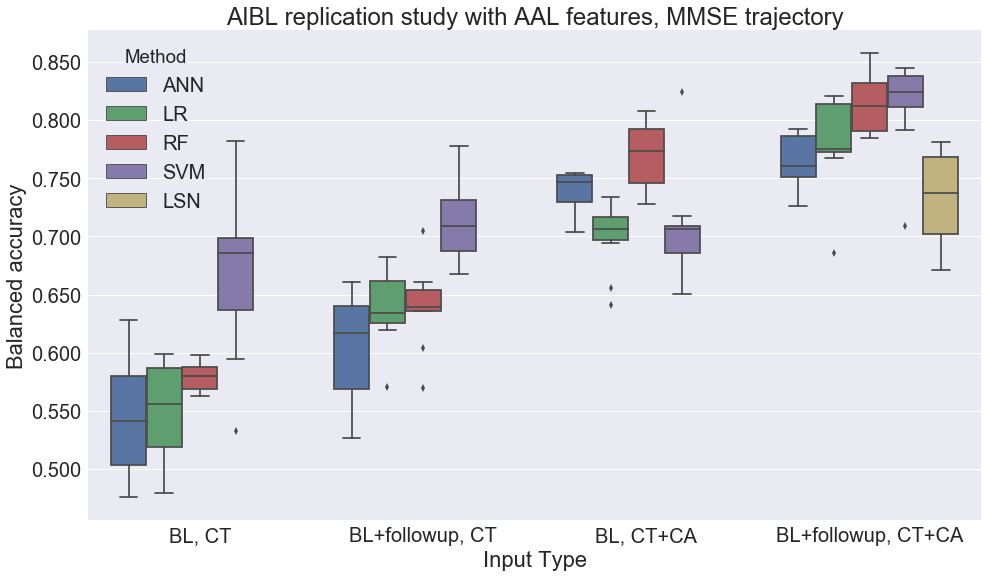

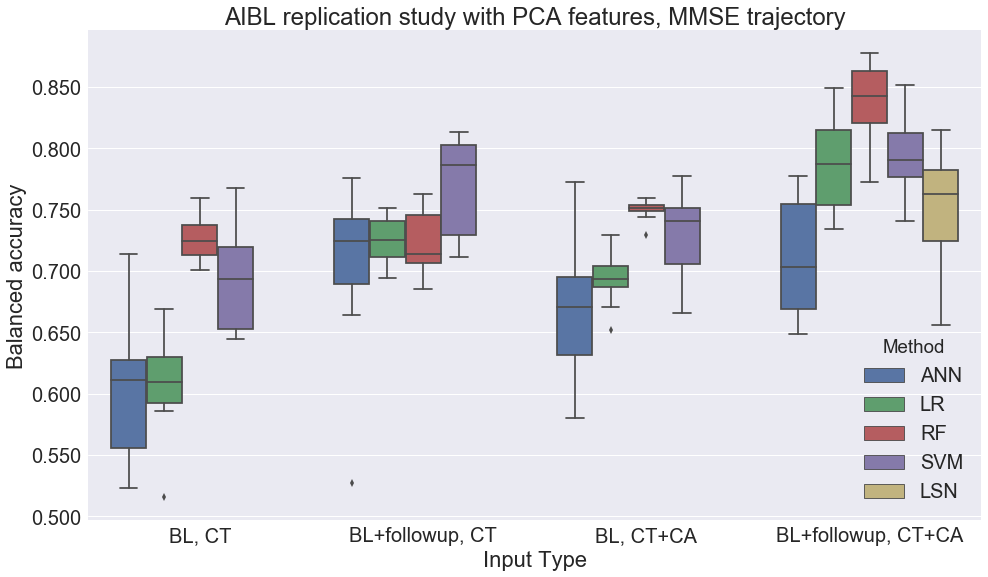

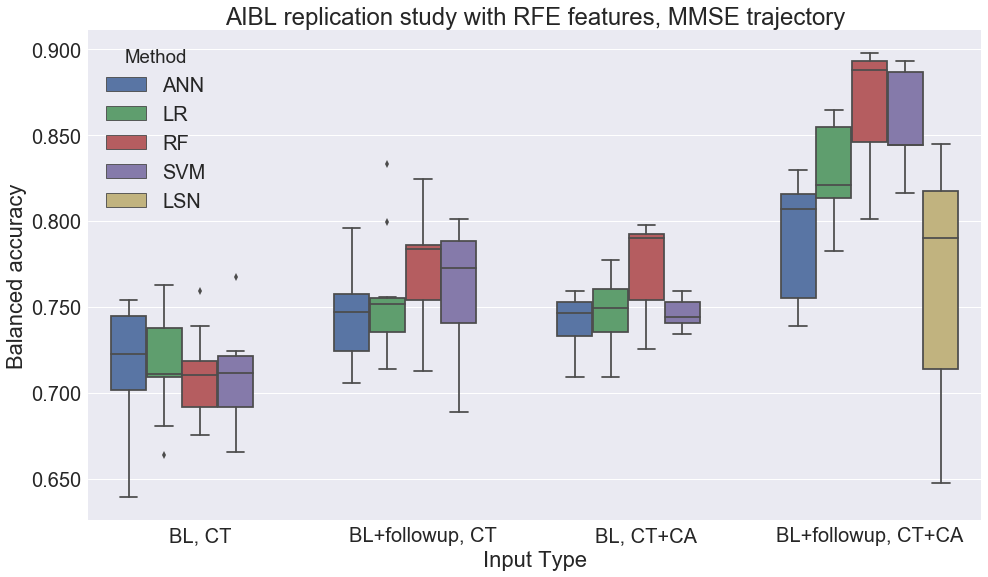

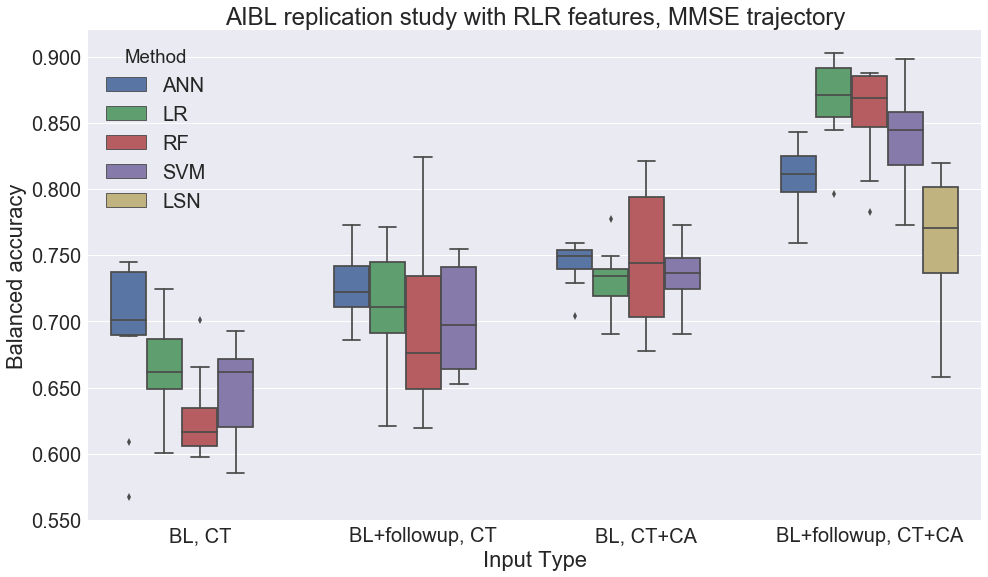

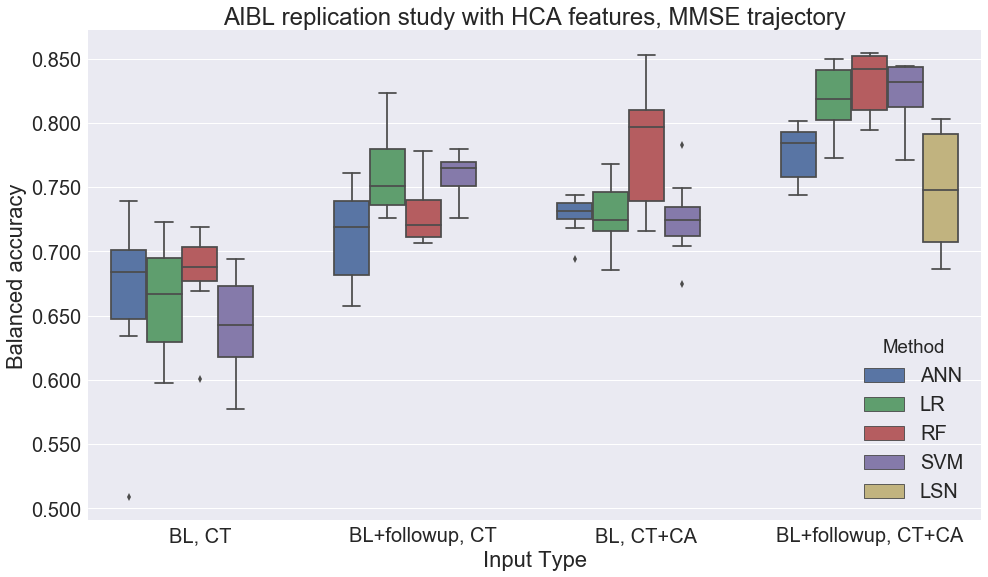

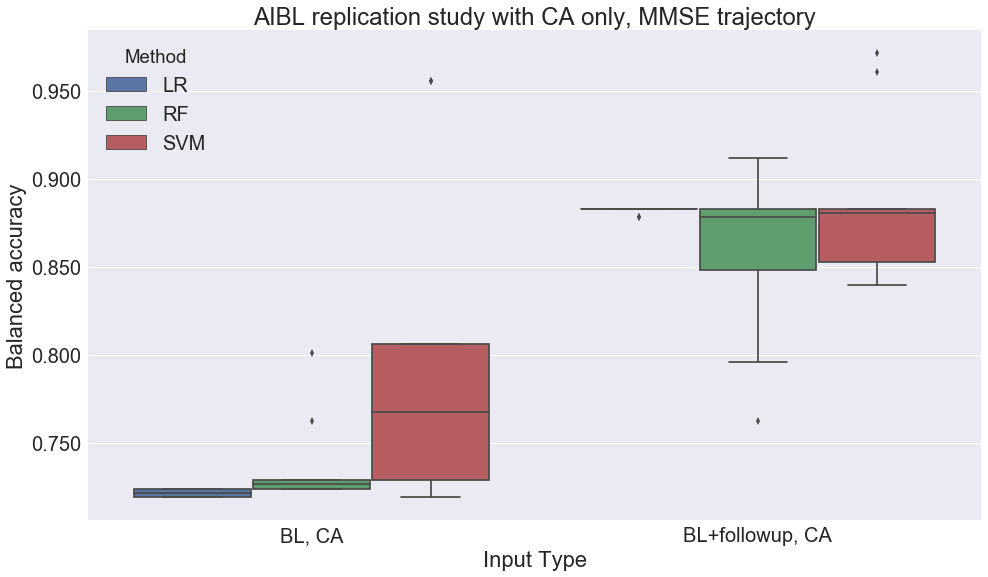

In [36]:
# Look through the experimental conditions (balanced accuracy)
for f in ["AAL", "PCA", "RFE", "RLR", "HCA"]:
    plt.figure(figsize=(16,9))
    cur_df = new_df.loc[new_df["FeatureType"] == f]
    ax = sns.boxplot(x="Input Type", y="Balanced accuracy", hue="Method", data=cur_df, order=choices)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    plt.title("AIBL replication study with {} features, MMSE trajectory".format(f))
    plt.savefig("plots/Exp_Mar18_grid_search/AIBL_{}_bacc_boxplot.png".format(f))
    
# Plot the accuracy with clinical attributes only
plt.figure(figsize=(16,9))
cur_df = new_df.loc[new_df["FeatureType"] == "None"]
ax = sns.boxplot(x="Input Type", y="Balanced accuracy", hue="Method", data=cur_df, 
                 order=["BL, CA", "BL+followup, CA"])
ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
plt.title("AIBL replication study with CA only, MMSE trajectory")
plt.savefig("plots/Exp_Mar18_grid_search/AIBL_CA-only_bacc_boxplot.png")

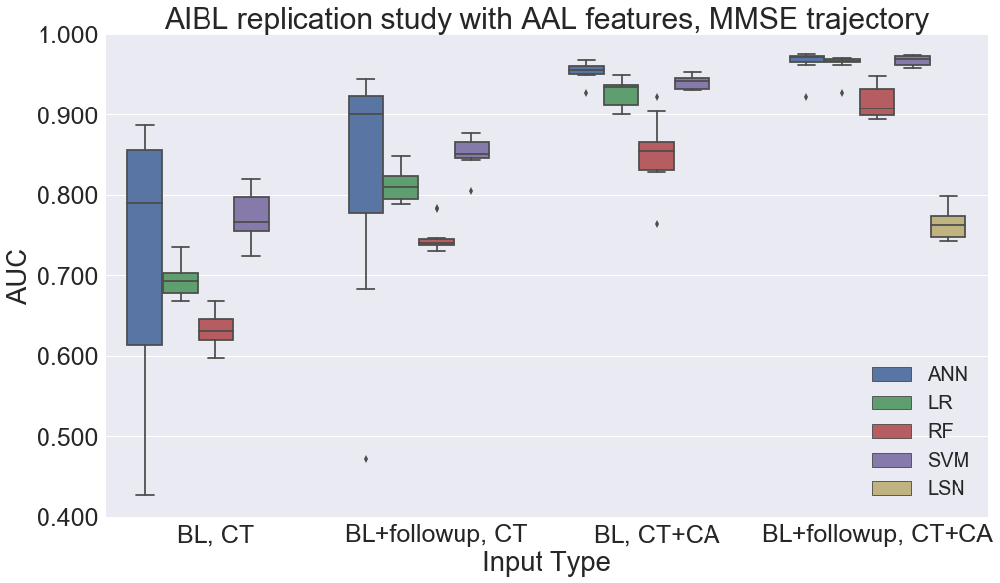

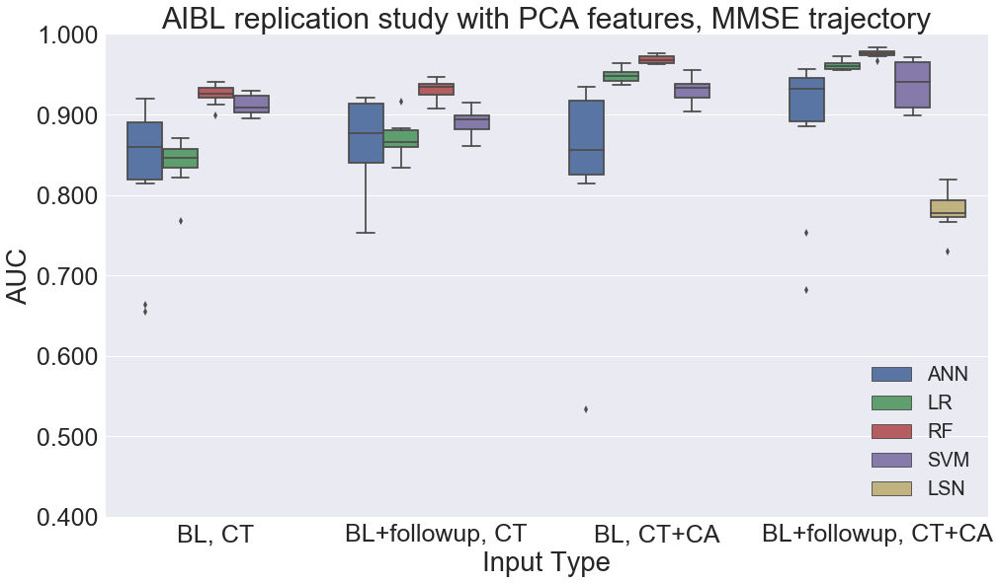

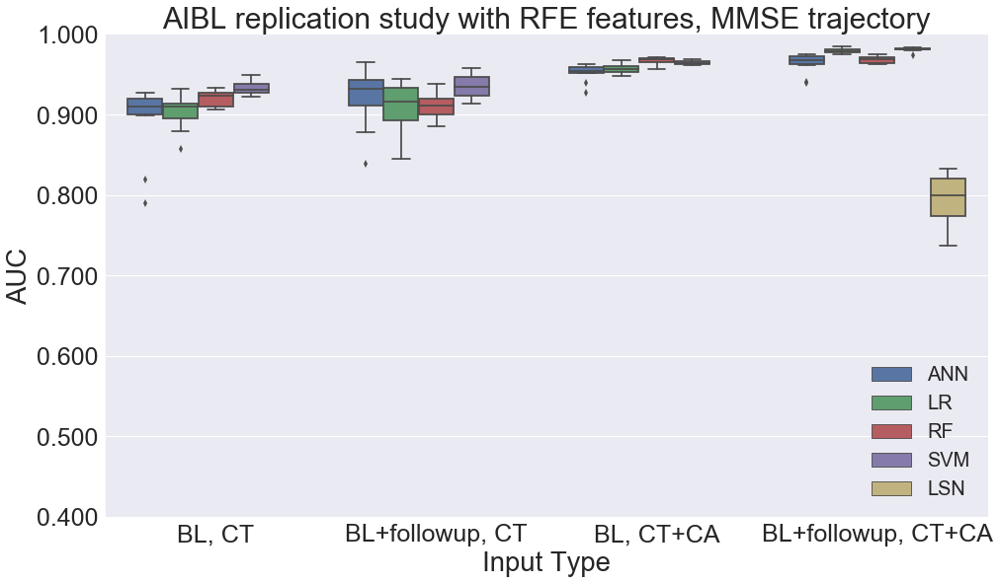

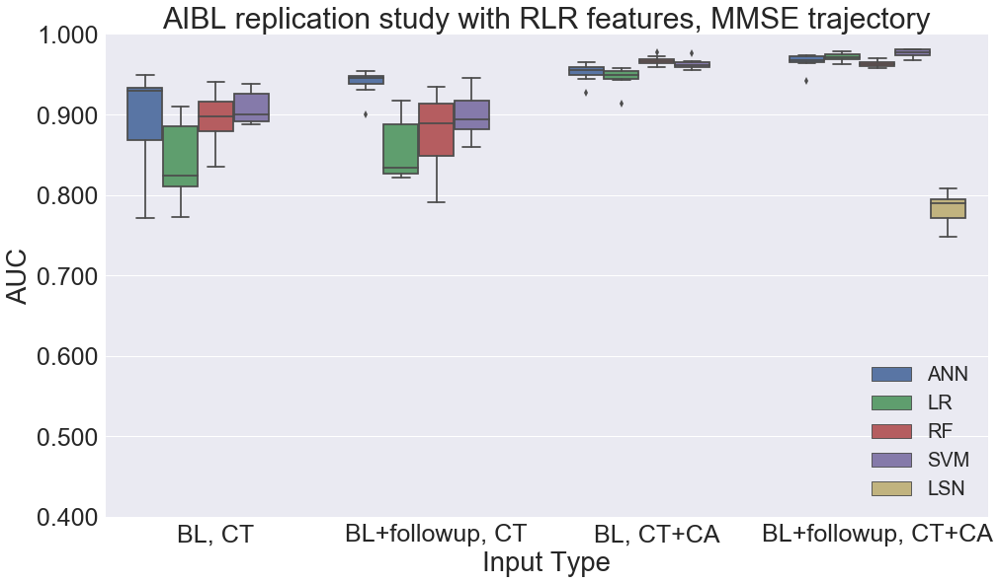

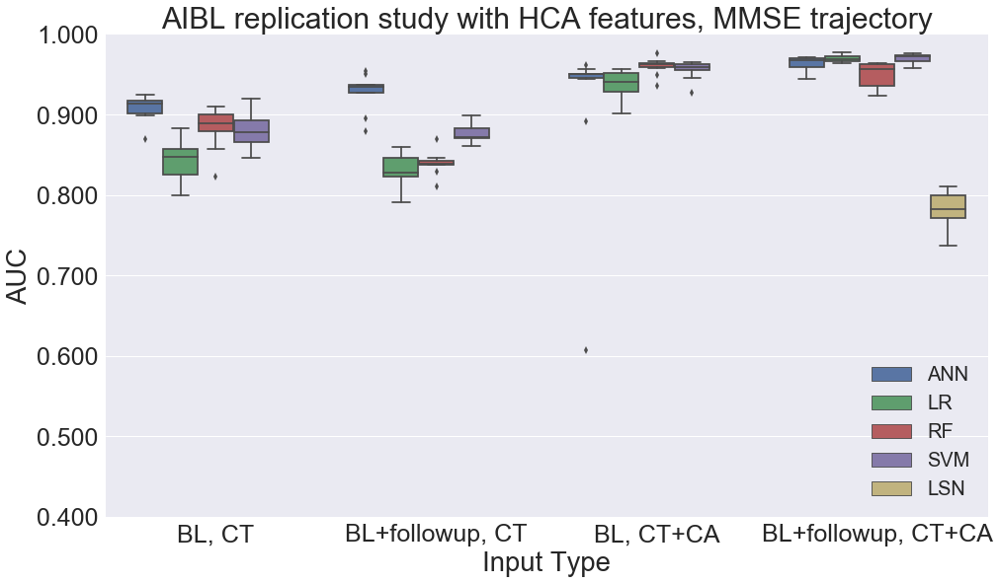

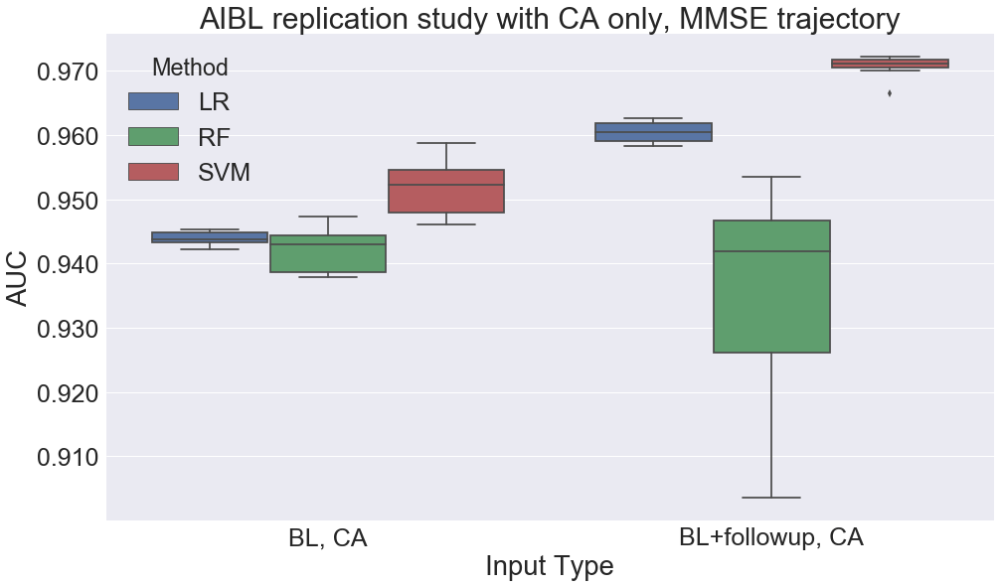

In [52]:
# Look through the experimental conditions (AUC)
sns.set(font_scale=2.5)
for f in ["AAL", "PCA", "RFE", "RLR", "HCA"]:
    plt.figure(figsize=(16,9))
    cur_df = new_df.loc[new_df["FeatureType"] == f]
    ax = sns.boxplot(x="Input Type", y="AUC", hue="Method", data=cur_df, order=choices)
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
    plt.ylim(0.400, 1.000)
    plt.legend(loc='lower right', fontsize=20)
    plt.title("AIBL replication study with {} features, MMSE trajectory".format(f))
    plt.savefig("plots/Exp_Mar18_grid_search/AIBL_{}_auc_boxplot.png".format(f))
    
# Plot the AUC with clinical attributes only
plt.figure(figsize=(16,9))
cur_df = new_df.loc[new_df["FeatureType"] == "None"]
ax = sns.boxplot(x="Input Type", y="AUC", hue="Method", data=cur_df, 
                 order=["BL, CA", "BL+followup, CA"])
ax.yaxis.set_major_formatter(FormatStrFormatter('%.3f'))
plt.title("AIBL replication study with CA only, MMSE trajectory")
plt.savefig("plots/Exp_Mar18_grid_search/AIBL_CA-only_auc_boxplot.png")

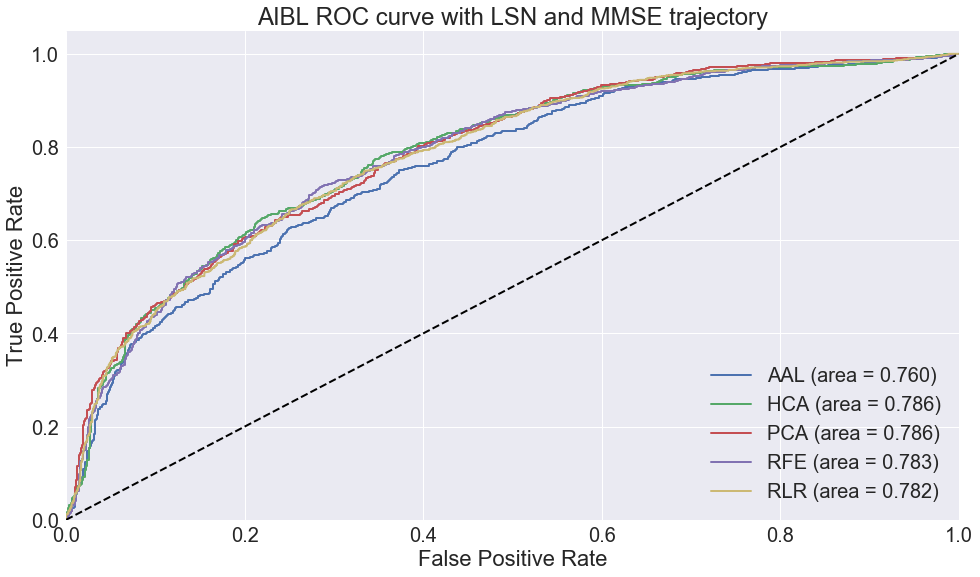

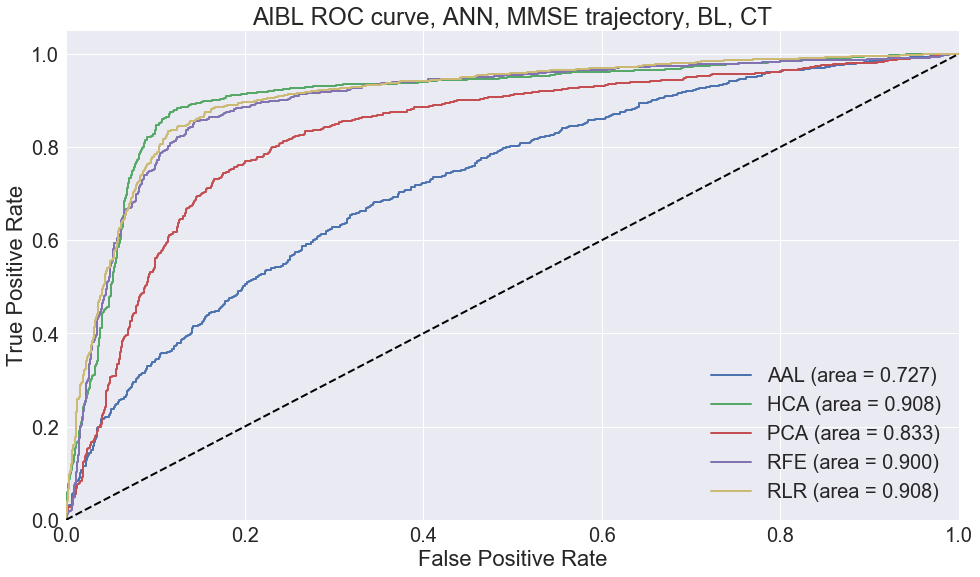

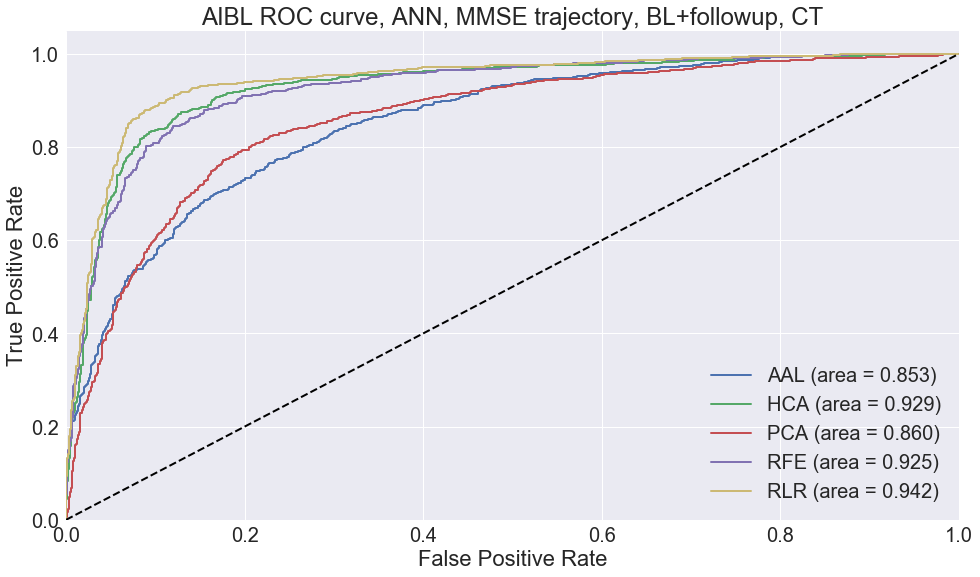

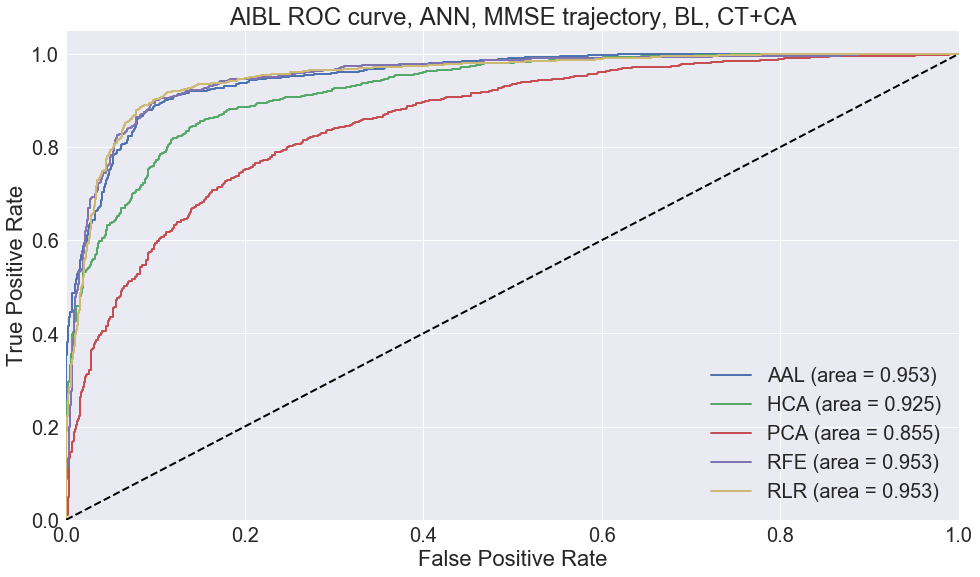

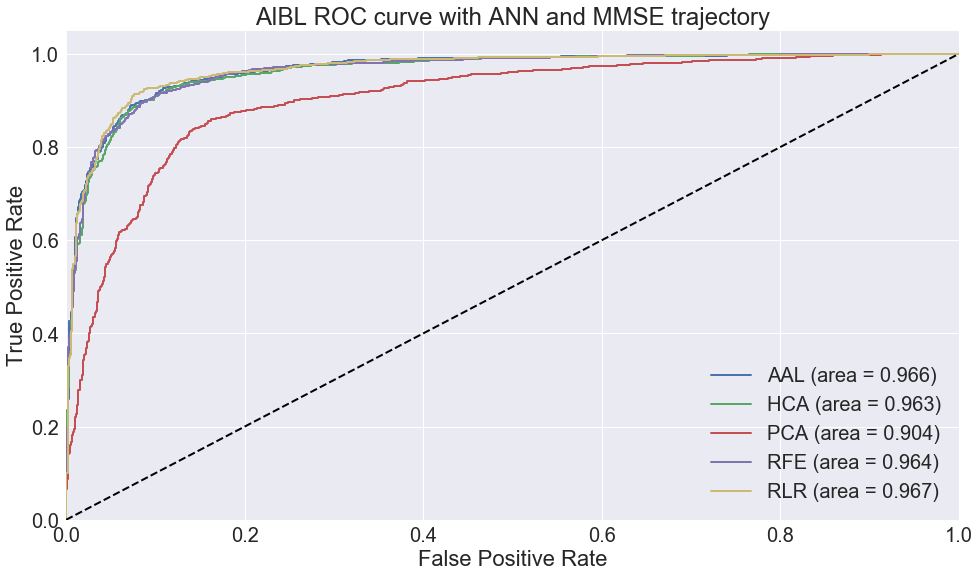

...

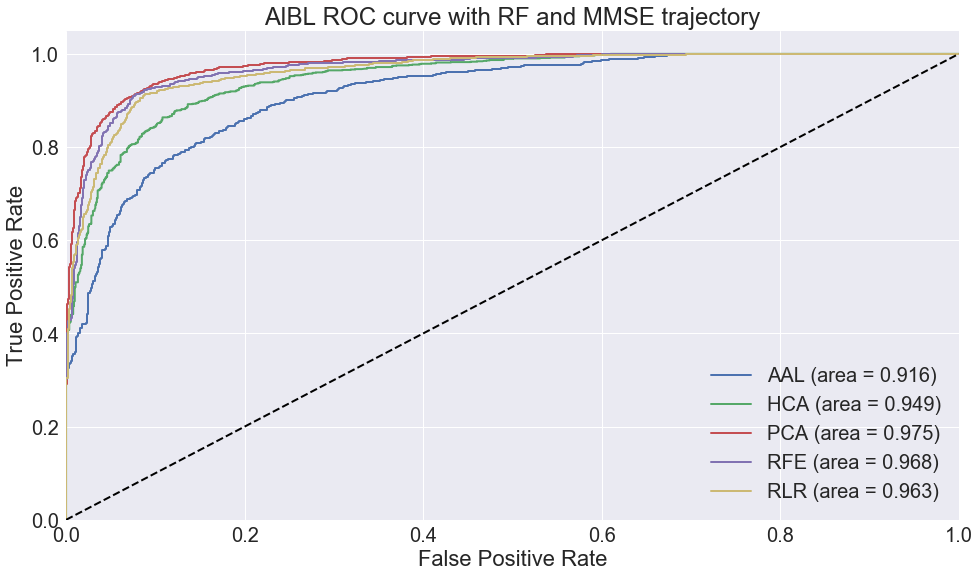

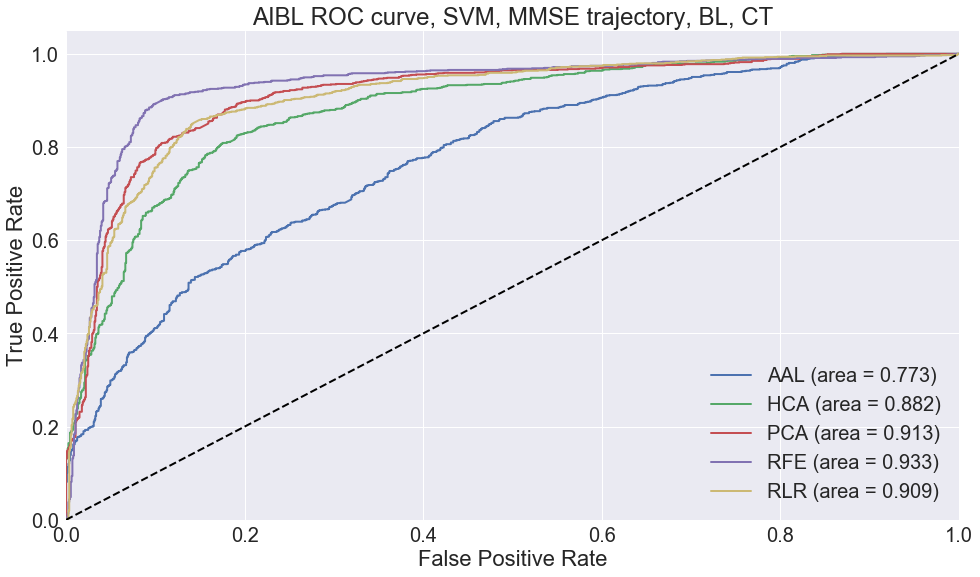

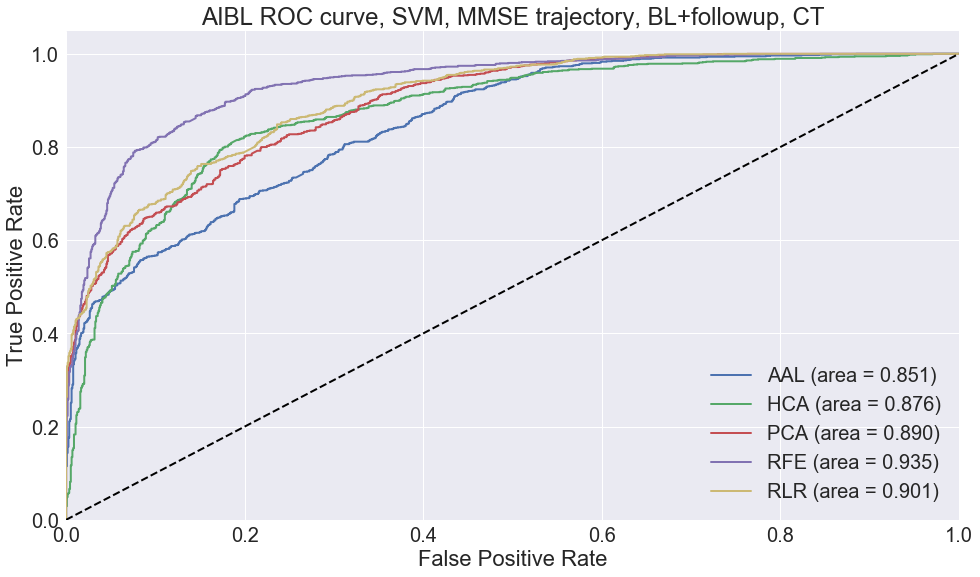

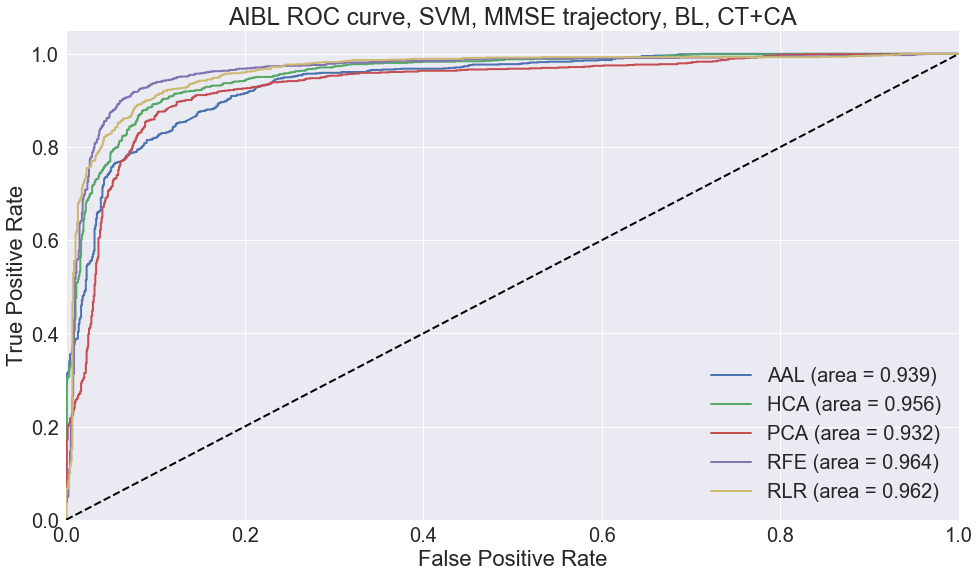

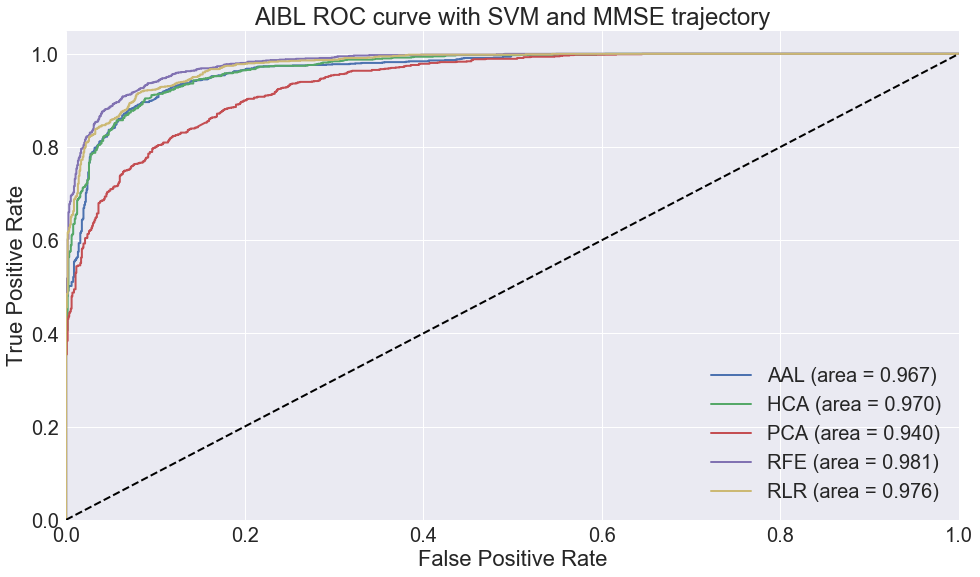

In [39]:
# Plot the Receiver Operator Characteristic curves

for m in ["LSN", "ANN", "LR", "RF", "SVM"]:
    for ix, condition in enumerate(["BL, CT", "BL+followup, CT", "BL, CT+CA","BL+followup, CT+CA"]):
        if m == "LSN" and condition != "BL+followup, CT+CA":
            pass

        else:
            roc_stats = {}

            if condition == "BL, CT":
                suffix = "MMSE_78_NoClinical_NoFollowup_GridSearch_aibl_roc_stats.pkl"
            elif condition == "BL+followup, CT":
                suffix = "MMSE_78_NoClinical_GridSearch_aibl_roc_stats.pkl"
            elif condition == "BL, CT+CA":
                suffix = "MMSE_78_NoFollowup_GridSearch_aibl_roc_stats.pkl"
            elif condition == "BL+followup, CT+CA":
                suffix = "MMSE_78_GridSearch_aibl_roc_stats.pkl"

            for ftype in ["AAL", "HCA", "PCA", "RFE", "RLR"]:
                with open("results/Exp_Mar18_grid_search/{}_{}_{}".format(m, ftype, suffix), "rb") as f:
                    roc_stats[ftype] = pkl.load(f)

            plt.figure(figsize=(16,9))
            for ftype in ["AAL", "HCA", "PCA", "RFE", "RLR"]:
                plt.plot(roc_stats[ftype]['fpr'], roc_stats[ftype]['tpr'],
                        lw=2, label="{} (area = {:0.3f})".format(ftype, 
                        auc(roc_stats[ftype]['fpr'], roc_stats[ftype]['tpr'])))

            plt.plot([0, 1], [0, 1], 'k--', lw=2)
            plt.xlim([0.0, 1.0])
            plt.ylim([0.0, 1.05])
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            if condition != 'BL+followup, CT+CA':
                plt.title('AIBL ROC curve, {}, MMSE trajectory, {}'.format(m, condition))
            else:
                plt.title('AIBL ROC curve with {} and MMSE trajectory'.format(m))
            plt.legend(loc="lower right")
            plt.savefig("plots/Exp_Mar18_grid_search/AIBL_{}_{}_ROC_curve.png".format(m, ix))

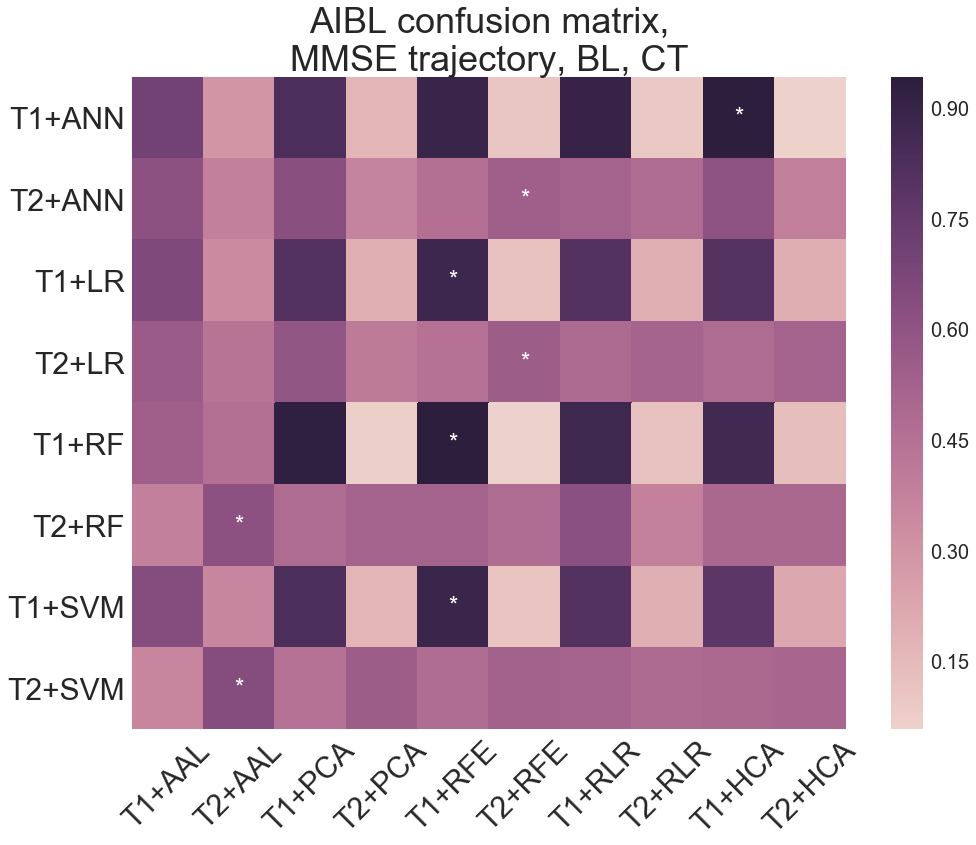

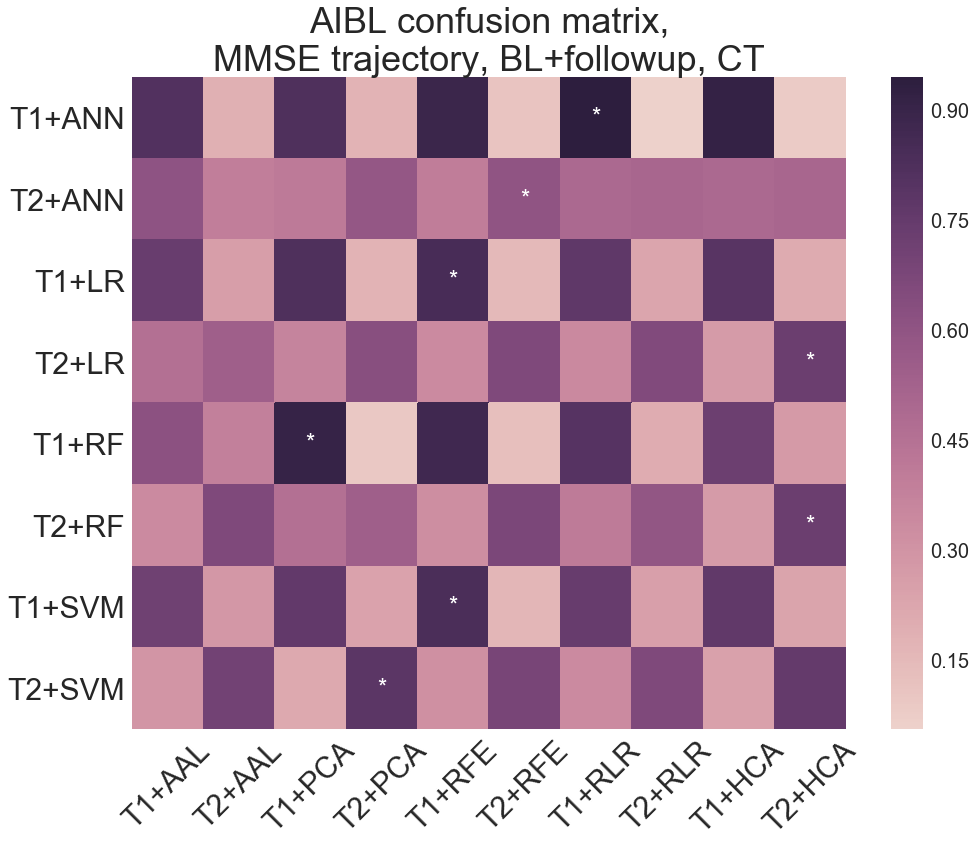

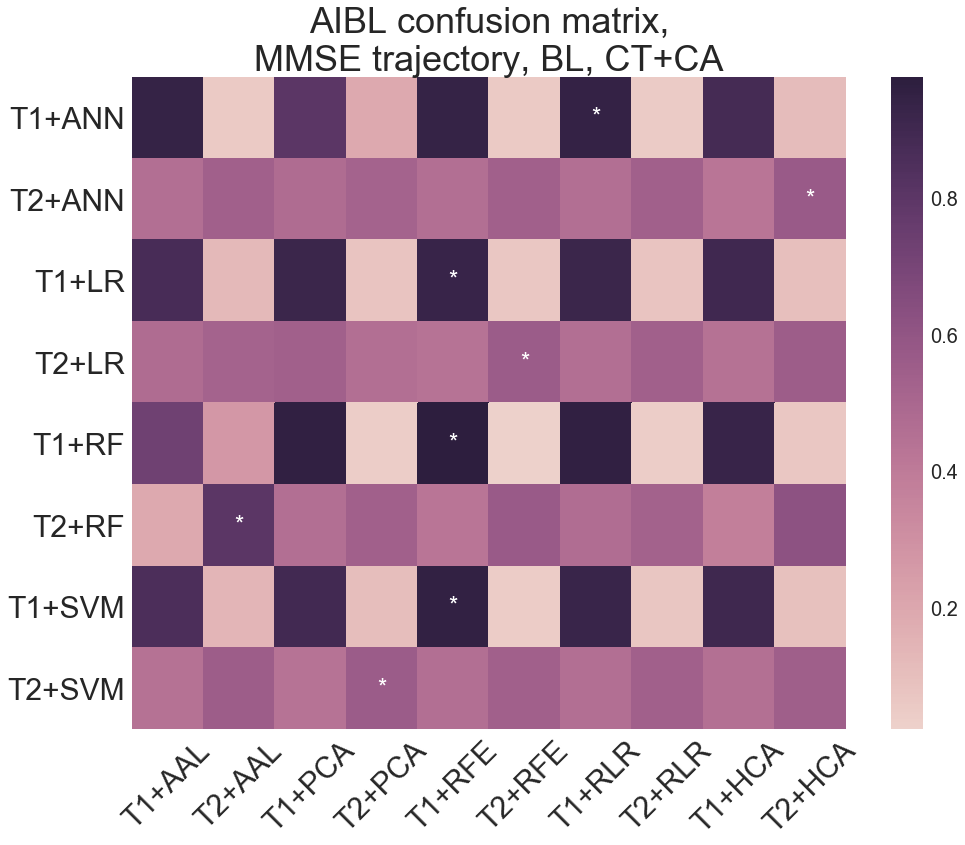

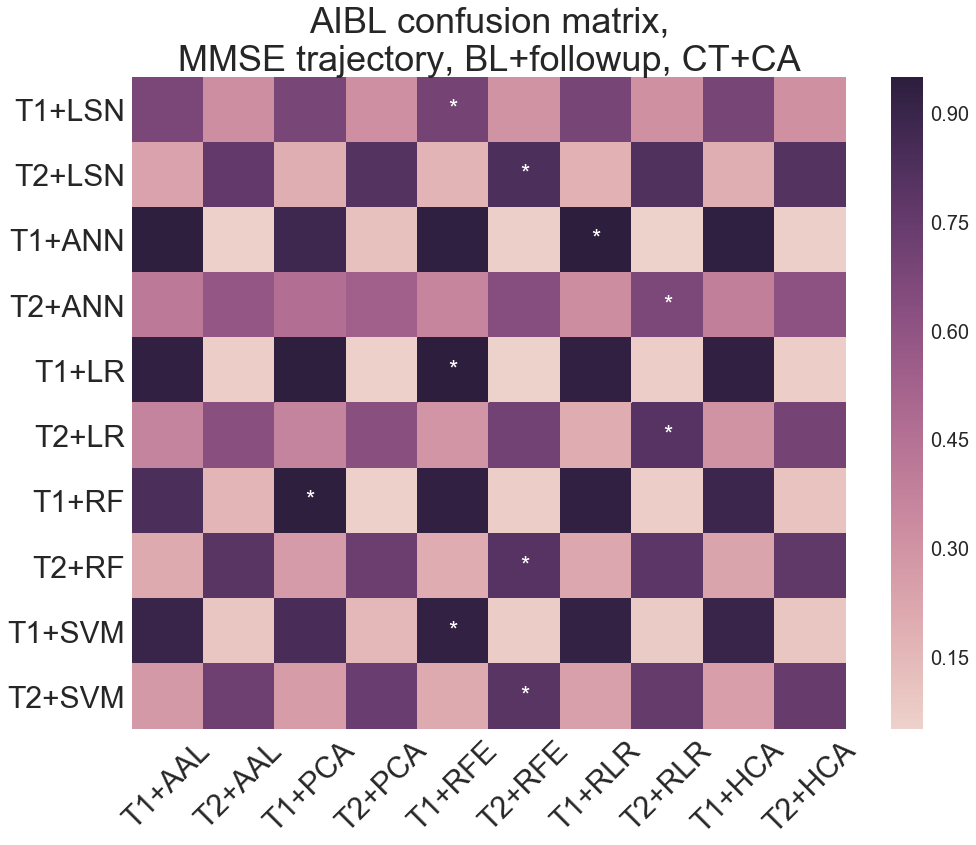

In [50]:
# Plot the confusion heatmaps (subgroup x feature type)

for ix, condition in enumerate(["BL, CT", "BL+followup, CT", "BL, CT+CA","BL+followup, CT+CA"]):

    if condition == "BL+followup, CT+CA":
        methods = ['LSN', 'ANN', 'LR', 'RF', 'SVM']
    else:
        methods = ['ANN', 'LR', 'RF', 'SVM']

    cmatrix = {'AAL': {}, 'HCA': {}, 'PCA': {}, 'RFE': {}, 'RLR': {}}

    if condition == "BL, CT":
        suffix = "MMSE_78_NoClinical_NoFollowup_GridSearch_aibl_cmatrix.pkl"
    elif condition == "BL+followup, CT":
        suffix = "MMSE_78_NoClinical_GridSearch_aibl_cmatrix.pkl"
    elif condition == "BL, CT+CA":
        suffix = "MMSE_78_NoFollowup_GridSearch_aibl_cmatrix.pkl"
    elif condition == "BL+followup, CT+CA":
        suffix = "MMSE_78_GridSearch_aibl_cmatrix.pkl"

    for m in methods:
        for ftype in ["AAL", "HCA", "PCA", "RFE", "RLR"]:
            with open("results/Exp_Mar18_grid_search/{}_{}_{}".format(m, ftype, suffix), "rb") as f:
                cmatrix[ftype][m] = pkl.load(f)

    increment = 2    
    cmatrix_combined = np.zeros((len(methods)*increment, 5*increment))

    for i, ftype in enumerate(['AAL', 'PCA', 'RFE', 'RLR', 'HCA']):
        for j, m in enumerate(methods):
            sub_arr = np.array(cmatrix[ftype][m])
            sub_arr = np.average(sub_arr, axis=0)
            sub_arr = (sub_arr.T / np.sum(sub_arr, axis=1)).T
            cmatrix_combined[j*increment:(j+1)*increment, i*increment:(i+1)*increment] = sub_arr

    index = []
    for m in methods:
        index.append('T1+{}'.format(m))
        index.append('T2+{}'.format(m))
    columns = ['T1+AAL', 'T2+AAL', 'T1+PCA', 'T2+PCA', 'T1+RFE', 'T2+RFE', 
               'T1+RLR', 'T2+RLR', 'T1+HCA', 'T2+HCA']
    df = pd.DataFrame(cmatrix_combined, index=index, columns=columns)

    annotation = np.zeros((len(methods)*increment, 5*increment), dtype=np.str)
    for j in range(len(methods)*increment):
        true_pos = cmatrix_combined[j, [i for i in range(5*increment) if i%increment == j%increment]]
        best_ind = increment*np.argmax(true_pos) + j%increment
        annotation[j, best_ind] = '*'

    plt.figure(figsize=(16,12))
    sns.heatmap(pd.DataFrame(df), annot=annotation, fmt='', cmap=sns.cubehelix_palette(as_cmap=True))
    plt.title("AIBL confusion matrix,\nMMSE trajectory, {}".format(condition), fontsize=36)
    plt.yticks(rotation=0, fontsize=30); plt.xticks(rotation=45, fontsize=30);
    plt.savefig("plots/Exp_Mar18_grid_search/AIBL_{}_cmatrix.png".format(ix))